## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
country = 'DE'
buses = '20'
le = '1.5'

In [3]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_168h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_168h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [4]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [5]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [6]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [7]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [8]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [9]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 94.48it/s]
INFO:linopy.io: Writing time: 0.92s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tn2k_i47.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tn2k_i47.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59557 rows, 27795 columns, 114186 nonzeros


INFO:gurobipy:obj: 59557 rows, 27795 columns, 114186 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59557 rows, 27795 columns and 114186 nonzeros


INFO:gurobipy:Optimize a model with 59557 rows, 27795 columns and 114186 nonzeros


Model fingerprint: 0x3297338d


INFO:gurobipy:Model fingerprint: 0x3297338d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38159 rows and 7171 columns


INFO:gurobipy:Presolve removed 38159 rows and 7171 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 21398 rows, 20624 columns, 69811 nonzeros


INFO:gurobipy:Presolved: 21398 rows, 20624 columns, 69811 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.878e+05


INFO:gurobipy: AA' NZ     : 1.878e+05


 Factor NZ  : 9.045e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 9.045e+05 (roughly 24 MB of memory)


 Factor Ops : 1.620e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.620e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.48566401e+12 -1.39879001e+14  5.78e+06 2.57e+05  5.44e+10     0s


INFO:gurobipy:   0   8.48566401e+12 -1.39879001e+14  5.78e+06 2.57e+05  5.44e+10     0s


   1   8.09719501e+12 -1.15571491e+14  3.06e+06 1.85e+05  4.47e+10     0s


INFO:gurobipy:   1   8.09719501e+12 -1.15571491e+14  3.06e+06 1.85e+05  4.47e+10     0s


   2   5.16273028e+12 -6.44913974e+13  1.39e+06 3.78e+04  1.67e+10     1s


INFO:gurobipy:   2   5.16273028e+12 -6.44913974e+13  1.39e+06 3.78e+04  1.67e+10     1s


   3   3.76840784e+12 -3.52162012e+13  3.69e+05 4.78e+03  4.19e+09     1s


INFO:gurobipy:   3   3.76840784e+12 -3.52162012e+13  3.69e+05 4.78e+03  4.19e+09     1s


   4   3.05697183e+12 -1.87355305e+13  1.19e+05 4.88e+02  1.42e+09     1s


INFO:gurobipy:   4   3.05697183e+12 -1.87355305e+13  1.19e+05 4.88e+02  1.42e+09     1s


   5   2.16051600e+12 -1.16554987e+13  4.22e+04 2.13e+02  6.66e+08     1s


INFO:gurobipy:   5   2.16051600e+12 -1.16554987e+13  4.22e+04 2.13e+02  6.66e+08     1s


   6   8.84736821e+11 -3.75805142e+12  1.96e+03 2.61e+01  1.29e+08     1s


INFO:gurobipy:   6   8.84736821e+11 -3.75805142e+12  1.96e+03 2.61e+01  1.29e+08     1s


   7   3.94404858e+11 -9.89467765e+11  3.34e+02 5.19e+00  3.28e+07     1s


INFO:gurobipy:   7   3.94404858e+11 -9.89467765e+11  3.34e+02 5.19e+00  3.28e+07     1s


   8   2.06737382e+11 -3.51017061e+11  1.18e+02 1.79e+00  1.27e+07     1s


INFO:gurobipy:   8   2.06737382e+11 -3.51017061e+11  1.18e+02 1.79e+00  1.27e+07     1s


   9   1.42730895e+11 -1.35909478e+11  6.27e+01 8.32e-01  6.26e+06     1s


INFO:gurobipy:   9   1.42730895e+11 -1.35909478e+11  6.27e+01 8.32e-01  6.26e+06     1s


  10   1.08698328e+11 -3.69469246e+10  3.78e+01 3.84e-01  3.25e+06     1s


INFO:gurobipy:  10   1.08698328e+11 -3.69469246e+10  3.78e+01 3.84e-01  3.25e+06     1s


  11   8.24228464e+10  1.06896223e+10  2.05e+01 1.57e-01  1.59e+06     1s


INFO:gurobipy:  11   8.24228464e+10  1.06896223e+10  2.05e+01 1.57e-01  1.59e+06     1s


  12   6.82181606e+10  2.70032669e+10  1.22e+01 7.89e-02  9.11e+05     1s


INFO:gurobipy:  12   6.82181606e+10  2.70032669e+10  1.22e+01 7.89e-02  9.11e+05     1s


  13   6.07268641e+10  3.25655663e+10  8.12e+00 5.31e-02  6.21e+05     1s


INFO:gurobipy:  13   6.07268641e+10  3.25655663e+10  8.12e+00 5.31e-02  6.21e+05     1s


  14   5.90852394e+10  3.76052492e+10  7.13e+00 3.23e-02  4.74e+05     1s


INFO:gurobipy:  14   5.90852394e+10  3.76052492e+10  7.13e+00 3.23e-02  4.74e+05     1s


  15   5.45105660e+10  3.99340945e+10  4.75e+00 2.17e-02  3.21e+05     1s


INFO:gurobipy:  15   5.45105660e+10  3.99340945e+10  4.75e+00 2.17e-02  3.21e+05     1s


  16   5.23549738e+10  4.12151929e+10  3.63e+00 1.57e-02  2.45e+05     1s


INFO:gurobipy:  16   5.23549738e+10  4.12151929e+10  3.63e+00 1.57e-02  2.45e+05     1s


  17   5.05898952e+10  4.23411250e+10  2.73e+00 1.03e-02  1.82e+05     2s


INFO:gurobipy:  17   5.05898952e+10  4.23411250e+10  2.73e+00 1.03e-02  1.82e+05     2s


  18   4.84252170e+10  4.31711487e+10  1.66e+00 6.90e-03  1.16e+05     2s


INFO:gurobipy:  18   4.84252170e+10  4.31711487e+10  1.66e+00 6.90e-03  1.16e+05     2s


  19   4.72532456e+10  4.36349435e+10  1.07e+00 4.88e-03  7.96e+04     2s


INFO:gurobipy:  19   4.72532456e+10  4.36349435e+10  1.07e+00 4.88e-03  7.96e+04     2s


  20   4.62260007e+10  4.40314744e+10  5.92e-01 3.25e-03  4.83e+04     2s


INFO:gurobipy:  20   4.62260007e+10  4.40314744e+10  5.92e-01 3.25e-03  4.83e+04     2s


  21   4.56448373e+10  4.43819447e+10  3.29e-01 1.92e-03  2.78e+04     2s


INFO:gurobipy:  21   4.56448373e+10  4.43819447e+10  3.29e-01 1.92e-03  2.78e+04     2s


  22   4.54083961e+10  4.45718424e+10  2.18e-01 1.16e-03  1.84e+04     2s


INFO:gurobipy:  22   4.54083961e+10  4.45718424e+10  2.18e-01 1.16e-03  1.84e+04     2s


  23   4.52041744e+10  4.47657406e+10  1.28e-01 4.04e-04  9.65e+03     2s


INFO:gurobipy:  23   4.52041744e+10  4.47657406e+10  1.28e-01 4.04e-04  9.65e+03     2s


  24   4.50074054e+10  4.48386700e+10  4.72e-02 1.24e-04  3.71e+03     2s


INFO:gurobipy:  24   4.50074054e+10  4.48386700e+10  4.72e-02 1.24e-04  3.71e+03     2s


  25   4.49231197e+10  4.48635714e+10  1.46e-02 4.76e-05  1.31e+03     2s


INFO:gurobipy:  25   4.49231197e+10  4.48635714e+10  1.46e-02 4.76e-05  1.31e+03     2s


  26   4.49009514e+10  4.48747020e+10  6.46e-03 1.68e-05  5.77e+02     2s


INFO:gurobipy:  26   4.49009514e+10  4.48747020e+10  6.46e-03 1.68e-05  5.77e+02     2s


  27   4.48862073e+10  4.48797747e+10  1.42e-03 3.63e-06  1.41e+02     2s


INFO:gurobipy:  27   4.48862073e+10  4.48797747e+10  1.42e-03 3.63e-06  1.41e+02     2s


  28   4.48828889e+10  4.48805709e+10  4.13e-04 1.77e-06  5.10e+01     2s


INFO:gurobipy:  28   4.48828889e+10  4.48805709e+10  4.13e-04 1.77e-06  5.10e+01     2s


  29   4.48817891e+10  4.48811492e+10  1.00e-04 4.96e-07  1.41e+01     2s


INFO:gurobipy:  29   4.48817891e+10  4.48811492e+10  1.00e-04 4.96e-07  1.41e+01     2s


  30   4.48815075e+10  4.48813577e+10  2.75e-05 9.20e-08  3.29e+00     2s


INFO:gurobipy:  30   4.48815075e+10  4.48813577e+10  2.75e-05 9.20e-08  3.29e+00     2s


  31   4.48814316e+10  4.48813980e+10  8.38e-06 1.25e-08  7.38e-01     2s


INFO:gurobipy:  31   4.48814316e+10  4.48813980e+10  8.38e-06 1.25e-08  7.38e-01     2s


  32   4.48814096e+10  4.48814048e+10  6.35e-06 2.63e-09  1.05e-01     2s


INFO:gurobipy:  32   4.48814096e+10  4.48814048e+10  6.35e-06 2.63e-09  1.05e-01     2s


  33   4.48814071e+10  4.48814070e+10  2.50e-06 1.07e-10  1.84e-03     2s


INFO:gurobipy:  33   4.48814071e+10  4.48814070e+10  2.50e-06 1.07e-10  1.84e-03     2s


  34   4.48814070e+10  4.48814070e+10  1.57e-07 1.57e-10  3.54e-07     2s


INFO:gurobipy:  34   4.48814070e+10  4.48814070e+10  1.57e-07 1.57e-10  3.54e-07     2s


  35   4.48814070e+10  4.48814070e+10  3.20e-10 3.19e-10  6.15e-09     2s


INFO:gurobipy:  35   4.48814070e+10  4.48814070e+10  3.20e-10 3.19e-10  6.15e-09     2s


INFO:gurobipy:


Barrier solved model in 35 iterations and 2.14 seconds (0.64 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 2.14 seconds (0.64 work units)


Optimal objective 4.48814070e+10


INFO:gurobipy:Optimal objective 4.48814070e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10965 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:   10965 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     230 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     230 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6156414e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6156414e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5721    4.4881407e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:    5721    4.4881407e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:


Solved in 5721 iterations and 2.52 seconds (0.89 work units)


INFO:gurobipy:Solved in 5721 iterations and 2.52 seconds (0.89 work units)


Optimal objective  4.488140701e+10


INFO:gurobipy:Optimal objective  4.488140701e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59557 duals
Objective: 4.49e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [10]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.5_base_solved_168h.nc has lines, links, loads, carriers, buses, generators, global_constraints, storage_units


<xarray.Dataset> Size: 270kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, links_i: 28,
                                           links_t_p0_i: 15, links_t_p1_i: 15,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           ...
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 25,
                                           storage_units_t_p_dispatch_i: 25,
                                           storage_units_t_p_store_i: 15,
                                           storage_units_t_state_of_charge_i: 65)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 200B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 200B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
Data variables: (12/103)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_p_nom_opt               (storage_units_i) float64 520B 5.05...
    storage_units_t_inflow                (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                     (snapshots, storage_units_t_p_i) float64 11kB ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 11kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_pv
    network_objective:           44881407007.17796
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [11]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [12]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


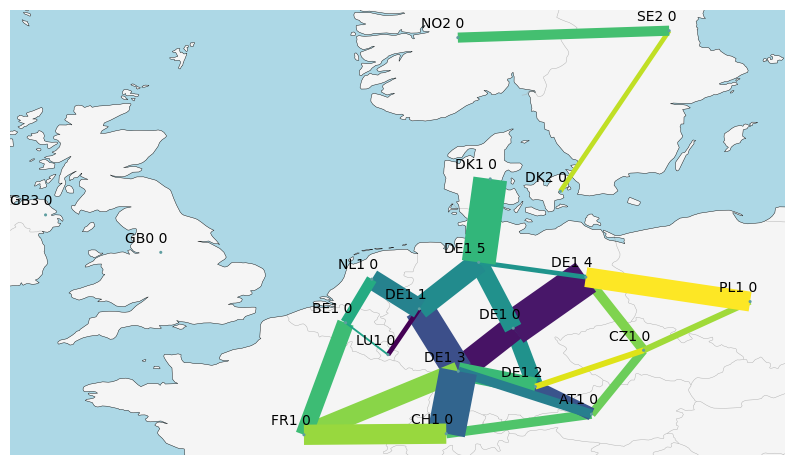

In [13]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [14]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


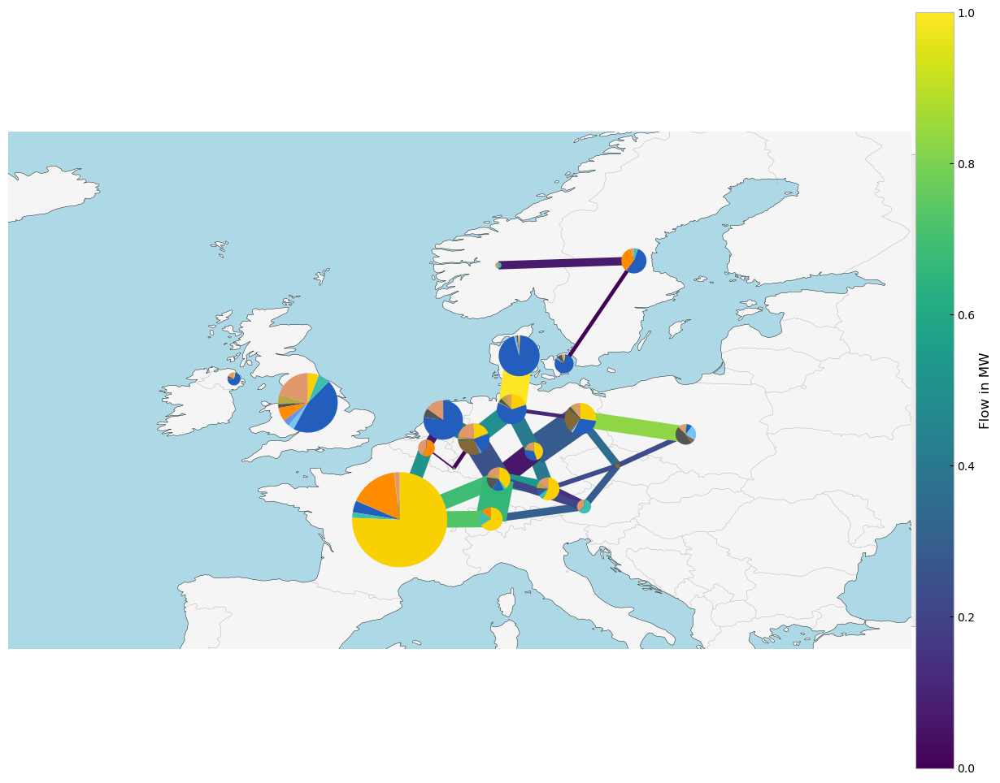

In [15]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [16]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


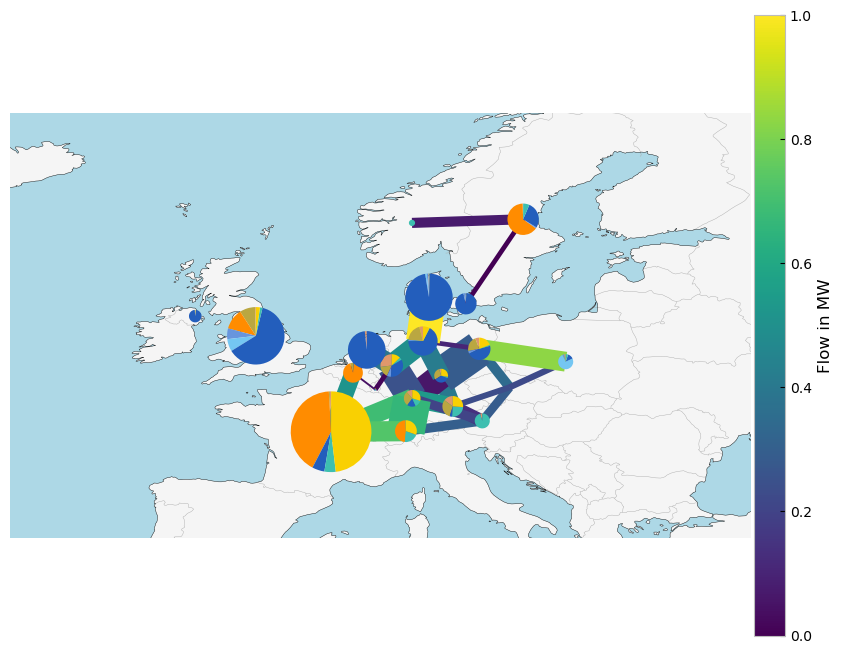

In [17]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

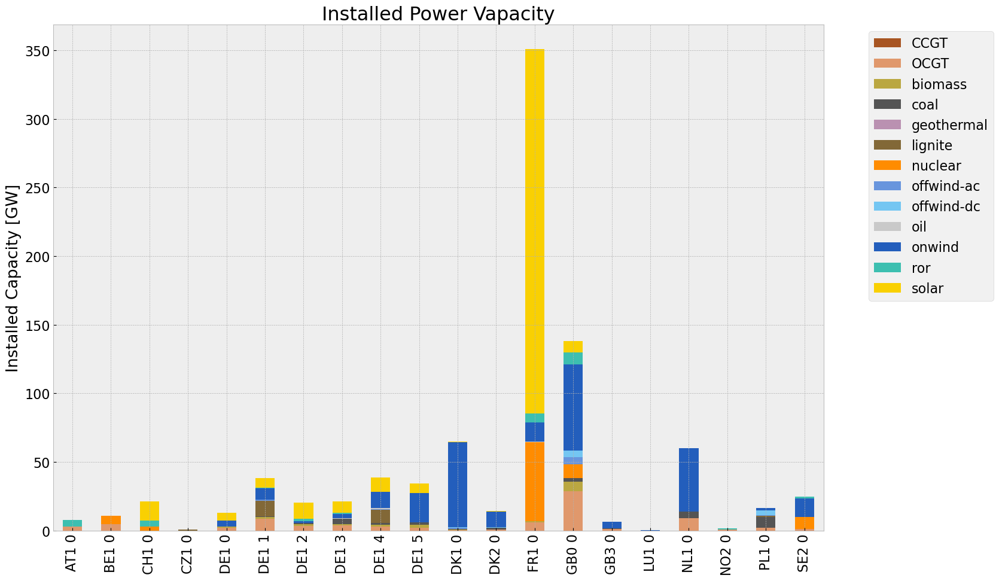

In [18]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

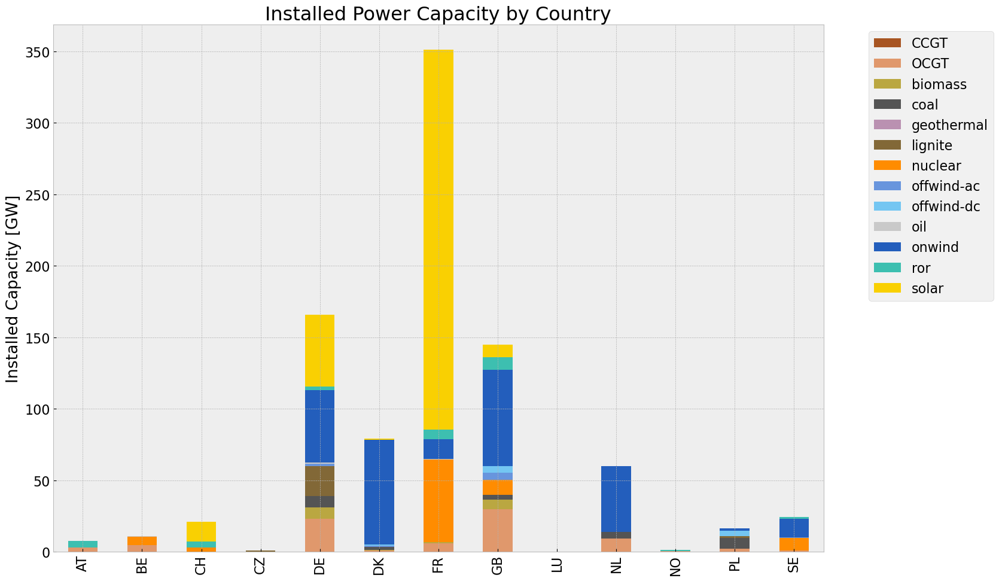

In [19]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

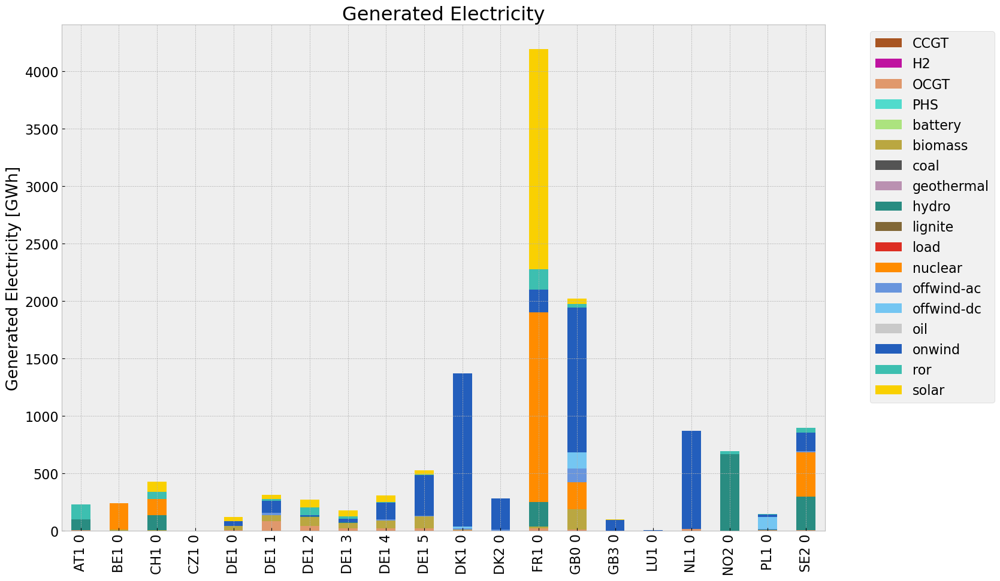

In [20]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

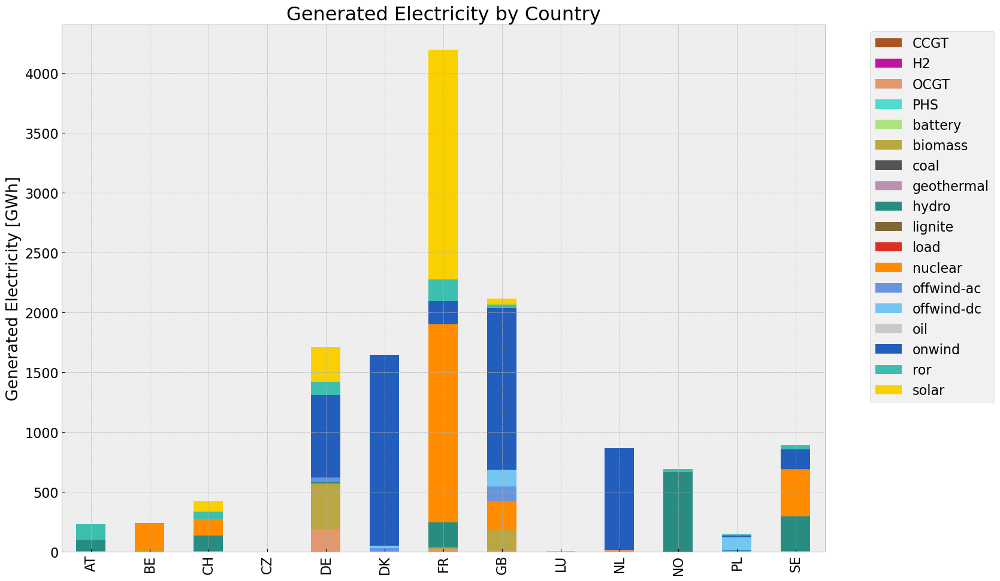

In [21]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [22]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [23]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [24]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [25]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [26]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [27]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [28]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

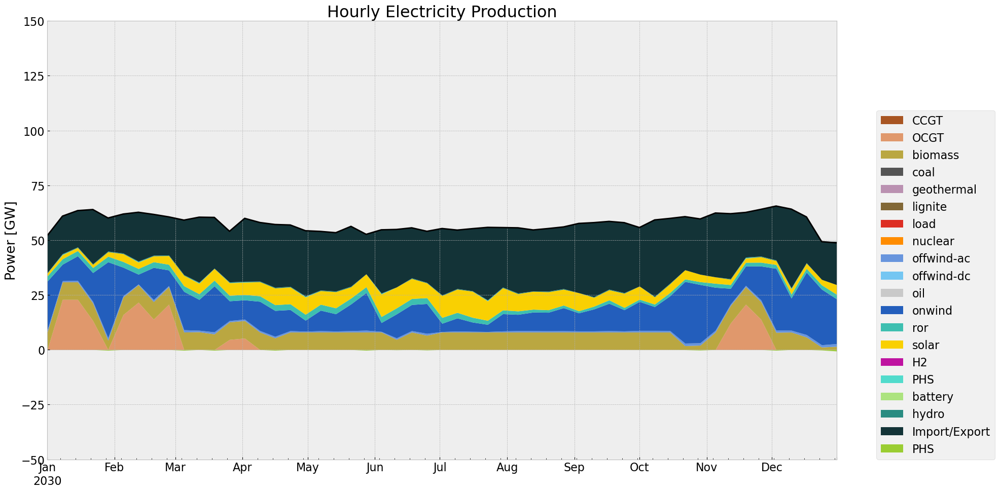

In [29]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

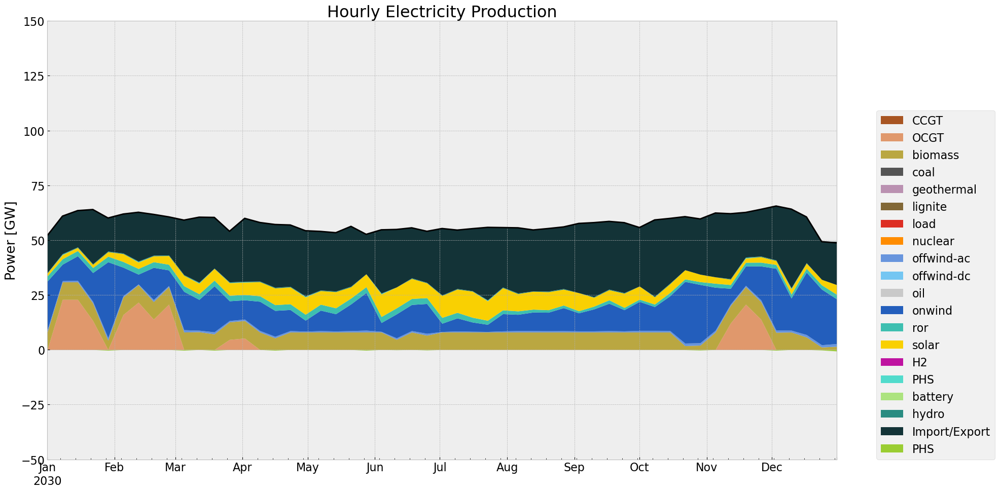

In [30]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

In [31]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

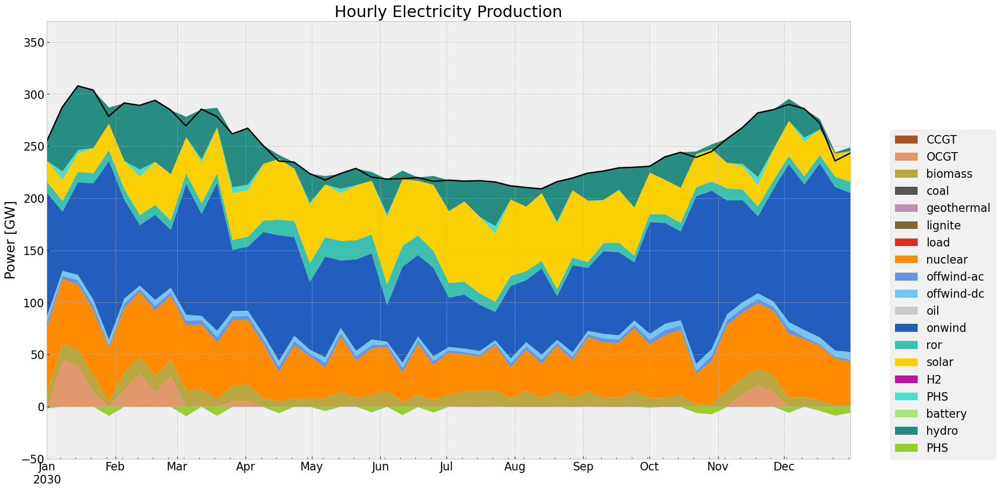

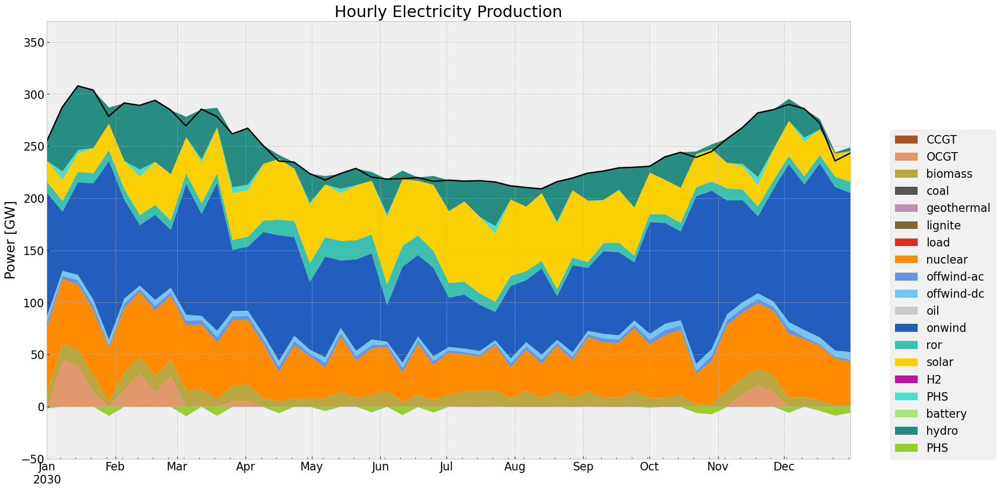

In [32]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [33]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

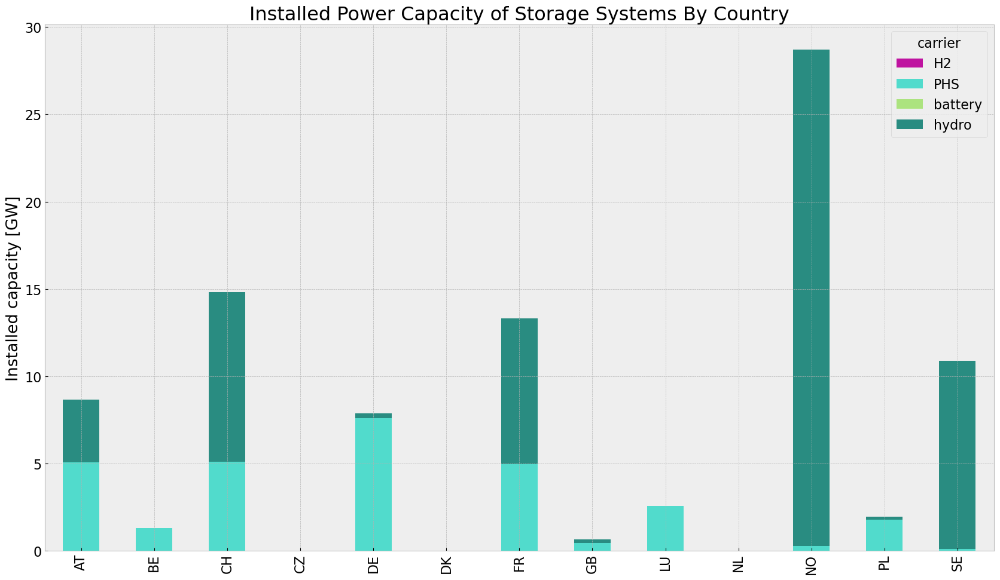

In [34]:
store_base = inst_store_table(n)

In [35]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


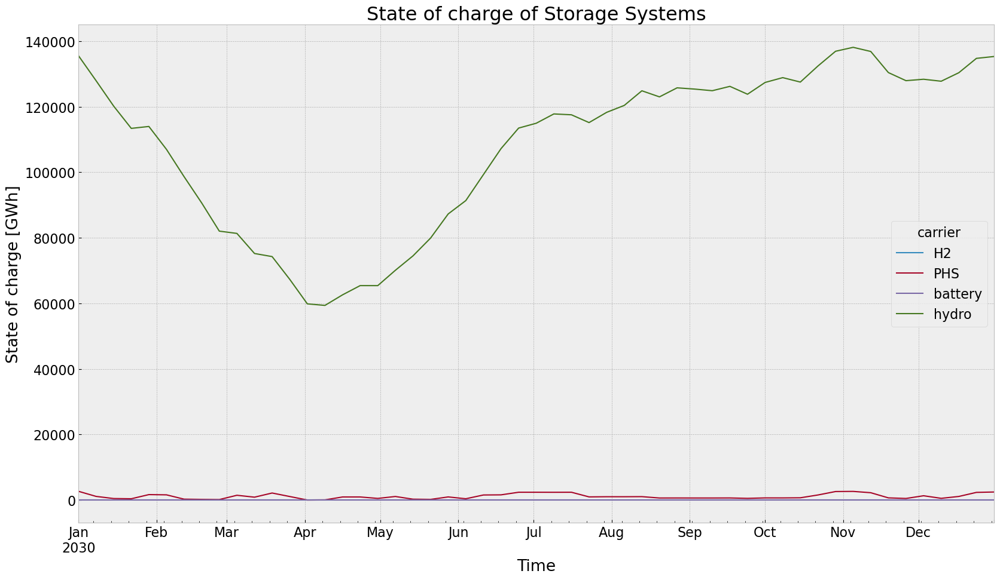

In [36]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [37]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [38]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


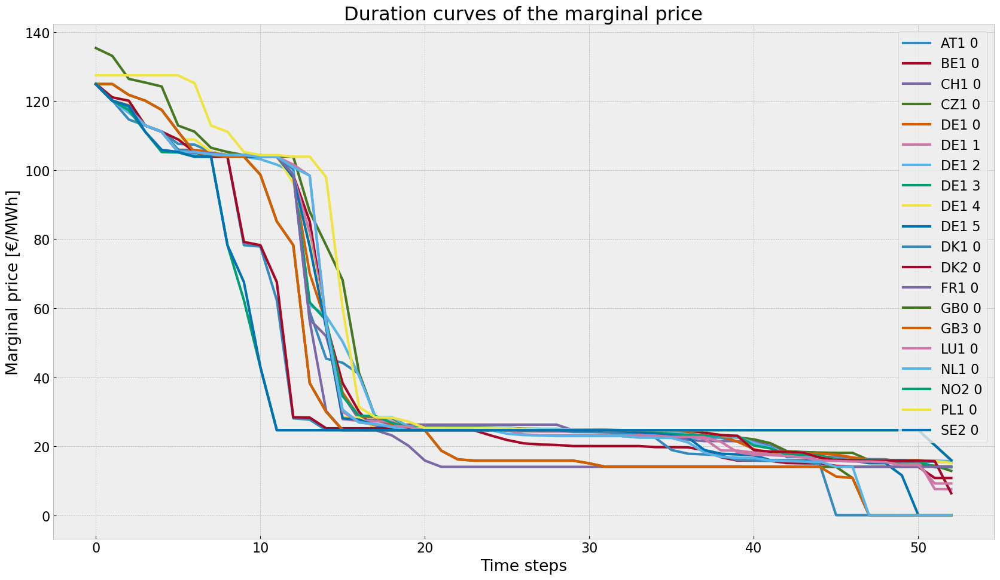

In [39]:
price_dur_curve_plot(n)

In [40]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


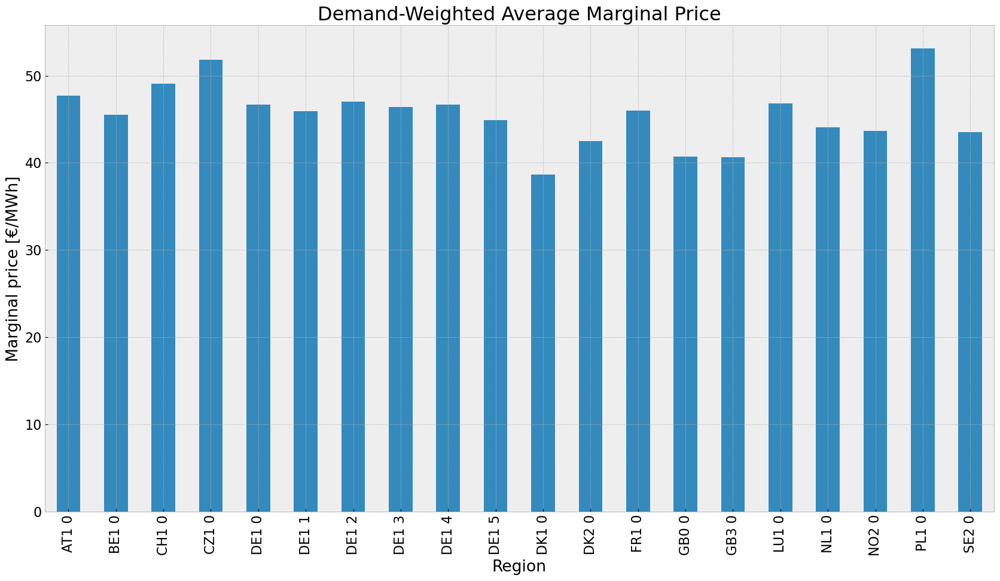

In [41]:
price_regions_table(n)

In [42]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


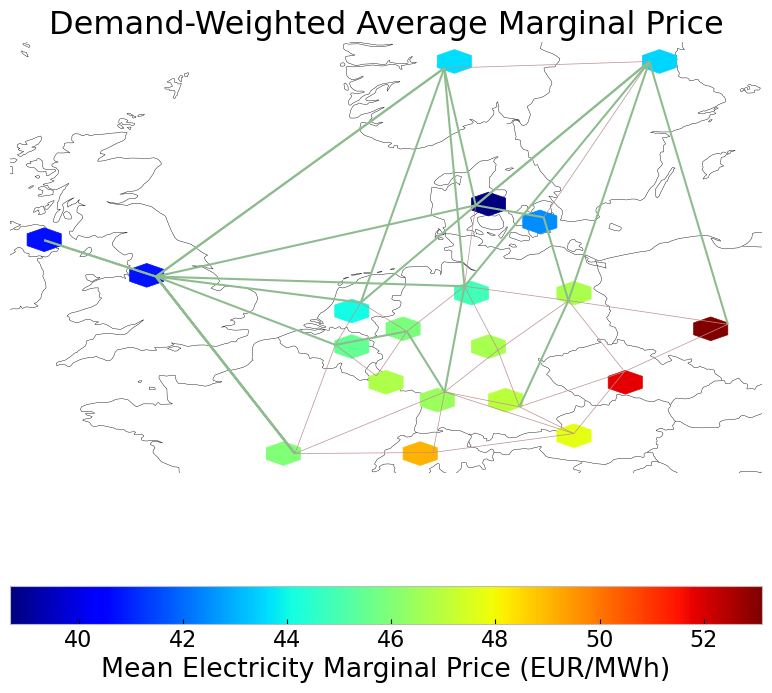

In [43]:
price_regions(n)

## Emission

In [44]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,2.470968e+05,0.451621,0.1980,108332.389629
biomass,5.975395e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329908,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,0.000000e+00,0.337285,0.4069,0.000000
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.637041e+06,0.326600,0.0000,0.000000
offwind-ac,1.967836e+05,1.000000,0.0000,0.000000


# PV Cut Scenario



In [53]:
def extract_carriers(column_names, carriers):
    """
    Filters columns that match the specified carrier names.
    
    Parameters:
    - column_names: List of column names in the DataFrame.
    - carriers: List of carrier names to match.
    
    Returns:
    - List of column names that match the carriers.
    """
    return [col for col in column_names if any(carrier in col for carrier in carriers)]

def max_generation_period(df, num_days, carriers):
    """
    Iterates through the DataFrame and finds the start date with the maximum generation sum for specified carriers over a given number of days.
    
    Parameters:
    - df: DataFrame containing the data.
    - num_days: The total number of days over which to sum the generation.
    - carriers: List of carrier names to be summed (e.g., ['CCGT', 'OCGT', 'biomass']).

    Returns:
    - Start date with the highest generation and the corresponding sum.
    """
    # Determine the timestep in days based on the DataFrame's index
    timestep = (df.index[1] - df.index[0]).total_seconds() / 86400  # Convert seconds to days
    num_rows = round(num_days / timestep)  # Calculate number of rows needed, round to nearest whole number
    
    # Extract column names matching the specified carriers
    relevant_columns = extract_carriers(df.columns, carriers)
    
    max_generation = 0
    start_date_with_max_generation = None

    # Iterate over each row in the DataFrame
    for start_idx in range(len(df)):
        #print(start_idx)
        # Ensure we do not exceed the DataFrame's length
        if start_idx + num_rows <= len(df):
            # Sum the generation for specified carriers over the period
            current_sum = df.iloc[start_idx:start_idx + num_rows][relevant_columns].sum().sum()
            #print(df.index[start_idx],current_sum)
            # Check if the current sum is the highest found so far
            if current_sum > max_generation:
                max_generation = current_sum
                start_date_with_max_generation = df.index[start_idx]

    return start_date_with_max_generation

def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC':
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC':
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False 
            
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

In [54]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
#cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, carriers_to_cut, duration, reductionto):
    #copy network
    n_new=n.copy()

    #define cut start based on the period with max generation of the chosen carrier    
    cut_start = max_generation_period(n.generators_t.p, duration, carriers_to_cut)
    print(f'cut_start: {cut_start}')
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

carriers_to_cut= ['solar']
n1 = pvscenario(n, carriers_to_cut, duration, reductionto)
n1.name = f'inv_{contingency}'          

cut_start: 2013-04-02 00:00:00


## 1. Model: perfect foresight with allowed additional investment

In [55]:
country = 'DE'

### Allow investment

In [56]:
allow_inv(n1,n, country)

In [57]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 98.35it/s]
INFO:linopy.io: Writing time: 0.91s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzxiyo14.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzxiyo14.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0xadd974ea


INFO:gurobipy:Model fingerprint: 0xadd974ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38477 rows and 7176 columns


INFO:gurobipy:Presolve removed 38477 rows and 7176 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 21079 rows, 20619 columns, 69120 nonzeros


INFO:gurobipy:Presolved: 21079 rows, 20619 columns, 69120 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 94


INFO:gurobipy: Dense cols : 94


 AA' NZ     : 1.817e+05


INFO:gurobipy: AA' NZ     : 1.817e+05


 Factor NZ  : 9.166e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 9.166e+05 (roughly 24 MB of memory)


 Factor Ops : 1.935e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.935e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.13718405e+12 -1.35567627e+14  7.09e+05 2.46e+05  3.80e+10     0s


INFO:gurobipy:   0   6.13718405e+12 -1.35567627e+14  7.09e+05 2.46e+05  3.80e+10     0s


   1   5.71136809e+12 -6.26206810e+13  4.56e+05 6.79e+04  1.69e+10     0s


INFO:gurobipy:   1   5.71136809e+12 -6.26206810e+13  4.56e+05 6.79e+04  1.69e+10     0s


   2   3.41062238e+12 -4.01552223e+13  1.11e+05 1.86e+04  4.84e+09     0s


INFO:gurobipy:   2   3.41062238e+12 -4.01552223e+13  1.11e+05 1.86e+04  4.84e+09     0s


   3   2.56309396e+12 -1.41712179e+13  1.38e+04 1.26e+03  7.01e+08     0s


INFO:gurobipy:   3   2.56309396e+12 -1.41712179e+13  1.38e+04 1.26e+03  7.01e+08     0s


   4   1.37863657e+12 -4.77356923e+12  7.83e+02 3.27e+02  1.59e+08     1s


INFO:gurobipy:   4   1.37863657e+12 -4.77356923e+12  7.83e+02 3.27e+02  1.59e+08     1s


   5   8.91800786e+11 -1.75940497e+12  3.53e+02 1.23e+02  6.46e+07     1s


INFO:gurobipy:   5   8.91800786e+11 -1.75940497e+12  3.53e+02 1.23e+02  6.46e+07     1s


   6   5.36479954e+11 -8.57532792e+11  1.67e+02 5.86e+01  3.27e+07     1s


INFO:gurobipy:   6   5.36479954e+11 -8.57532792e+11  1.67e+02 5.86e+01  3.27e+07     1s


   7   2.28424984e+11 -3.11141796e+11  3.33e+01 2.11e+01  1.22e+07     1s


INFO:gurobipy:   7   2.28424984e+11 -3.11141796e+11  3.33e+01 2.11e+01  1.22e+07     1s


   8   1.33226985e+11 -8.86535408e+10  1.07e+01 7.48e+00  4.95e+06     1s


INFO:gurobipy:   8   1.33226985e+11 -8.86535408e+10  1.07e+01 7.48e+00  4.95e+06     1s


   9   1.23135638e+11 -2.57924834e+10  9.17e+00 3.71e+00  3.31e+06     1s


INFO:gurobipy:   9   1.23135638e+11 -2.57924834e+10  9.17e+00 3.71e+00  3.31e+06     1s


  10   8.38130273e+10  3.45407606e+08  3.61e+00 2.31e+00  1.85e+06     1s


INFO:gurobipy:  10   8.38130273e+10  3.45407606e+08  3.61e+00 2.31e+00  1.85e+06     1s


  11   7.34318393e+10  1.61645023e+10  2.43e+00 1.51e+00  1.27e+06     1s


INFO:gurobipy:  11   7.34318393e+10  1.61645023e+10  2.43e+00 1.51e+00  1.27e+06     1s


  12   6.60676459e+10  3.13155707e+10  1.63e+00 8.28e-01  7.70e+05     1s


INFO:gurobipy:  12   6.60676459e+10  3.13155707e+10  1.63e+00 8.28e-01  7.70e+05     1s


  13   5.77258874e+10  3.92216501e+10  7.30e-01 4.58e-01  4.10e+05     1s


INFO:gurobipy:  13   5.77258874e+10  3.92216501e+10  7.30e-01 4.58e-01  4.10e+05     1s


  14   5.51359635e+10  4.21499936e+10  4.84e-01 3.26e-01  2.87e+05     1s


INFO:gurobipy:  14   5.51359635e+10  4.21499936e+10  4.84e-01 3.26e-01  2.87e+05     1s


  15   5.44767263e+10  4.36871178e+10  4.19e-01 2.56e-01  2.39e+05     1s


INFO:gurobipy:  15   5.44767263e+10  4.36871178e+10  4.19e-01 2.56e-01  2.39e+05     1s


  16   5.33124145e+10  4.48624822e+10  3.16e-01 2.04e-01  1.87e+05     1s


INFO:gurobipy:  16   5.33124145e+10  4.48624822e+10  3.16e-01 2.04e-01  1.87e+05     1s


  17   5.17916633e+10  4.68999013e+10  1.81e-01 1.15e-01  1.08e+05     1s


INFO:gurobipy:  17   5.17916633e+10  4.68999013e+10  1.81e-01 1.15e-01  1.08e+05     1s


  18   5.10470712e+10  4.72988701e+10  1.18e-01 9.77e-02  8.29e+04     1s


INFO:gurobipy:  18   5.10470712e+10  4.72988701e+10  1.18e-01 9.77e-02  8.29e+04     1s


  19   5.06242578e+10  4.79530757e+10  7.81e-02 7.06e-02  5.91e+04     1s


INFO:gurobipy:  19   5.06242578e+10  4.79530757e+10  7.81e-02 7.06e-02  5.91e+04     1s


  20   5.03738306e+10  4.82384195e+10  5.57e-02 5.90e-02  4.72e+04     1s


INFO:gurobipy:  20   5.03738306e+10  4.82384195e+10  5.57e-02 5.90e-02  4.72e+04     1s


  21   5.00940418e+10  4.91701158e+10  3.32e-02 1.98e-02  2.04e+04     1s


INFO:gurobipy:  21   5.00940418e+10  4.91701158e+10  3.32e-02 1.98e-02  2.04e+04     1s


  22   4.99223776e+10  4.93536526e+10  1.92e-02 1.24e-02  1.26e+04     1s


INFO:gurobipy:  22   4.99223776e+10  4.93536526e+10  1.92e-02 1.24e-02  1.26e+04     1s


  23   4.98579300e+10  4.94477256e+10  1.44e-02 8.50e-03  9.07e+03     1s


INFO:gurobipy:  23   4.98579300e+10  4.94477256e+10  1.44e-02 8.50e-03  9.07e+03     1s


  24   4.97837015e+10  4.95199660e+10  8.55e-03 5.64e-03  5.83e+03     1s


INFO:gurobipy:  24   4.97837015e+10  4.95199660e+10  8.55e-03 5.64e-03  5.83e+03     1s


  25   4.97477559e+10  4.95755201e+10  5.77e-03 3.47e-03  3.81e+03     1s


INFO:gurobipy:  25   4.97477559e+10  4.95755201e+10  5.77e-03 3.47e-03  3.81e+03     1s


  26   4.97215947e+10  4.96250970e+10  3.80e-03 1.53e-03  2.13e+03     1s


INFO:gurobipy:  26   4.97215947e+10  4.96250970e+10  3.80e-03 1.53e-03  2.13e+03     1s


  27   4.96901786e+10  4.96416455e+10  1.53e-03 9.22e-04  1.07e+03     1s


INFO:gurobipy:  27   4.96901786e+10  4.96416455e+10  1.53e-03 9.22e-04  1.07e+03     1s


  28   4.96756867e+10  4.96583831e+10  5.16e-04 2.98e-04  3.83e+02     1s


INFO:gurobipy:  28   4.96756867e+10  4.96583831e+10  5.16e-04 2.98e-04  3.83e+02     1s


  29   4.96703842e+10  4.96638918e+10  1.74e-04 1.06e-04  1.44e+02     1s


INFO:gurobipy:  29   4.96703842e+10  4.96638918e+10  1.74e-04 1.06e-04  1.44e+02     1s


  30   4.96682069e+10  4.96665801e+10  4.48e-05 2.08e-05  3.59e+01     2s


INFO:gurobipy:  30   4.96682069e+10  4.96665801e+10  4.48e-05 2.08e-05  3.59e+01     2s


  31   4.96674335e+10  4.96672168e+10  4.92e-06 2.50e-06  4.79e+00     2s


INFO:gurobipy:  31   4.96674335e+10  4.96672168e+10  4.92e-06 2.50e-06  4.79e+00     2s


  32   4.96673557e+10  4.96673188e+10  1.53e-06 2.99e-07  8.14e-01     2s


INFO:gurobipy:  32   4.96673557e+10  4.96673188e+10  1.53e-06 2.99e-07  8.14e-01     2s


  33   4.96673424e+10  4.96673299e+10  8.06e-07 8.63e-08  2.76e-01     2s


INFO:gurobipy:  33   4.96673424e+10  4.96673299e+10  8.06e-07 8.63e-08  2.76e-01     2s


  34   4.96673407e+10  4.96673329e+10  6.30e-07 3.46e-08  1.71e-01     2s


INFO:gurobipy:  34   4.96673407e+10  4.96673329e+10  6.30e-07 3.46e-08  1.71e-01     2s


  35   4.96673355e+10  4.96673349e+10  1.76e-06 6.25e-10  1.19e-02     2s


INFO:gurobipy:  35   4.96673355e+10  4.96673349e+10  1.76e-06 6.25e-10  1.19e-02     2s


  36   4.96673351e+10  4.96673351e+10  9.48e-06 1.63e-10  1.48e-04     2s


INFO:gurobipy:  36   4.96673351e+10  4.96673351e+10  9.48e-06 1.63e-10  1.48e-04     2s


  37   4.96673351e+10  4.96673351e+10  6.36e-08 1.38e-10  3.16e-07     2s


INFO:gurobipy:  37   4.96673351e+10  4.96673351e+10  6.36e-08 1.38e-10  3.16e-07     2s


  38   4.96673351e+10  4.96673351e+10  3.41e-08 3.36e-10  6.85e-09     2s


INFO:gurobipy:  38   4.96673351e+10  4.96673351e+10  3.41e-08 3.36e-10  6.85e-09     2s


INFO:gurobipy:


Barrier solved model in 38 iterations and 2.22 seconds (0.73 work units)


INFO:gurobipy:Barrier solved model in 38 iterations and 2.22 seconds (0.73 work units)


Optimal objective 4.96673351e+10


INFO:gurobipy:Optimal objective 4.96673351e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10937 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:   10937 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     106 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     106 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 7.9520174e-10      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 7.9520174e-10      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5514    4.9667335e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    5514    4.9667335e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 5514 iterations and 2.47 seconds (0.88 work units)


INFO:gurobipy:Solved in 5514 iterations and 2.47 seconds (0.88 work units)


Optimal objective  4.966733511e+10


INFO:gurobipy:Optimal objective  4.966733511e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.97e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [58]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv.nc has lines, links, loads, carriers, buses, generators, storage_units


<xarray.Dataset> Size: 273kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, links_i: 28,
                                           links_t_p0_i: 15, links_t_p1_i: 15,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           ...
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 25,
                                           storage_units_t_p_dispatch_i: 25,
                                           storage_units_t_p_store_i: 15,
                                           storage_units_t_state_of_charge_i: 65)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 200B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 200B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_country                 (storage_units_i) object 520B 'AT' ...
    storage_units_t_inflow                (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                     (snapshots, storage_units_t_p_i) float64 11kB ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 11kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           49667335111.35659
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [59]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

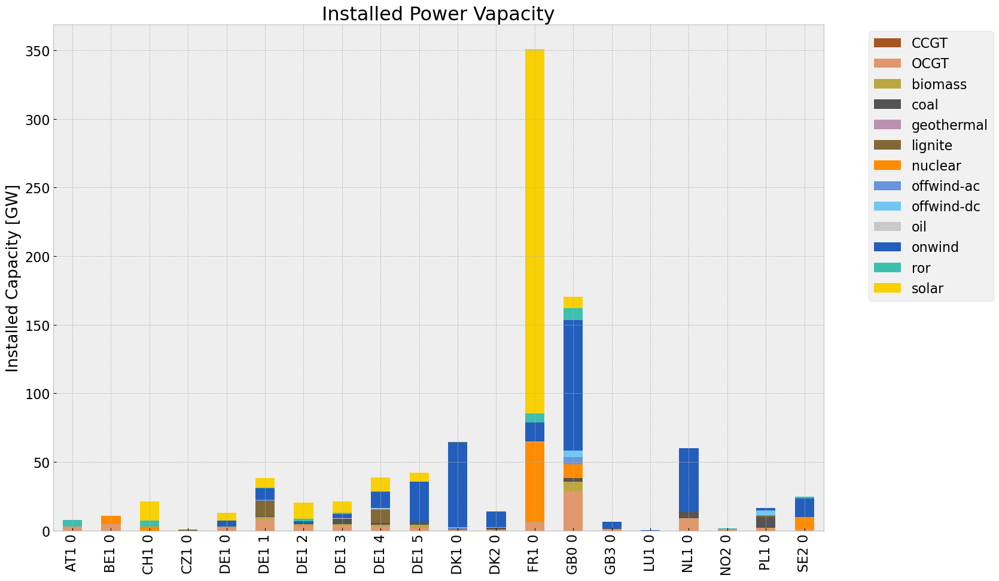

<Figure size 640x480 with 0 Axes>

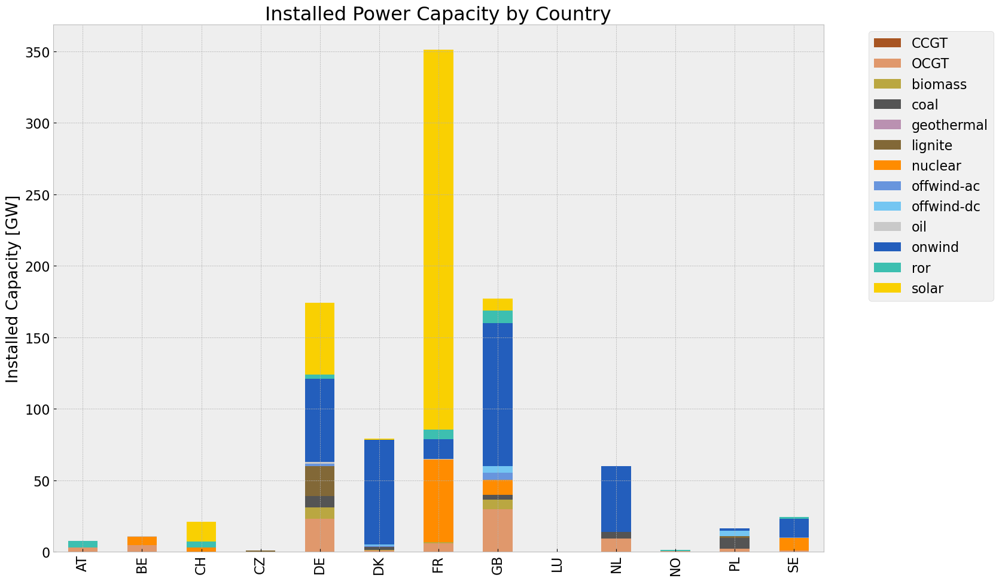

In [60]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

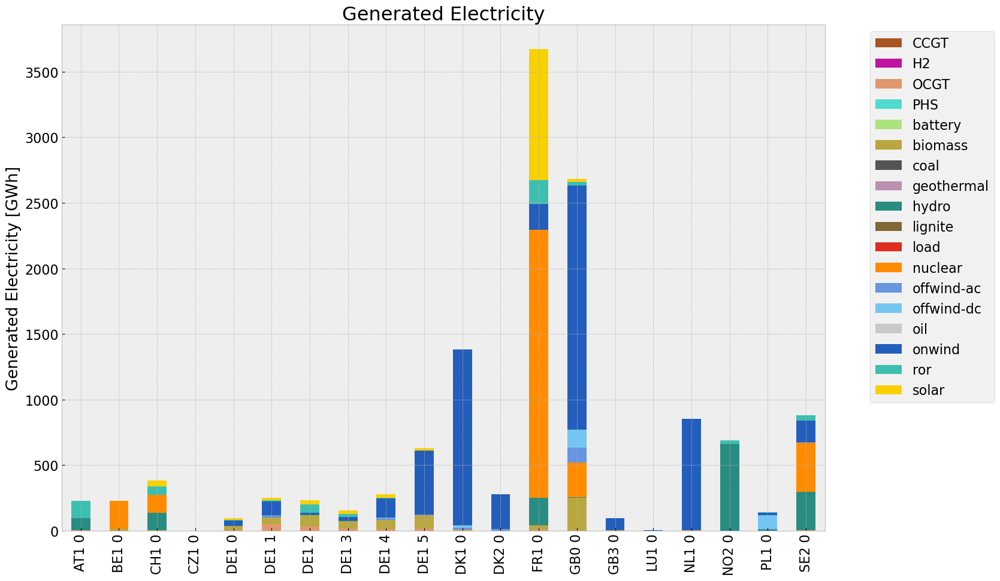

<Figure size 640x480 with 0 Axes>

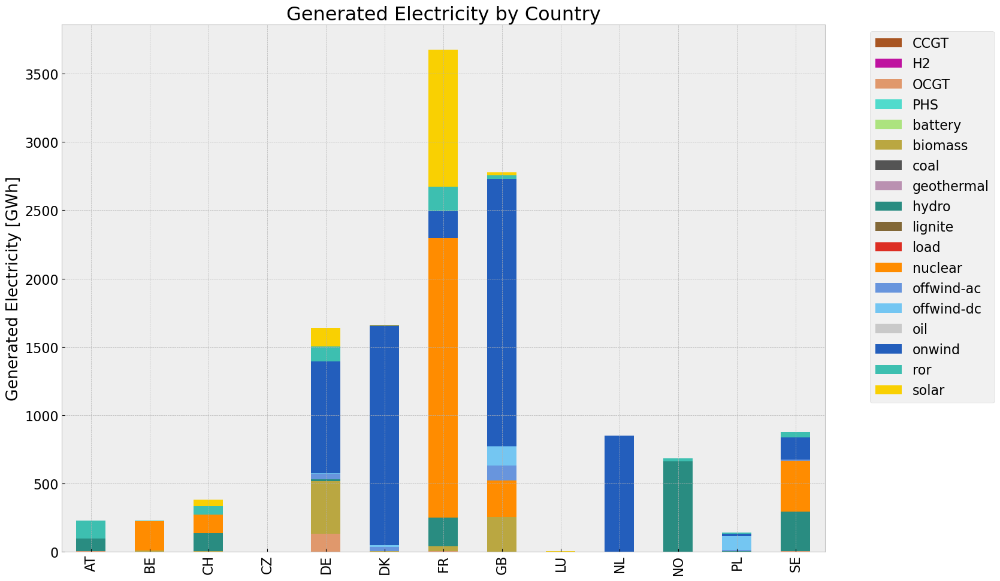

In [61]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

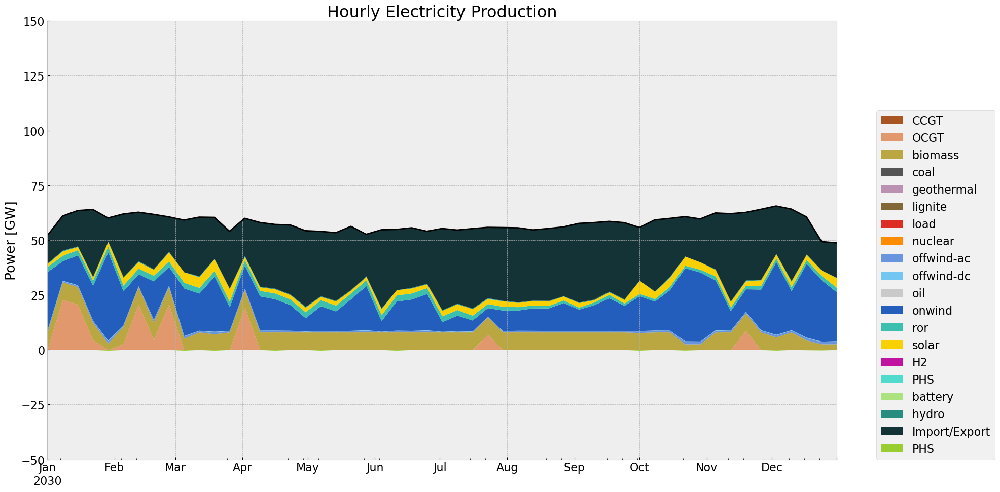

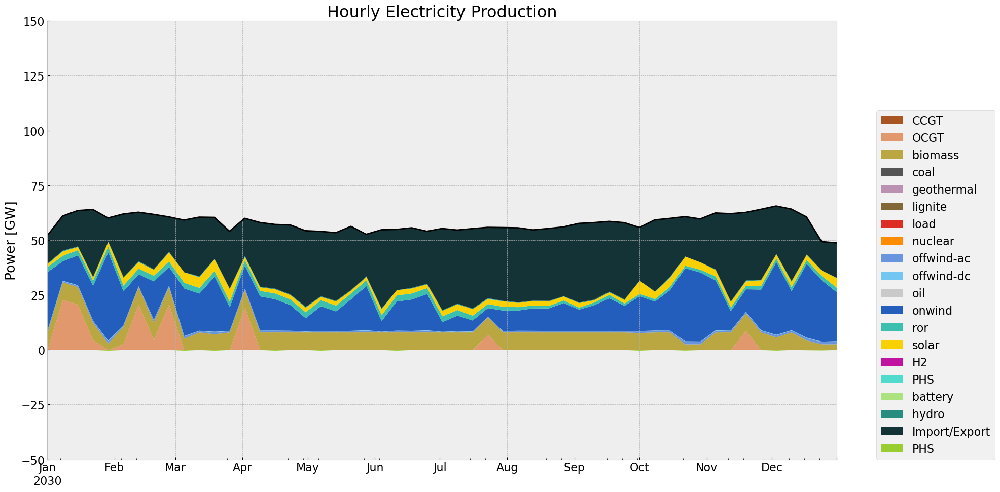

In [62]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

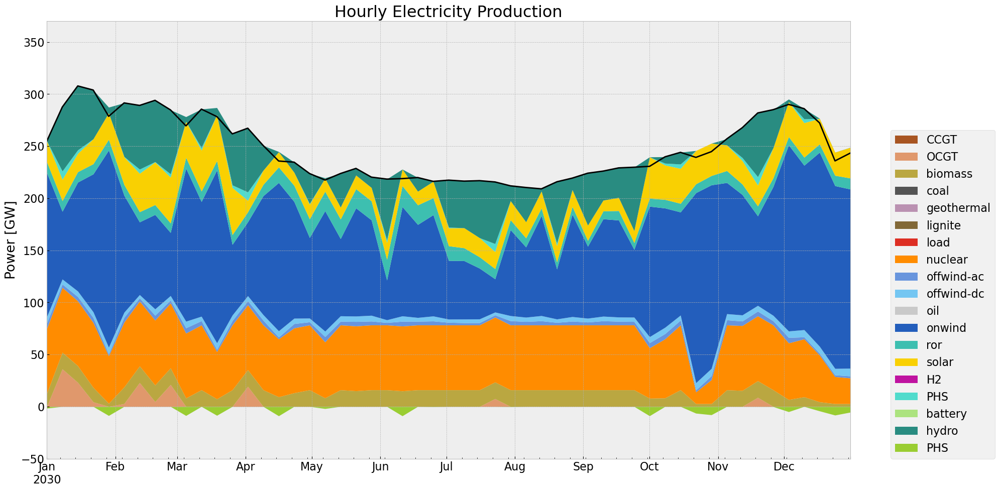

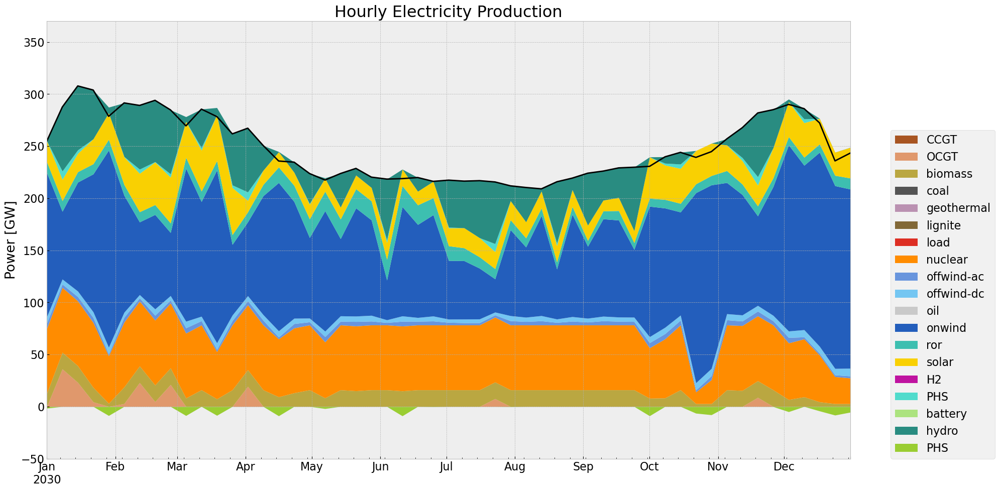

In [63]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

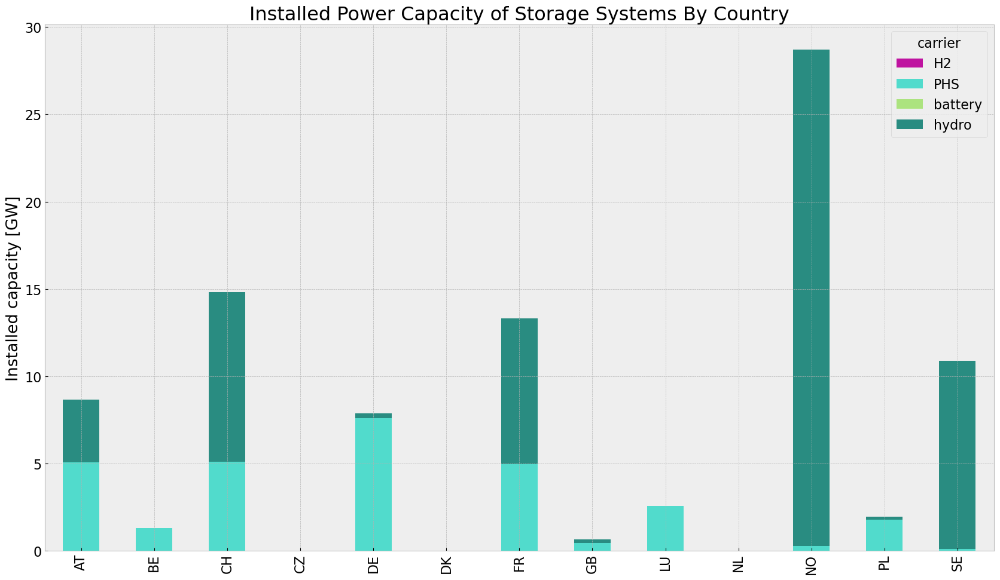

In [64]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


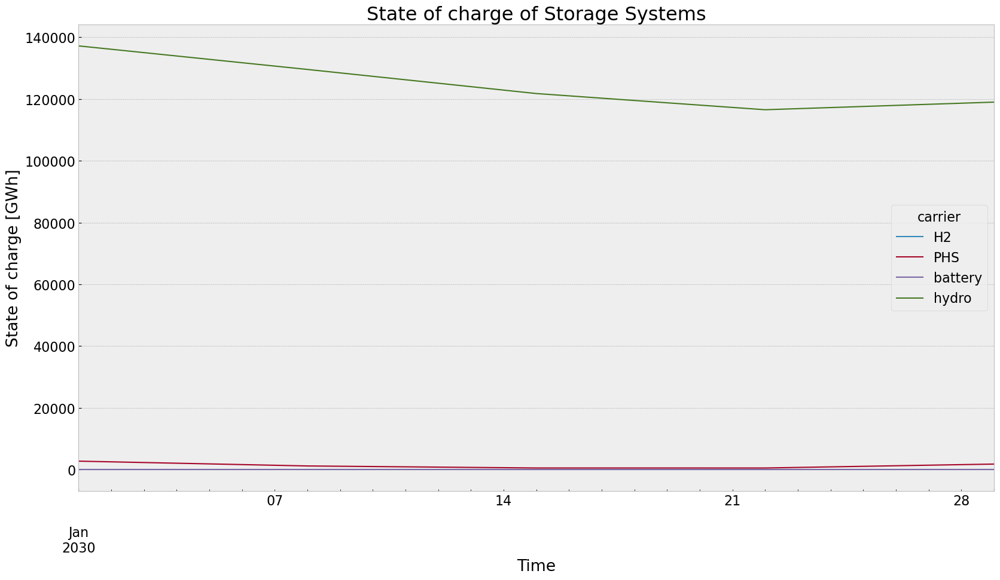

In [65]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


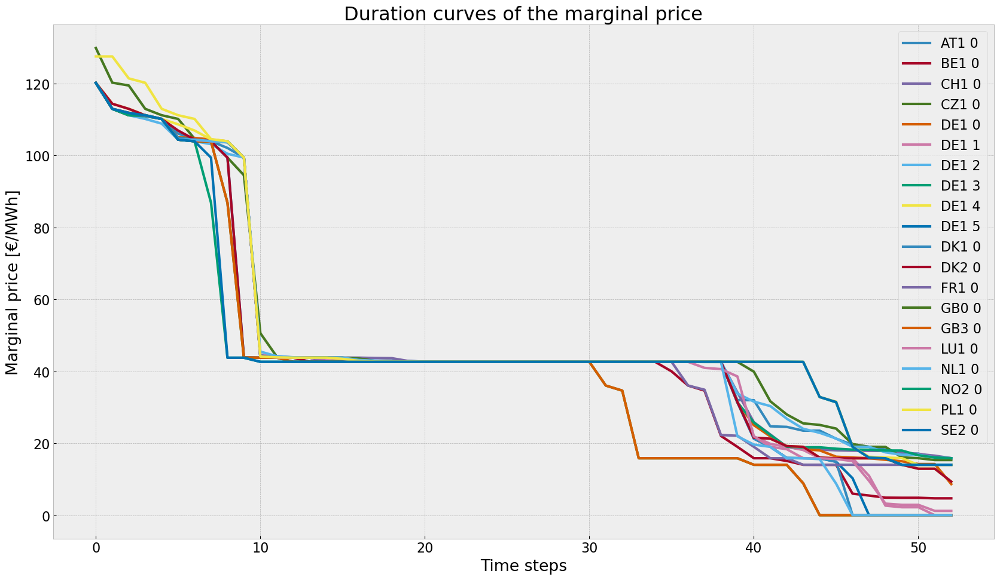

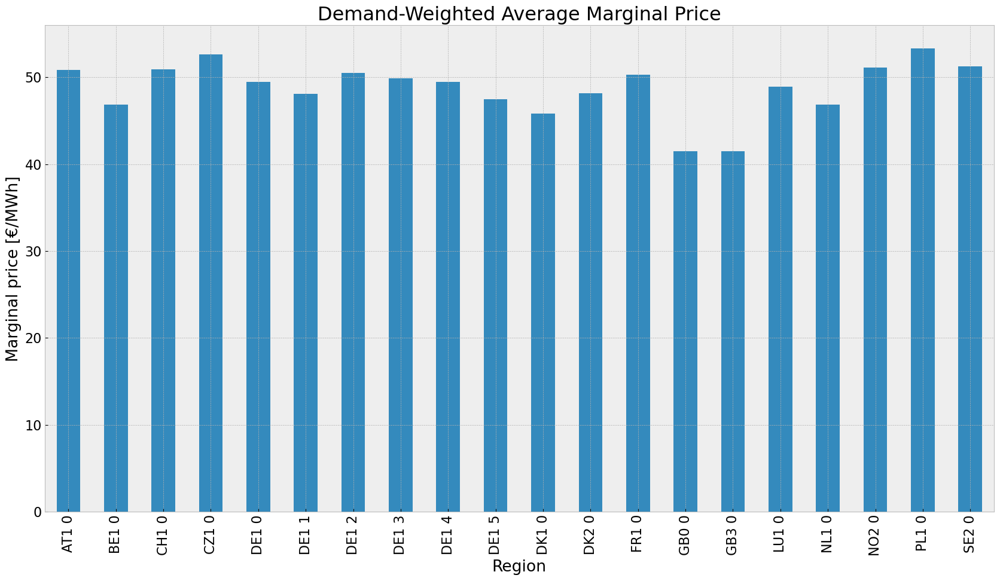

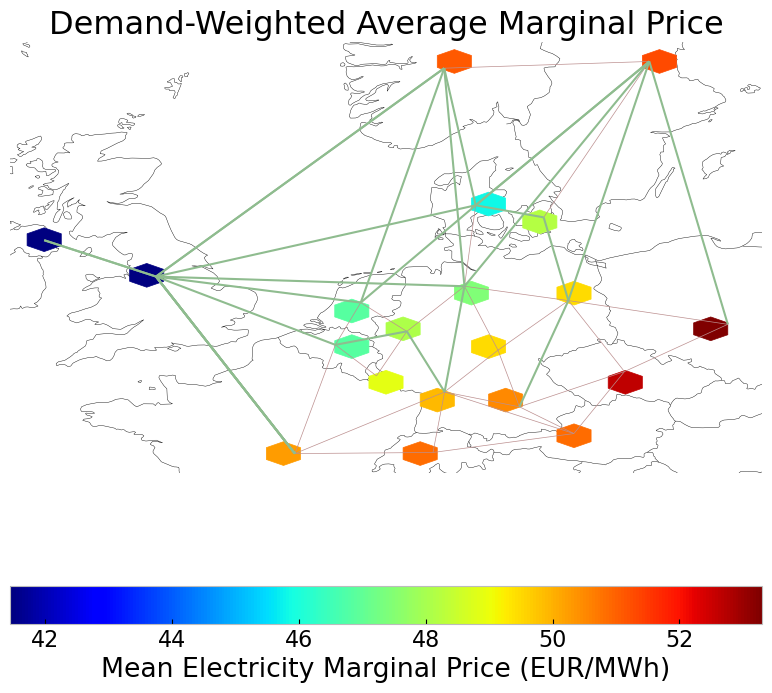

In [66]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [67]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.0000
OCGT,1.502272e+05,0.451621,0.1980,65862.7537
biomass,6.953890e+05,0.468000,0.0000,0.0000
coal,0.000000e+00,0.329908,0.3361,0.0000
geothermal,0.000000e+00,1.000000,0.1200,0.0000
lignite,0.000000e+00,0.337285,0.4069,0.0000
load,0.000000e+00,1.000000,0.0000,0.0000
nuclear,3.034999e+06,0.326600,0.0000,0.0000
offwind-ac,1.875226e+05,1.000000,0.0000,0.0000


## 2. Noinv

In [71]:
n2 = pvscenario(n, carriers_to_cut, duration, reductionto)

cut_start: 2013-04-02 00:00:00


### No Investment

In [72]:
no_inv(n2,n)


In [73]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False


horizon = 4
optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'


INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l4r_sos1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l4r_sos1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x9ebef0cf


INFO:gurobipy:Model fingerprint: 0x9ebef0cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1122 columns


INFO:gurobipy:Presolve removed 4248 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 962 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 962 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5767799e+07   1.112692e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5767799e+07   1.112692e+06   0.000000e+00      0s


     333    5.2655288e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     333    5.2655288e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 333 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 333 iterations and 0.05 seconds (0.01 work units)


Optimal objective  5.265528775e+09


INFO:gurobipy:Optimal objective  5.265528775e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-su4djdv0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-su4djdv0.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xb42eaac0


INFO:gurobipy:Model fingerprint: 0xb42eaac0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1122 columns


INFO:gurobipy:Presolve removed 4249 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5741887e+07   1.102520e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5741887e+07   1.102520e+06   0.000000e+00      0s


     335    4.3807431e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     335    4.3807431e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 335 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 335 iterations and 0.07 seconds (0.01 work units)


Optimal objective  4.380743054e+09


INFO:gurobipy:Optimal objective  4.380743054e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loi21vrk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loi21vrk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xe7a052f7


INFO:gurobipy:Model fingerprint: 0xe7a052f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1121 columns


INFO:gurobipy:Presolve removed 4248 rows and 1121 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 963 columns, 1583 nonzeros


INFO:gurobipy:Presolved: 224 rows, 963 columns, 1583 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3343276e+07   1.115639e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.3343276e+07   1.115639e+06   0.000000e+00      0s


     345    2.8211874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     345    2.8211874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 345 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 345 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.821187377e+09


INFO:gurobipy:Optimal objective  2.821187377e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifeihpex.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifeihpex.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x379980ef


INFO:gurobipy:Model fingerprint: 0x379980ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1119 columns


INFO:gurobipy:Presolve removed 4249 rows and 1119 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 965 columns, 1584 nonzeros


INFO:gurobipy:Presolved: 223 rows, 965 columns, 1584 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9988678e+04   1.127325e+06   0.000000e+00      0s


INFO:gurobipy:       0   -4.9988678e+04   1.127325e+06   0.000000e+00      0s


     375    2.0898375e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     375    2.0898375e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 375 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 375 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.089837531e+09


INFO:gurobipy:Optimal objective  2.089837531e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apfq2qyv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apfq2qyv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x409ea872


INFO:gurobipy:Model fingerprint: 0x409ea872


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4249 rows and 1116 columns


INFO:gurobipy:Presolve removed 4249 rows and 1116 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 968 columns, 1587 nonzeros


INFO:gurobipy:Presolved: 223 rows, 968 columns, 1587 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7804016e+05   1.142855e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.7804016e+05   1.142855e+06   0.000000e+00      0s


     397    3.6745637e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     397    3.6745637e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 397 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 397 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.674563700e+08


INFO:gurobipy:Optimal objective  3.674563700e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99hdlvgh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99hdlvgh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x62e14a18


INFO:gurobipy:Model fingerprint: 0x62e14a18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1120 columns


INFO:gurobipy:Presolve removed 4249 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 964 columns, 1583 nonzeros


INFO:gurobipy:Presolved: 223 rows, 964 columns, 1583 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5501607e+07   1.138606e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5501607e+07   1.138606e+06   0.000000e+00      0s


     330    1.2277237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     330    1.2277237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 330 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 330 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.227723709e+08


INFO:gurobipy:Optimal objective  1.227723709e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22kce2cj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22kce2cj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xc4bfe875


INFO:gurobipy:Model fingerprint: 0xc4bfe875


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4249 rows and 1117 columns


INFO:gurobipy:Presolve removed 4249 rows and 1117 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5437219e+07   1.139039e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5437219e+07   1.139039e+06   0.000000e+00      0s


     426    2.3597184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     426    2.3597184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 426 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 426 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.359718428e+08


INFO:gurobipy:Optimal objective  2.359718428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xnpho0d7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xnpho0d7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x89e5542d


INFO:gurobipy:Model fingerprint: 0x89e5542d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1122 columns


INFO:gurobipy:Presolve removed 4249 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3401526e+05   1.131754e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.3401526e+05   1.131754e+06   0.000000e+00      0s


     427    4.9163806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     427    4.9163806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 427 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 427 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.916380649e+08


INFO:gurobipy:Optimal objective  4.916380649e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxcgcp4u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxcgcp4u.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x5af1e751


INFO:gurobipy:Model fingerprint: 0x5af1e751


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1117 columns


INFO:gurobipy:Presolve removed 4249 rows and 1117 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6241924e+05   1.127688e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.6241924e+05   1.127688e+06   0.000000e+00      0s


     446    4.4814206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     446    4.4814206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 446 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 446 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.481420563e+08


INFO:gurobipy:Optimal objective  4.481420563e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g5y9vxq_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g5y9vxq_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x9442647a


INFO:gurobipy:Model fingerprint: 0x9442647a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4250 rows and 1111 columns


INFO:gurobipy:Presolve removed 4250 rows and 1111 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 973 columns, 1591 nonzeros


INFO:gurobipy:Presolved: 222 rows, 973 columns, 1591 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.5434087e+05   1.117963e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.5434087e+05   1.117963e+06   0.000000e+00      0s


     460    5.9225330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     460    5.9225330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 460 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 460 iterations and 0.05 seconds (0.01 work units)


Optimal objective  5.922533020e+08


INFO:gurobipy:Optimal objective  5.922533020e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-exsbbpqk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-exsbbpqk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xd286518b


INFO:gurobipy:Model fingerprint: 0xd286518b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1124 columns


INFO:gurobipy:Presolve removed 4248 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 960 columns, 1580 nonzeros


INFO:gurobipy:Presolved: 224 rows, 960 columns, 1580 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5487342e+05   1.109280e+06   0.000000e+00      0s


INFO:gurobipy:       0   -2.5487342e+05   1.109280e+06   0.000000e+00      0s


     440    3.6392302e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     440    3.6392302e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 440 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 440 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.639230235e+08


INFO:gurobipy:Optimal objective  3.639230235e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50cdeo1c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50cdeo1c.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xf98372a6


INFO:gurobipy:Model fingerprint: 0xf98372a6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4249 rows and 1109 columns


INFO:gurobipy:Presolve removed 4249 rows and 1109 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 975 columns, 1594 nonzeros


INFO:gurobipy:Presolved: 223 rows, 975 columns, 1594 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.3674611e+04   1.090772e+06   0.000000e+00      0s


INFO:gurobipy:       0   -9.3674611e+04   1.090772e+06   0.000000e+00      0s


     390    2.6622187e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     390    2.6622187e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 390 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 390 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.662218676e+09


INFO:gurobipy:Optimal objective  2.662218676e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfpk_sht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfpk_sht.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x1bfe419f


INFO:gurobipy:Model fingerprint: 0x1bfe419f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1157 columns


INFO:gurobipy:Presolve removed 4248 rows and 1157 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 927 columns, 1547 nonzeros


INFO:gurobipy:Presolved: 224 rows, 927 columns, 1547 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.6412810e+04   1.122020e+06   0.000000e+00      0s


INFO:gurobipy:       0   -6.6412810e+04   1.122020e+06   0.000000e+00      0s


     445    4.5135805e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     445    4.5135805e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 445 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 445 iterations and 0.07 seconds (0.01 work units)


Optimal objective  4.513580527e+08


INFO:gurobipy:Optimal objective  4.513580527e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rd3f8in8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rd3f8in8.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1702 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1702 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


Model fingerprint: 0x61c74c45


INFO:gurobipy:Model fingerprint: 0x61c74c45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1087 rows and 349 columns


INFO:gurobipy:Presolve removed 1087 rows and 349 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 31 rows, 172 columns, 262 nonzeros


INFO:gurobipy:Presolved: 31 rows, 172 columns, 262 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2844390e+03   2.509625e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2844390e+03   2.509625e+05   0.000000e+00      0s


      33    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      33    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 33 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 33 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.757293423e+06


INFO:gurobipy:Optimal objective  6.757293423e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 6.76e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [74]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 61.94it/s]
INFO:linopy.io: Writing time: 0.74s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l1_gcnzm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l1_gcnzm.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xb87d67bc


INFO:gurobipy:Model fingerprint: 0xb87d67bc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56296 rows and 14781 columns


INFO:gurobipy:Presolve removed 56296 rows and 14781 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2958 rows, 12832 columns, 21037 nonzeros


INFO:gurobipy:Presolved: 2958 rows, 12832 columns, 21037 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.629e+03


INFO:gurobipy: AA' NZ     : 8.629e+03


 Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


 Factor Ops : 6.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.519e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68638309e+13 -3.21416720e+13  5.69e+05 1.46e-11  7.73e+09     0s


INFO:gurobipy:   0   1.68638309e+13 -3.21416720e+13  5.69e+05 1.46e-11  7.73e+09     0s


   1   1.42742249e+12 -9.42007703e+12  3.59e+04 1.02e-10  7.46e+08     0s


INFO:gurobipy:   1   1.42742249e+12 -9.42007703e+12  3.59e+04 1.02e-10  7.46e+08     0s


   2   2.53194774e+11 -2.26293219e+12  2.76e+03 1.60e-10  1.15e+08     0s


INFO:gurobipy:   2   2.53194774e+11 -2.26293219e+12  2.76e+03 1.60e-10  1.15e+08     0s


   3   9.80287979e+10 -3.08311388e+11  2.48e+02 8.44e-10  1.65e+07     0s


INFO:gurobipy:   3   9.80287979e+10 -3.08311388e+11  2.48e+02 8.44e-10  1.65e+07     0s


   4   5.01784260e+10 -8.77998588e+10  1.81e+01 2.91e-10  5.40e+06     0s


INFO:gurobipy:   4   5.01784260e+10 -8.77998588e+10  1.81e+01 2.91e-10  5.40e+06     0s


   5   4.02952908e+10 -1.97691724e+10  9.31e+00 1.16e-10  2.35e+06     0s


INFO:gurobipy:   5   4.02952908e+10 -1.97691724e+10  9.31e+00 1.16e-10  2.35e+06     0s


   6   3.12250694e+10  7.04798724e+09  3.75e+00 5.82e-11  9.43e+05     0s


INFO:gurobipy:   6   3.12250694e+10  7.04798724e+09  3.75e+00 5.82e-11  9.43e+05     0s


   7   2.67405719e+10  1.47949898e+10  1.64e+00 5.82e-11  4.66e+05     0s


INFO:gurobipy:   7   2.67405719e+10  1.47949898e+10  1.64e+00 5.82e-11  4.66e+05     0s


   8   2.38891125e+10  1.86985960e+10  4.41e-01 5.82e-11  2.02e+05     0s


INFO:gurobipy:   8   2.38891125e+10  1.86985960e+10  4.41e-01 5.82e-11  2.02e+05     0s


   9   2.33062487e+10  2.02004008e+10  2.64e-01 5.82e-11  1.21e+05     0s


INFO:gurobipy:   9   2.33062487e+10  2.02004008e+10  2.64e-01 5.82e-11  1.21e+05     0s


  10   2.27870007e+10  2.10516277e+10  1.13e-01 5.82e-11  6.76e+04     0s


INFO:gurobipy:  10   2.27870007e+10  2.10516277e+10  1.13e-01 5.82e-11  6.76e+04     0s


  11   2.26547816e+10  2.16881832e+10  7.73e-02 5.82e-11  3.77e+04     0s


INFO:gurobipy:  11   2.26547816e+10  2.16881832e+10  7.73e-02 5.82e-11  3.77e+04     0s


  12   2.25310447e+10  2.19644613e+10  4.48e-02 8.73e-11  2.21e+04     0s


INFO:gurobipy:  12   2.25310447e+10  2.19644613e+10  4.48e-02 8.73e-11  2.21e+04     0s


  13   2.24303044e+10  2.21435740e+10  1.92e-02 5.82e-11  1.12e+04     0s


INFO:gurobipy:  13   2.24303044e+10  2.21435740e+10  1.92e-02 5.82e-11  1.12e+04     0s


  14   2.23876017e+10  2.22977775e+10  8.83e-03 5.82e-11  3.50e+03     0s


INFO:gurobipy:  14   2.23876017e+10  2.22977775e+10  8.83e-03 5.82e-11  3.50e+03     0s


  15   2.23553186e+10  2.23344474e+10  1.62e-03 5.82e-11  8.13e+02     1s


INFO:gurobipy:  15   2.23553186e+10  2.23344474e+10  1.62e-03 5.82e-11  8.13e+02     1s


INFO:gurobipy:


Barrier performed 15 iterations in 0.54 seconds (0.09 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.54 seconds (0.09 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5086    2.2346953e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    5086    2.2346953e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 5086 iterations and 0.60 seconds (0.14 work units)


INFO:gurobipy:Solved in 5086 iterations and 0.60 seconds (0.14 work units)


Optimal objective  2.234695262e+10


INFO:gurobipy:Optimal objective  2.234695262e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.23e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [75]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.5_base_roll_solved_168h.nc has lines, links, loads, carriers, buses, generators, global_constraints, storage_units


<xarray.Dataset> Size: 277kB
Dimensions:                                         (snapshots: 53,
                                                     investment_periods: 0,
                                                     lines_i: 27,
                                                     lines_t_p0_i: 27,
                                                     lines_t_p1_i: 27,
                                                     lines_t_loss_i: 27,
                                                     ...
                                                     storage_units_t_inflow_i: 10,
                                                     storage_units_t_p_i: 23,
                                                     storage_units_t_p_dispatch_i: 23,
                                                     storage_units_t_p_store_i: 13,
                                                     storage_units_t_state_of_charge_i: 65,
                                                     storage_units_t_spill_i: 5)
Coordinates: (12/28)
  * snapshots                                       (snapshots) int64 424B 0 ...
  * investment_periods                              (investment_periods) int64 0B ...
  * lines_i                                         (lines_i) object 216B '0'...
  * lines_t_p0_i                                    (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                    (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                  (lines_t_loss_i) object 216B ...
    ...                                              ...
  * storage_units_t_inflow_i                        (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                             (storage_units_t_p_i) object 184B ...
  * storage_units_t_p_dispatch_i                    (storage_units_t_p_dispatch_i) object 184B ...
  * storage_units_t_p_store_i                       (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i               (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                         (storage_units_t_spill_i) object 40B ...
Data variables: (12/105)
    snapshots_snapshot                              (snapshots) datetime64[ns] 424B ...
    snapshots_objective                             (snapshots) float64 424B ...
    snapshots_generators                            (snapshots) float64 424B ...
    snapshots_stores                                (snapshots) float64 424B ...
    investment_periods_objective                    (investment_periods) float64 0B ...
    investment_periods_years                        (investment_periods) float64 0B ...
    ...                                              ...
    storage_units_t_inflow                          (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                               (snapshots, storage_units_t_p_i) float64 10kB ...
    storage_units_t_p_dispatch                      (snapshots, storage_units_t_p_dispatch_i) float64 10kB ...
    storage_units_t_p_store                         (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge                 (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
    storage_units_t_spill                           (snapshots, storage_units_t_spill_i) float64 2kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            base_pv_roll
    network_objective:       6757293.422799904
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [76]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_pv.nc has lines, links, loads, carriers, buses, generators, global_constraints, storage_units


<xarray.Dataset> Size: 269kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, links_i: 28,
                                           links_t_p0_i: 15, links_t_p1_i: 15,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           ...
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 22,
                                           storage_units_t_p_dispatch_i: 22,
                                           storage_units_t_p_store_i: 12,
                                           storage_units_t_state_of_charge_i: 65)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 176B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 176B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 96B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
Data variables: (12/101)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_country                 (storage_units_i) object 520B 'AT' ...
    storage_units_t_inflow                (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                     (snapshots, storage_units_t_p_i) float64 9kB ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 9kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 5kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_pv
    network_objective:       22346952616.191055
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [77]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Base Rolling Horizon

In [78]:
tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

<Figure size 640x480 with 0 Axes>

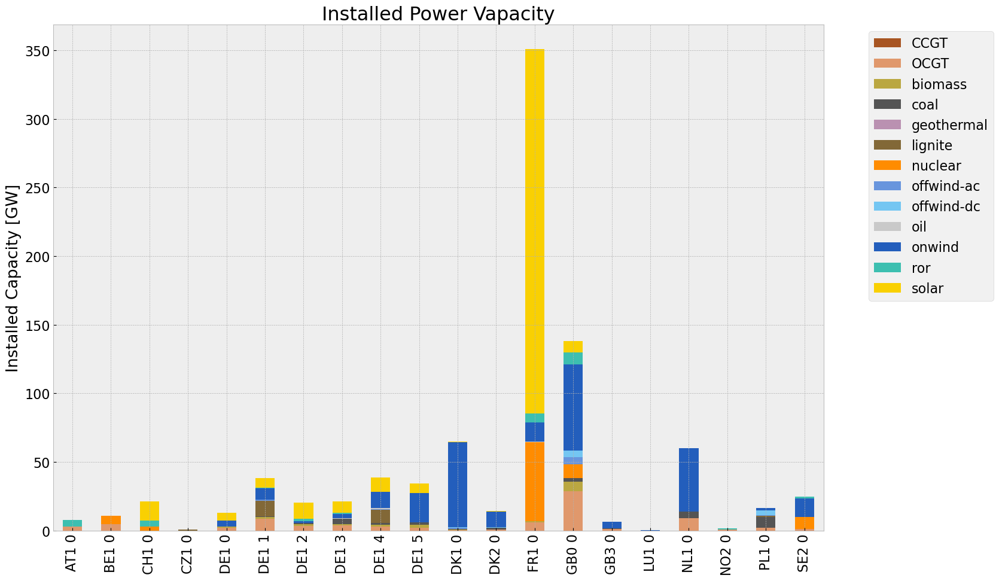

<Figure size 640x480 with 0 Axes>

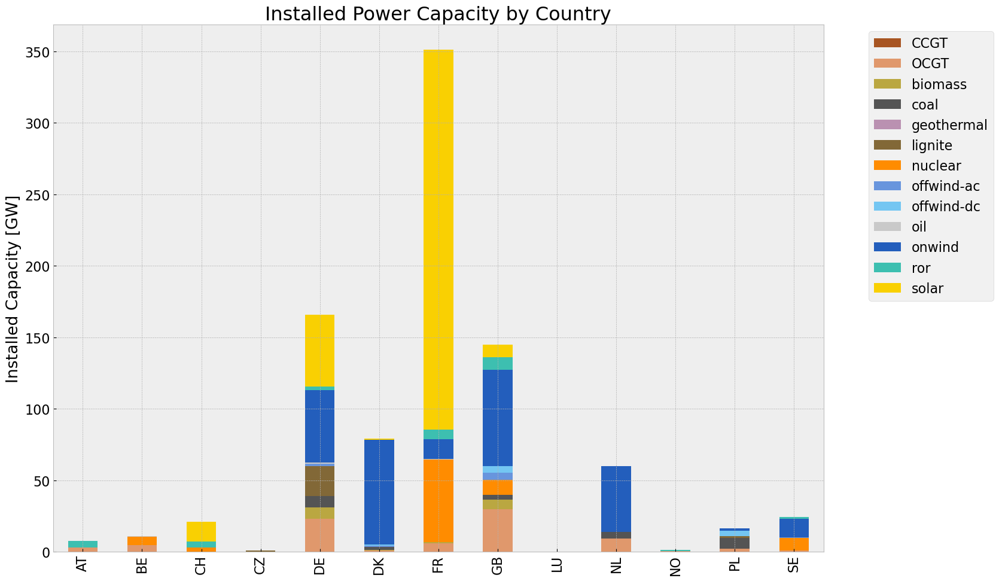

<Figure size 640x480 with 0 Axes>

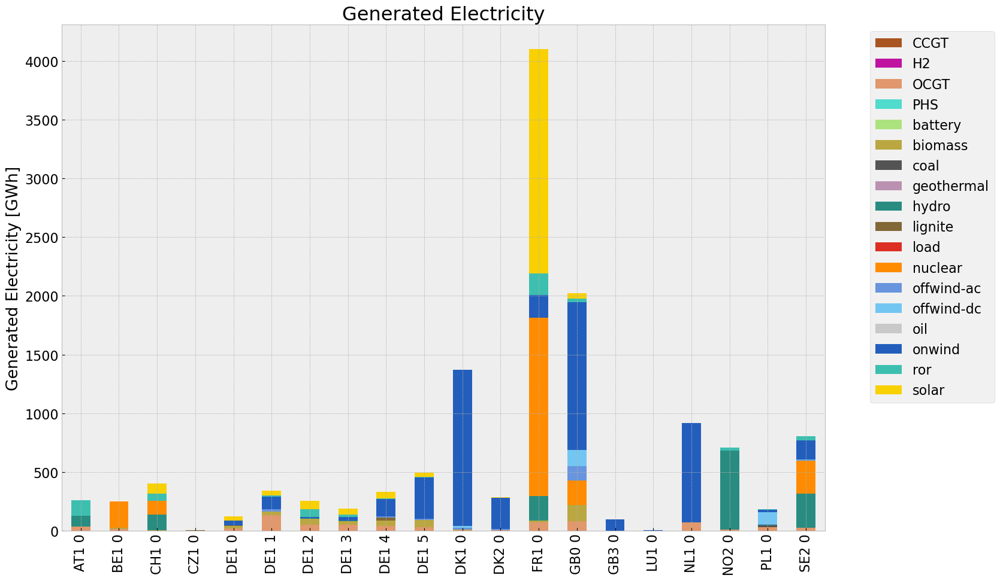

<Figure size 640x480 with 0 Axes>

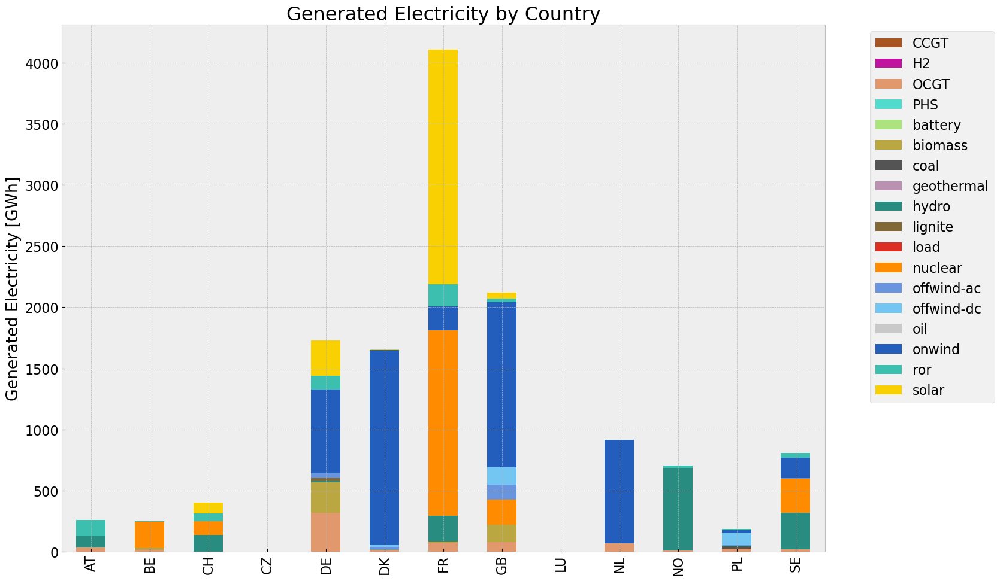

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.616121e+05,0.451621,0.1980,290064.564637
biomass,4.124516e+05,0.468000,0.0000,0.000000
coal,1.760208e+04,0.329908,0.3361,17932.445300
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.607613e+04,0.337285,0.4069,31458.222342
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.339853e+06,0.326600,0.0000,0.000000
offwind-ac,1.967836e+05,1.000000,0.0000,0.000000


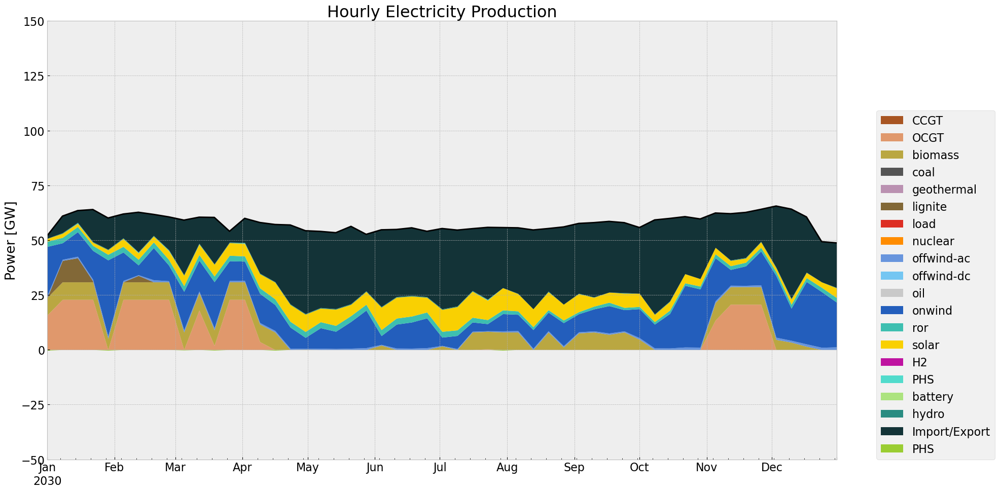

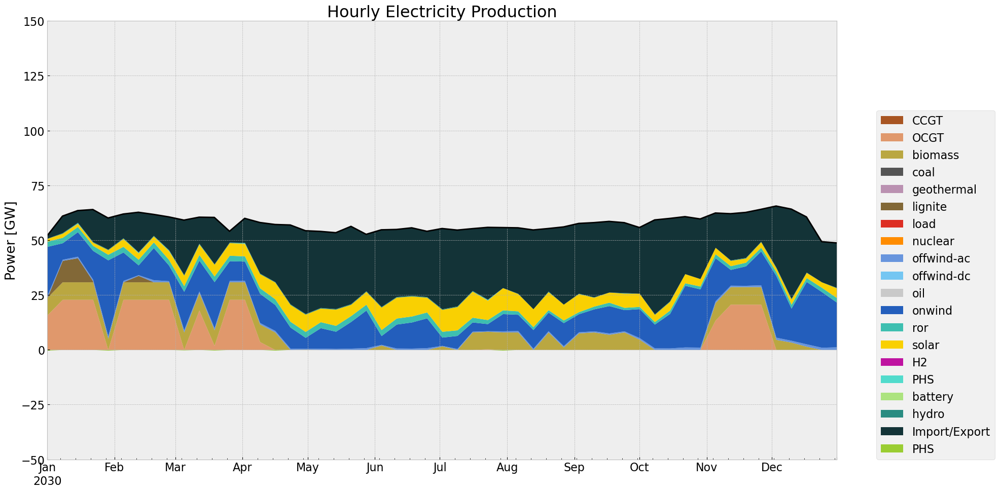

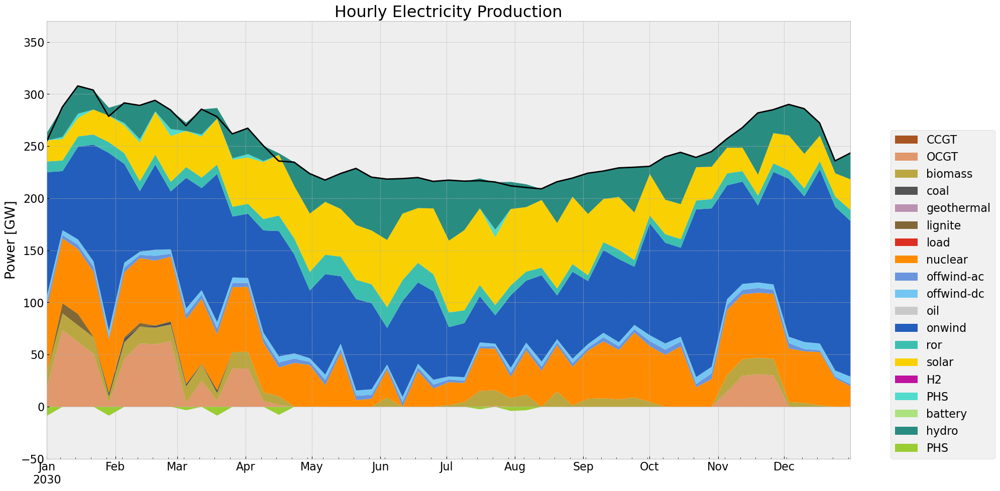

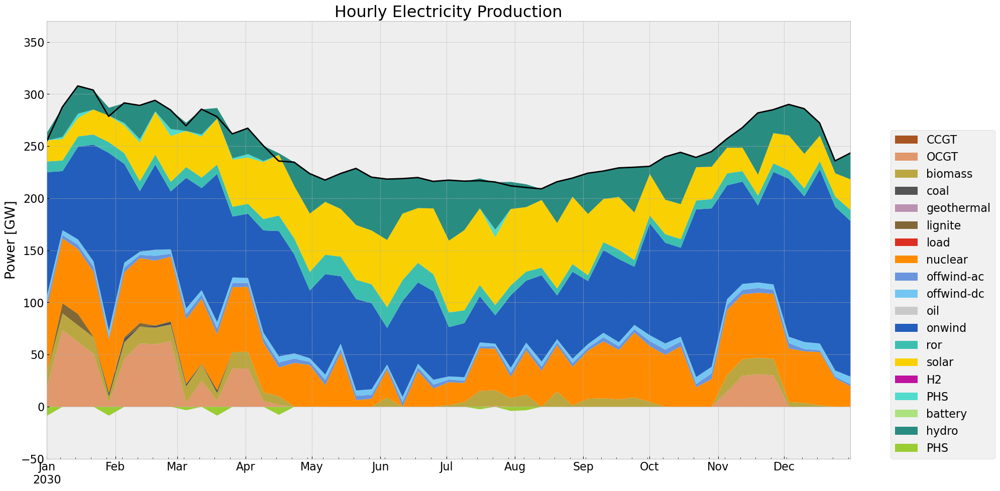

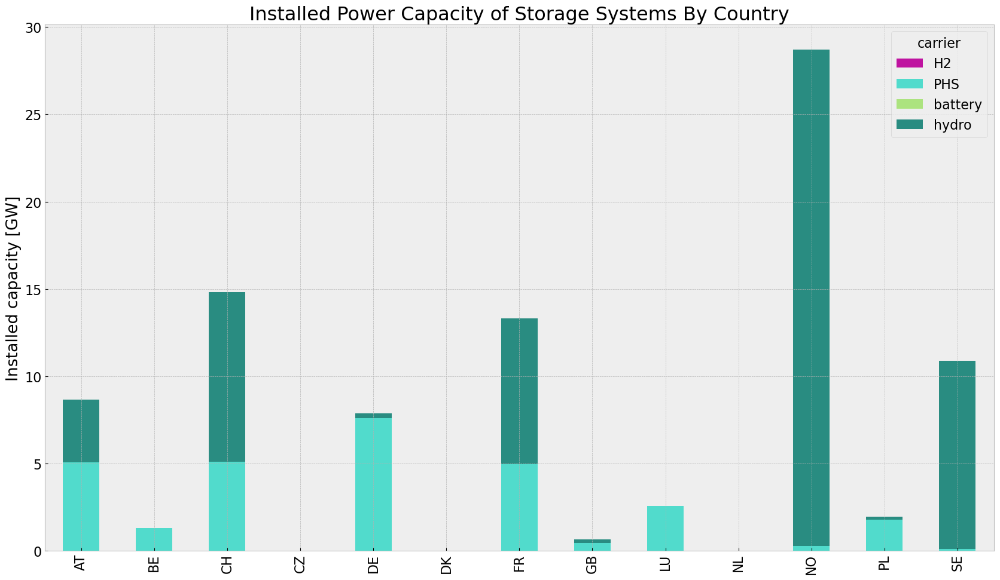

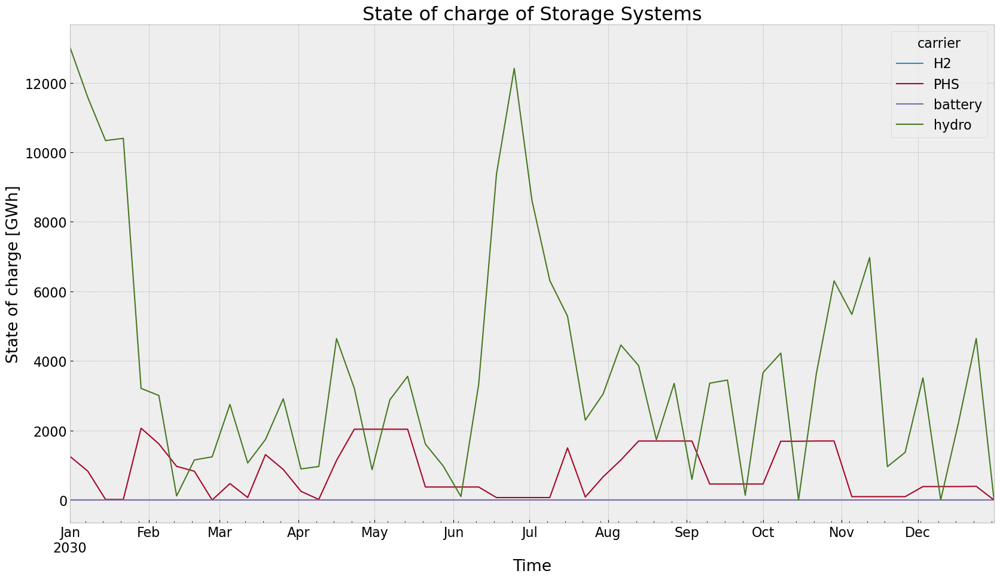

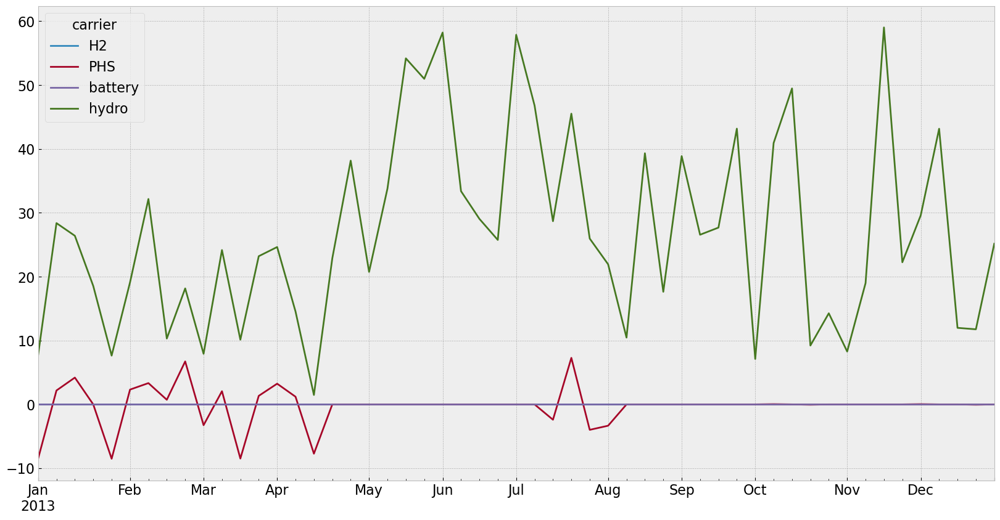

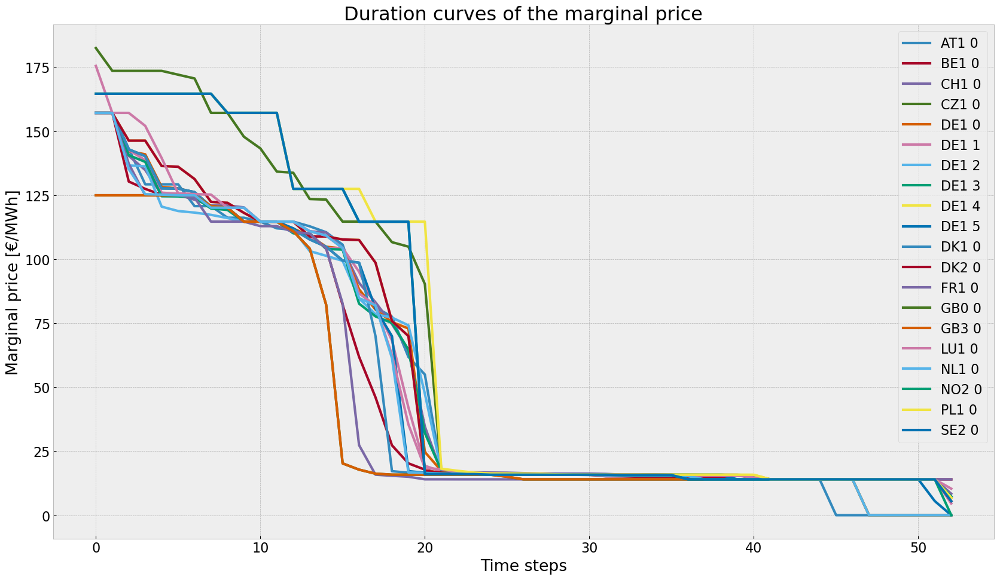

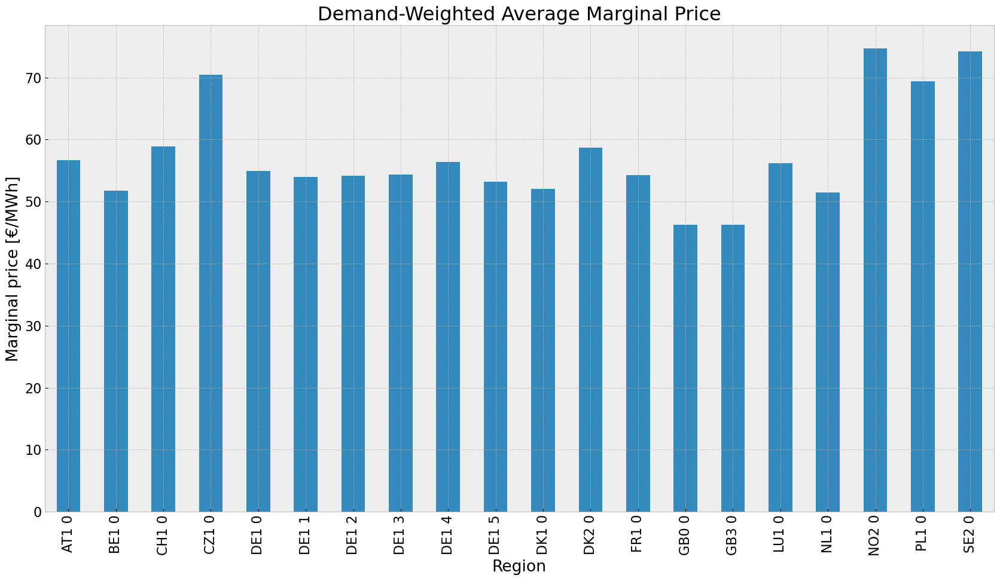

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


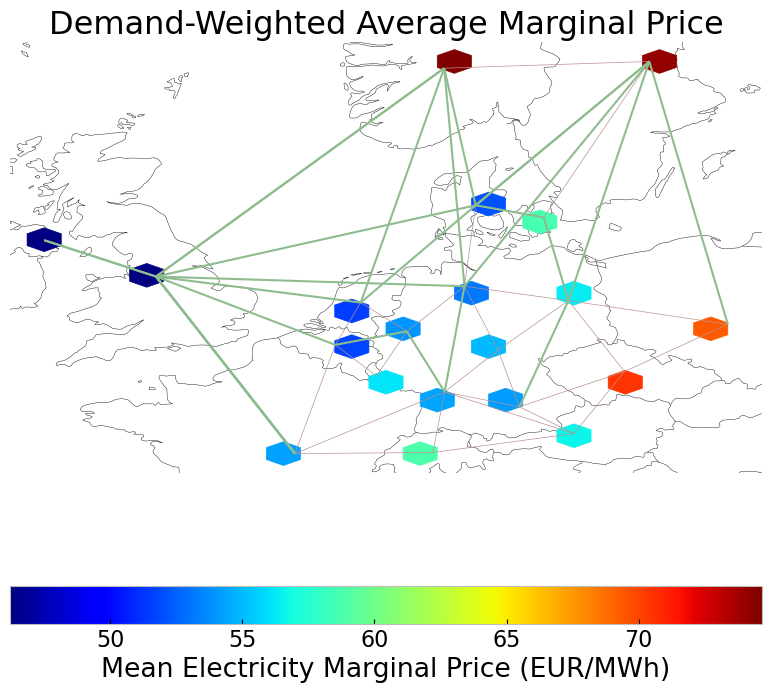

In [79]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

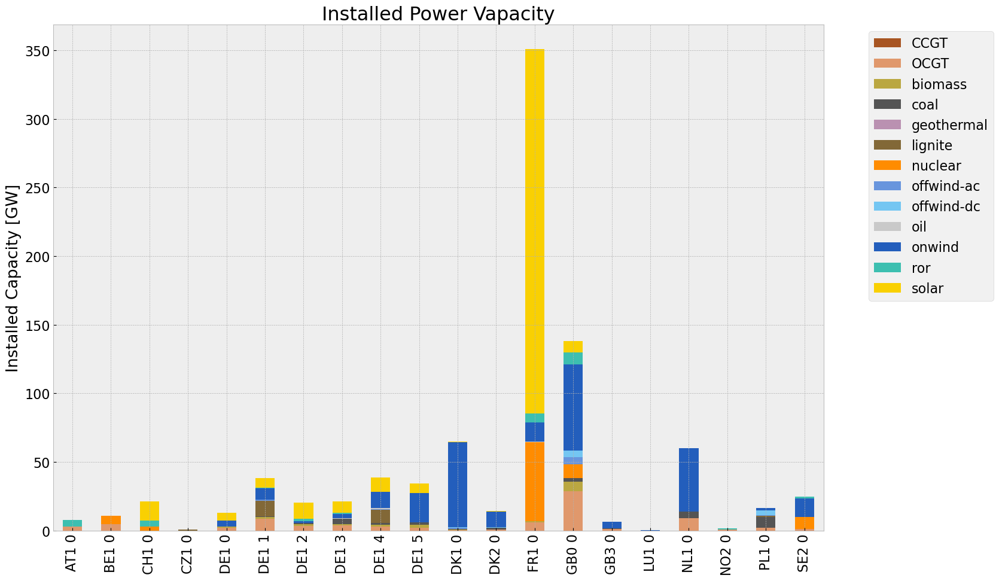

<Figure size 640x480 with 0 Axes>

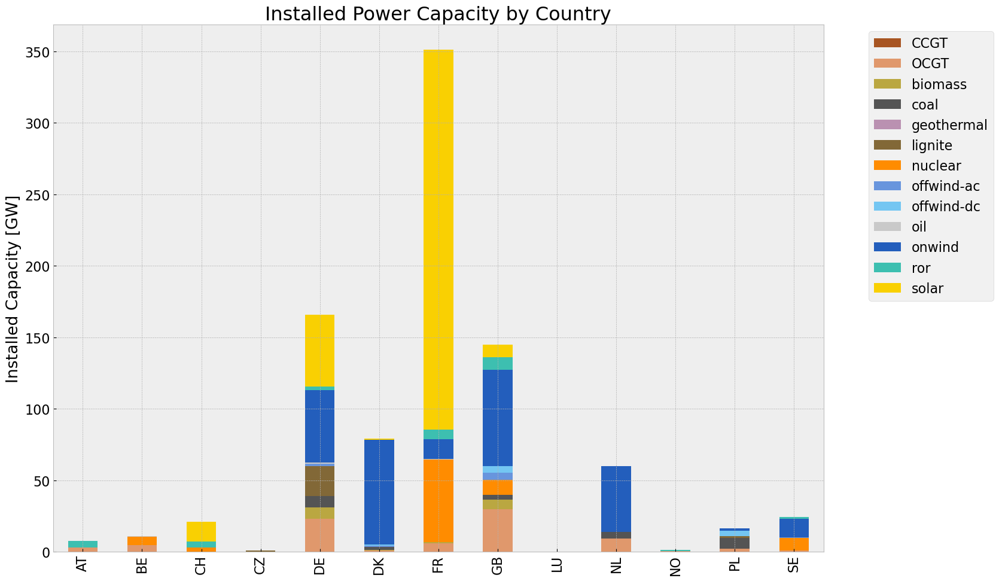

In [80]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

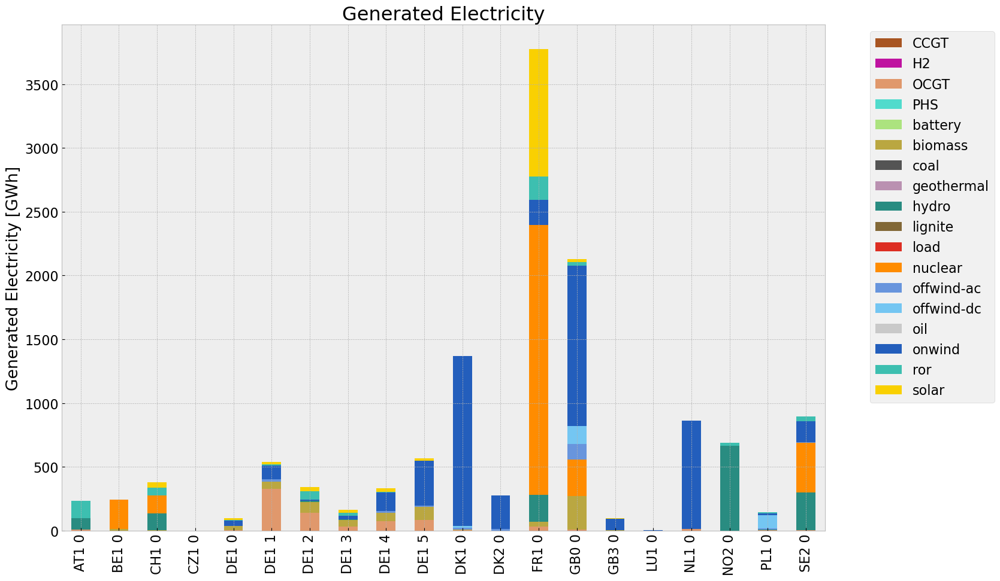

<Figure size 640x480 with 0 Axes>

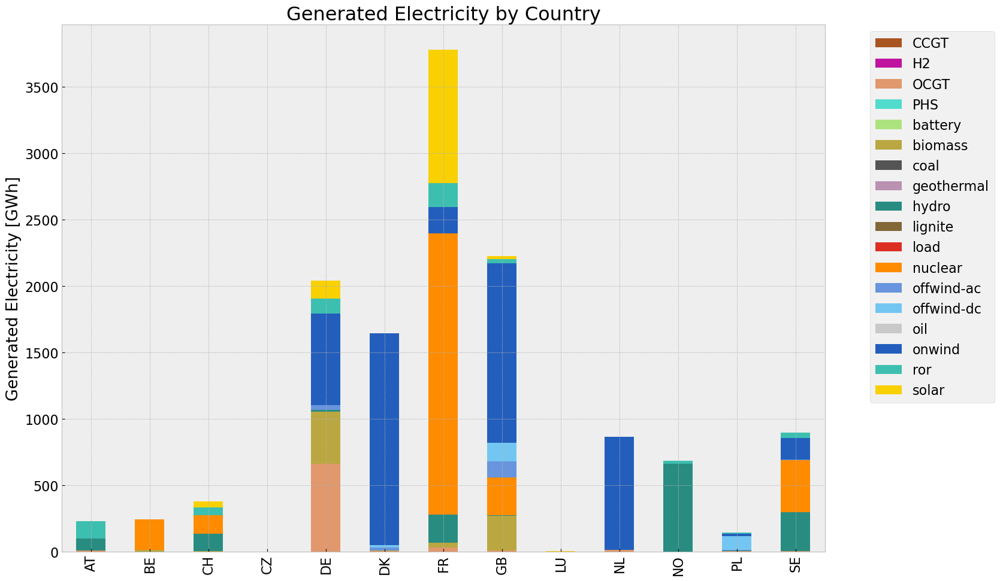

In [81]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2267199707.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2267199707.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).

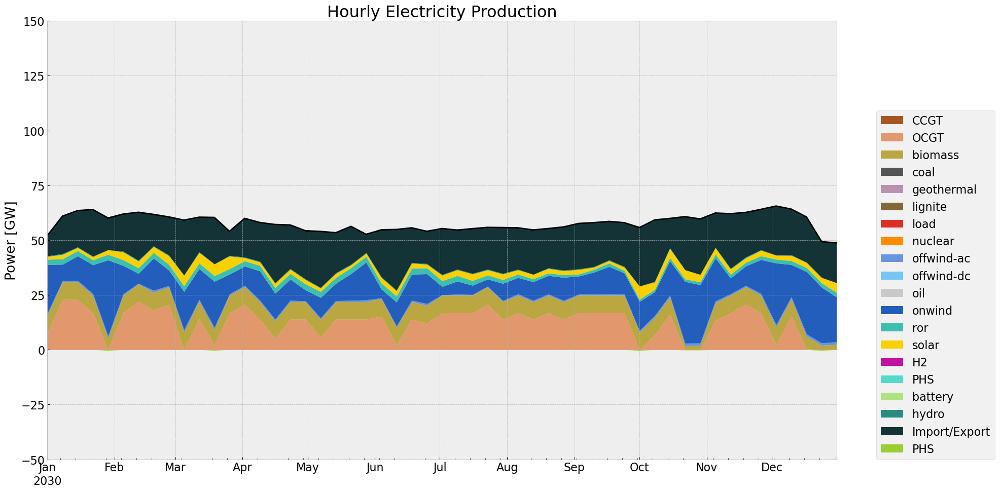

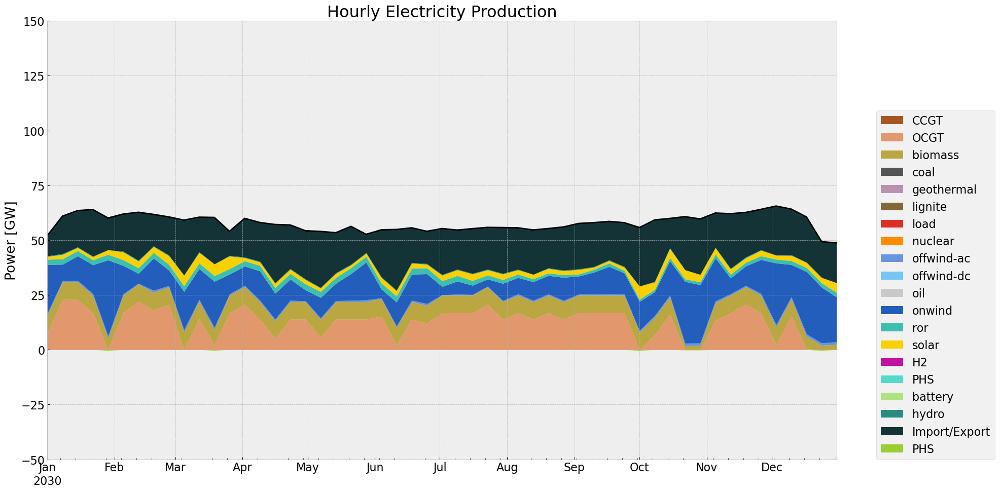

In [82]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

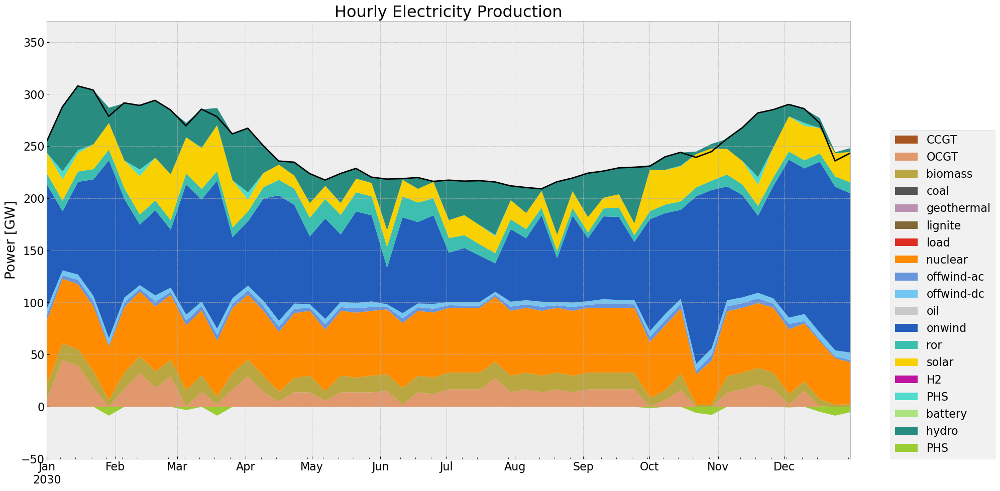

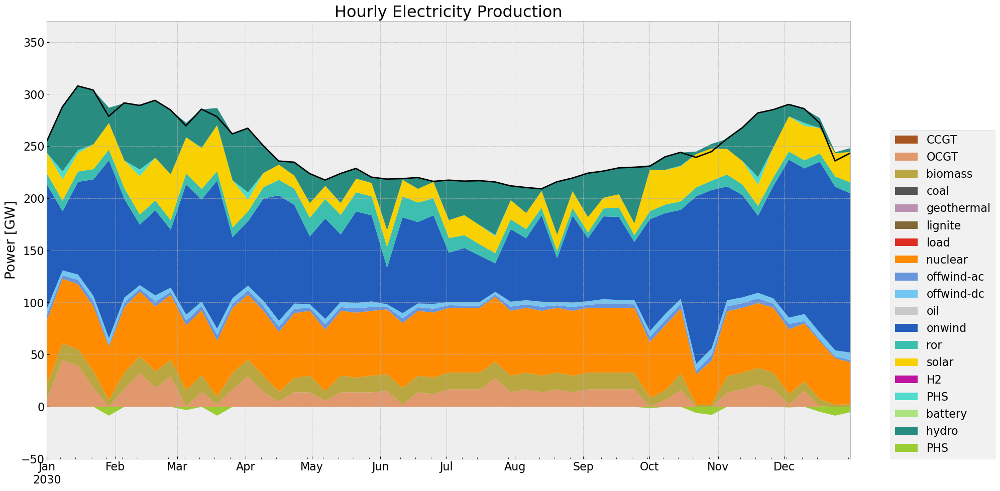

In [83]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

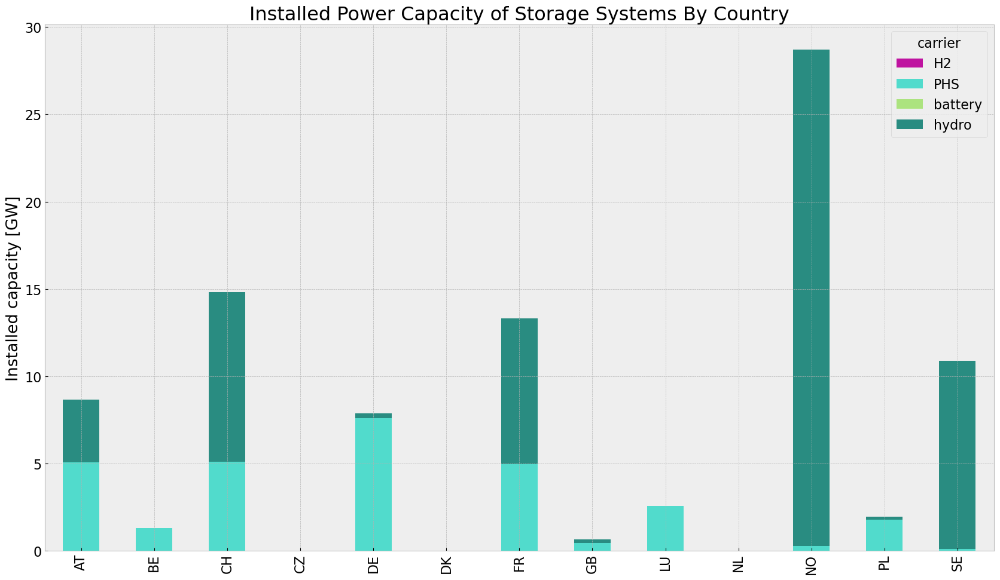

In [84]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carri

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,7.369408e+05,0.451621,0.1980,323090.221675
biomass,7.167957e+05,0.468000,0.0000,0.000000
coal,5.070653e+01,0.329908,0.3361,51.658232
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.329992e+02,0.337285,0.4069,160.450166
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,3.157980e+06,0.326600,0.0000,0.000000
offwind-ac,1.967836e+05,1.000000,0.0000,0.000000


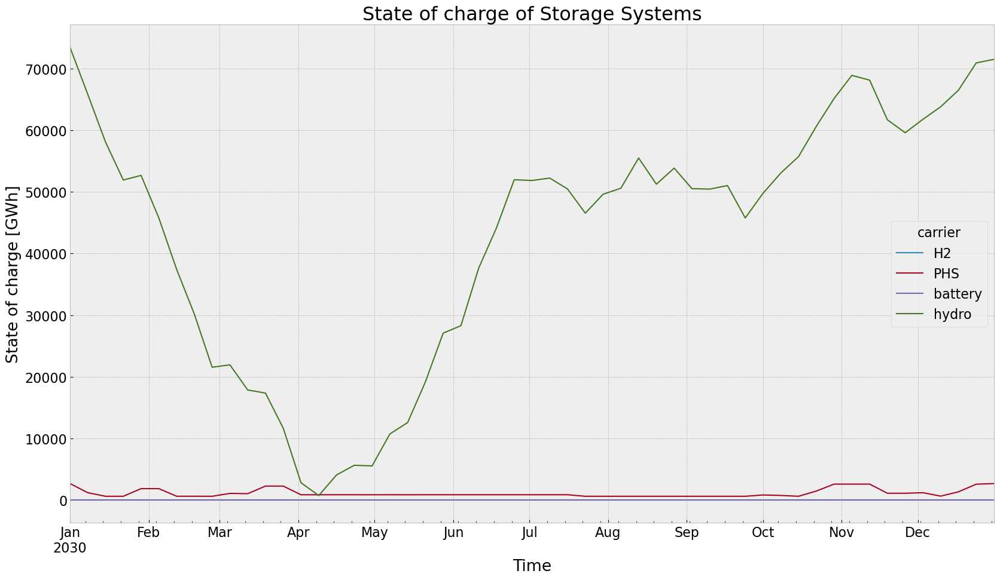

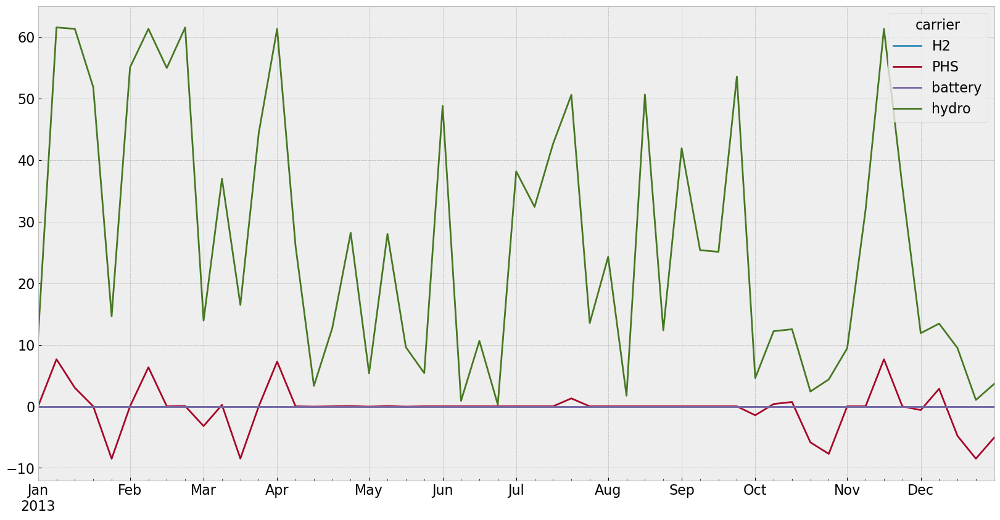

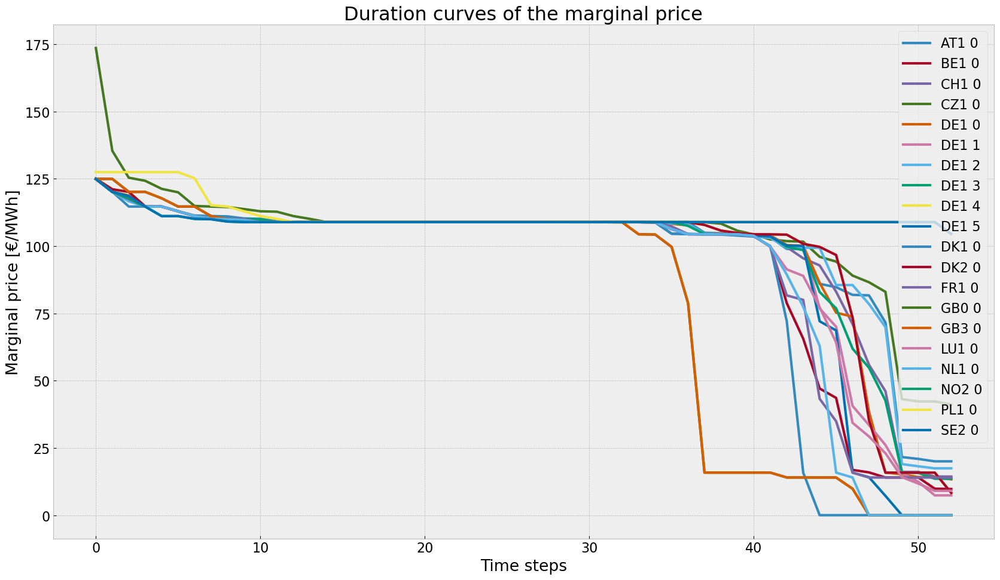

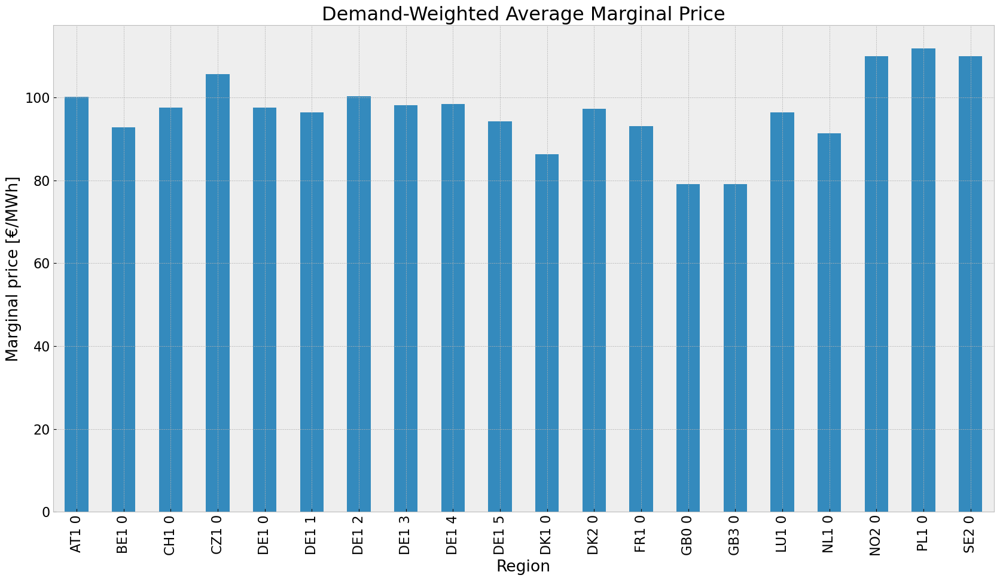

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


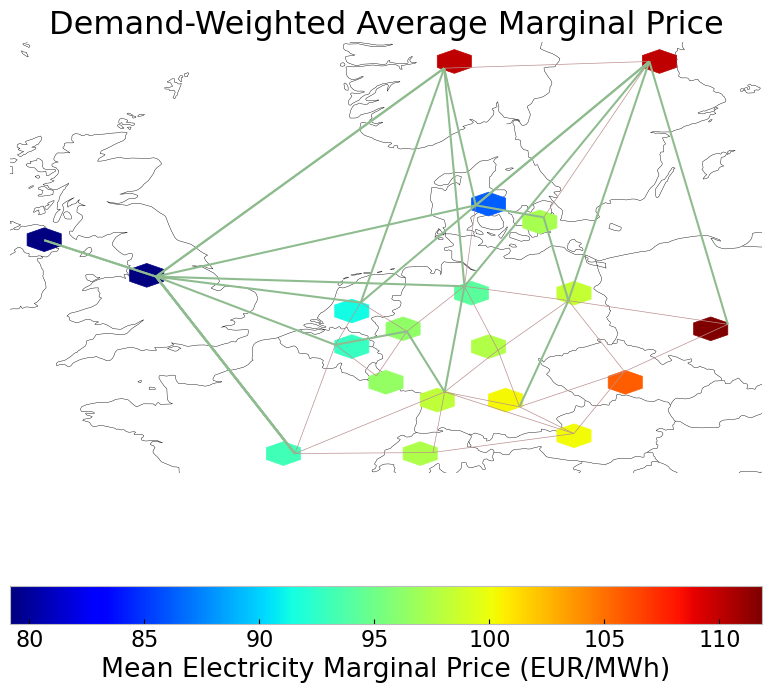

In [85]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [87]:
n3 = n2.copy()

n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpxgbdge.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpxgbdge.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xde36e4b3


INFO:gurobipy:Model fingerprint: 0xde36e4b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 938 columns, 1533 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1533 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5767799e+07   1.001295e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5767799e+07   1.001295e+06   0.000000e+00      0s


     283    5.2915342e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     283    5.2915342e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 283 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 283 iterations and 0.08 seconds (0.01 work units)


Optimal objective  5.291534175e+09


INFO:gurobipy:Optimal objective  5.291534175e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nglfuea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nglfuea.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xac346155


INFO:gurobipy:Model fingerprint: 0xac346155


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1146 columns


INFO:gurobipy:Presolve removed 4249 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 938 columns, 1532 nonzeros


INFO:gurobipy:Presolved: 223 rows, 938 columns, 1532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5741887e+07   9.889073e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5741887e+07   9.889073e+05   0.000000e+00      0s


     288    4.3845520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     288    4.3845520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 288 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 288 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.384551978e+09


INFO:gurobipy:Optimal objective  4.384551978e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2iv20w4x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2iv20w4x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x27cfa007


INFO:gurobipy:Model fingerprint: 0x27cfa007


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1149 columns


INFO:gurobipy:Presolve removed 4248 rows and 1149 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 935 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 935 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3343276e+07   9.776219e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3343276e+07   9.776219e+05   0.000000e+00      0s


     322    2.9999697e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     322    2.9999697e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 322 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 322 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.999969707e+09


INFO:gurobipy:Optimal objective  2.999969707e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gem_waj0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gem_waj0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x747ea72d


INFO:gurobipy:Model fingerprint: 0x747ea72d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1145 columns


INFO:gurobipy:Presolve removed 4255 rows and 1145 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 217 rows, 939 columns, 1522 nonzeros


INFO:gurobipy:Presolved: 217 rows, 939 columns, 1522 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.6462758e+03   1.001596e+06   0.000000e+00      0s


INFO:gurobipy:       0   -8.6462758e+03   1.001596e+06   0.000000e+00      0s


     260    3.7724014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    3.7724014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 260 iterations and 0.06 seconds (0.01 work units)


Optimal objective  3.772401410e+09


INFO:gurobipy:Optimal objective  3.772401410e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vl94z7k9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vl94z7k9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe69bf548


INFO:gurobipy:Model fingerprint: 0xe69bf548


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1135 columns


INFO:gurobipy:Presolve removed 4255 rows and 1135 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 949 columns, 1532 nonzeros


INFO:gurobipy:Presolved: 217 rows, 949 columns, 1532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8076552e+05   1.014659e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.8076552e+05   1.014659e+06   0.000000e+00      0s


     331    1.0718808e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     331    1.0718808e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 331 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 331 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.071880781e+09


INFO:gurobipy:Optimal objective  1.071880781e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.07e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh6qva93.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh6qva93.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x9bc961c6


INFO:gurobipy:Model fingerprint: 0x9bc961c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4265 rows and 1153 columns


INFO:gurobipy:Presolve removed 4265 rows and 1153 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 207 rows, 931 columns, 1496 nonzeros


INFO:gurobipy:Presolved: 207 rows, 931 columns, 1496 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5487851e+07   9.941205e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5487851e+07   9.941205e+05   0.000000e+00      0s


     304    6.1346344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     304    6.1346344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 304 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 304 iterations and 0.06 seconds (0.01 work units)


Optimal objective  6.134634375e+08


INFO:gurobipy:Optimal objective  6.134634375e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25yro20h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25yro20h.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x607c4158


INFO:gurobipy:Model fingerprint: 0x607c4158


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4251 rows and 1125 columns


INFO:gurobipy:Presolve removed 4251 rows and 1125 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 221 rows, 959 columns, 1551 nonzeros


INFO:gurobipy:Presolved: 221 rows, 959 columns, 1551 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5421995e+07   1.021074e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5421995e+07   1.021074e+06   0.000000e+00      0s


     398    7.1222380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     398    7.1222380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 398 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 398 iterations and 0.06 seconds (0.01 work units)


Optimal objective  7.122237955e+08


INFO:gurobipy:Optimal objective  7.122237955e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjyhat64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjyhat64.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x09ab21c1


INFO:gurobipy:Model fingerprint: 0x09ab21c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1130 columns


INFO:gurobipy:Presolve removed 4249 rows and 1130 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 954 columns, 1548 nonzeros


INFO:gurobipy:Presolved: 223 rows, 954 columns, 1548 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5519431e+07   9.872038e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5519431e+07   9.872038e+05   0.000000e+00      0s


     376    2.3135502e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     376    2.3135502e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 376 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 376 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.313550198e+09


INFO:gurobipy:Optimal objective  2.313550198e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.31e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hzvtjl7t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hzvtjl7t.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xee73bb38


INFO:gurobipy:Model fingerprint: 0xee73bb38


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1126 columns


INFO:gurobipy:Presolve removed 4249 rows and 1126 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 958 columns, 1552 nonzeros


INFO:gurobipy:Presolved: 223 rows, 958 columns, 1552 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6845533e+05   9.857677e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6845533e+05   9.857677e+05   0.000000e+00      0s


     310    1.8469809e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     310    1.8469809e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 310 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 310 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.846980882e+09


INFO:gurobipy:Optimal objective  1.846980882e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjpcy6af.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjpcy6af.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x51effb10


INFO:gurobipy:Model fingerprint: 0x51effb10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4250 rows and 1128 columns


INFO:gurobipy:Presolve removed 4250 rows and 1128 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 956 columns, 1549 nonzeros


INFO:gurobipy:Presolved: 222 rows, 956 columns, 1549 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6037038e+05   9.986124e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6037038e+05   9.986124e+05   0.000000e+00      0s


     315    2.0210022e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     315    2.0210022e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 315 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 315 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.021002162e+09


INFO:gurobipy:Optimal objective  2.021002162e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xazm1j0f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xazm1j0f.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x61aeac8a


INFO:gurobipy:Model fingerprint: 0x61aeac8a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1149 columns


INFO:gurobipy:Presolve removed 4248 rows and 1149 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 935 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 935 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5487342e+05   9.875533e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.5487342e+05   9.875533e+05   0.000000e+00      0s


     349    3.9625813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     349    3.9625813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 349 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 349 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.962581259e+08


INFO:gurobipy:Optimal objective  3.962581259e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-676vcd4r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-676vcd4r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x4d16e5eb


INFO:gurobipy:Model fingerprint: 0x4d16e5eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4249 rows and 1132 columns


INFO:gurobipy:Presolve removed 4249 rows and 1132 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 223 rows, 952 columns, 1546 nonzeros


INFO:gurobipy:Presolved: 223 rows, 952 columns, 1546 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.3674611e+04   9.560147e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.3674611e+04   9.560147e+05   0.000000e+00      0s


     301    2.6627749e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    2.6627749e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.662774922e+09


INFO:gurobipy:Optimal objective  2.662774922e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oz6c66bc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oz6c66bc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3016c0b4


INFO:gurobipy:Model fingerprint: 0x3016c0b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1184 columns


INFO:gurobipy:Presolve removed 4248 rows and 1184 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 900 columns, 1495 nonzeros


INFO:gurobipy:Presolved: 224 rows, 900 columns, 1495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.6412810e+04   9.901308e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.6412810e+04   9.901308e+05   0.000000e+00      0s


     359    5.2179310e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     359    5.2179310e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 359 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 359 iterations and 0.06 seconds (0.01 work units)


Optimal objective  5.217931008e+08


INFO:gurobipy:Optimal objective  5.217931008e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z0y9fa2o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z0y9fa2o.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x16e468fb


INFO:gurobipy:Model fingerprint: 0x16e468fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 319 columns


INFO:gurobipy:Presolve removed 1072 rows and 319 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 202 columns, 322 nonzeros


INFO:gurobipy:Presolved: 46 rows, 202 columns, 322 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0189587e+03   1.093440e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0189587e+03   1.093440e+05   0.000000e+00      0s


      45    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      45    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 45 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 45 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.757293423e+06


INFO:gurobipy:Optimal objective  6.757293423e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 6.76e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [88]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_pv.nc has lines, links, loads, carriers, buses, generators, global_constraints, storage_units


<xarray.Dataset> Size: 276kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      ...
                                                      storage_units_t_inflow_i: 10,
                                                      storage_units_t_p_i: 23,
                                                      storage_units_t_p_dispatch_i: 23,
                                                      storage_units_t_p_store_i: 13,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 5)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
    ...                                               ...
  * storage_units_t_inflow_i                         (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                              (storage_units_t_p_i) object 184B ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 184B ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 40B ...
Data variables: (12/102)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    storage_units_t_inflow                           (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                                (snapshots, storage_units_t_p_i) float64 10kB ...
    storage_units_t_p_dispatch                       (snapshots, storage_units_t_p_dispatch_i) float64 10kB ...
    storage_units_t_p_store                          (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge                  (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
    storage_units_t_spill                            (snapshots, storage_units_t_spill_i) float64 2kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_pv
    network_objective:       6757293.422799904
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [89]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

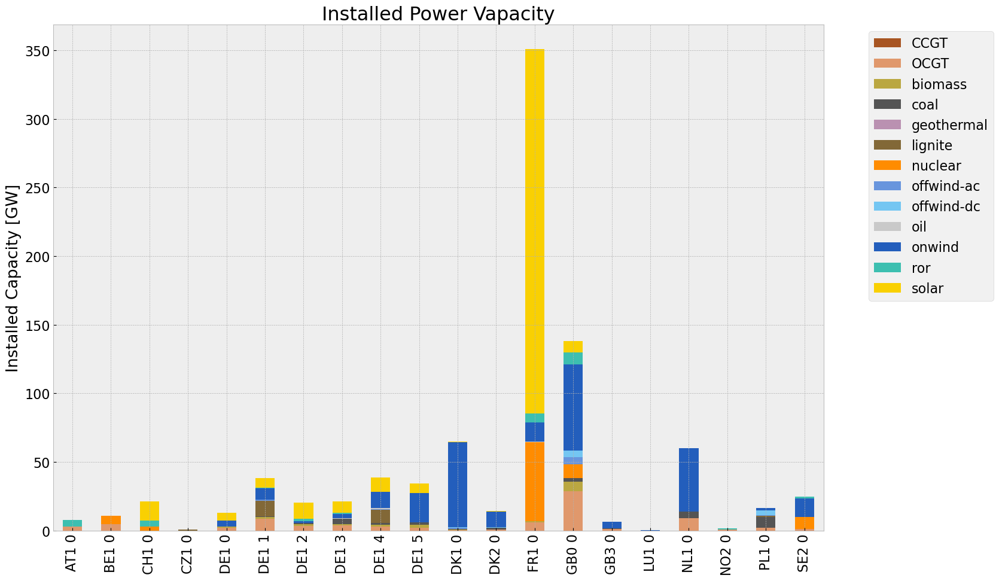

<Figure size 640x480 with 0 Axes>

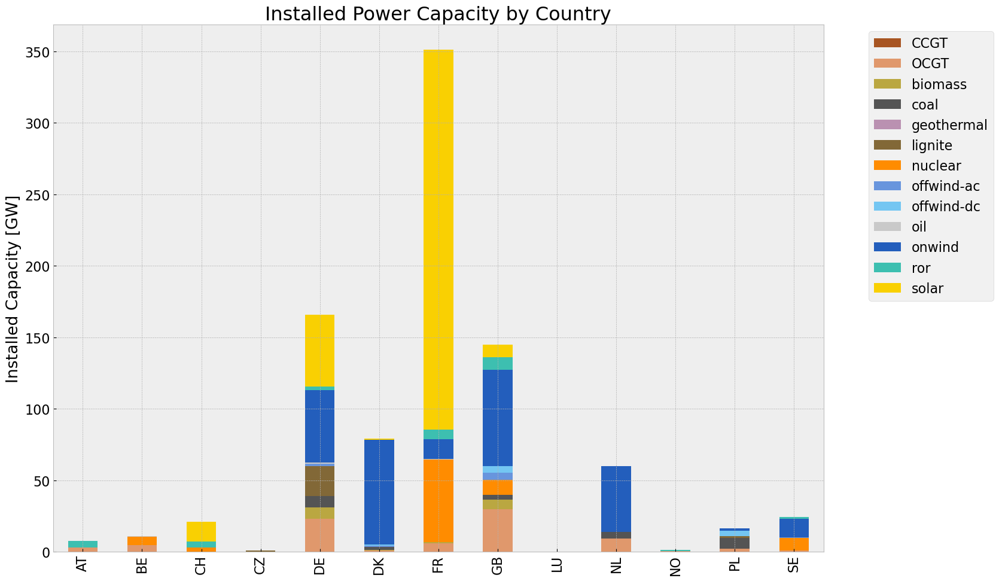

<Figure size 640x480 with 0 Axes>

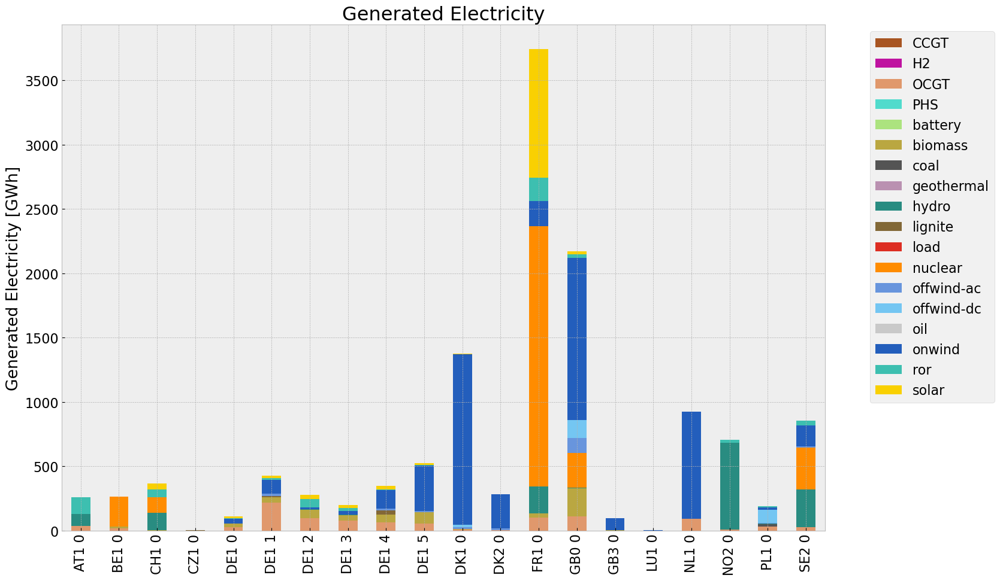

<Figure size 640x480 with 0 Axes>

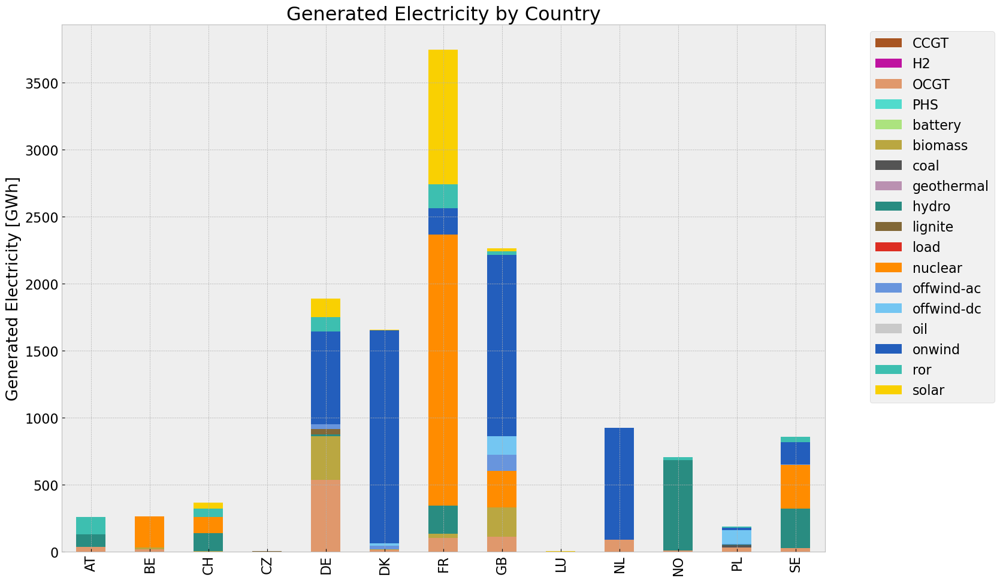

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,9.789206e+05,0.451621,0.1980,429179.237115
biomass,5.976348e+05,0.468000,0.0000,0.000000
coal,1.741090e+04,0.329908,0.3361,17737.686071
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,4.567045e+04,0.337285,0.4069,55096.791098
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.975089e+06,0.326600,0.0000,0.000000
offwind-ac,1.930274e+05,1.000000,0.0000,0.000000


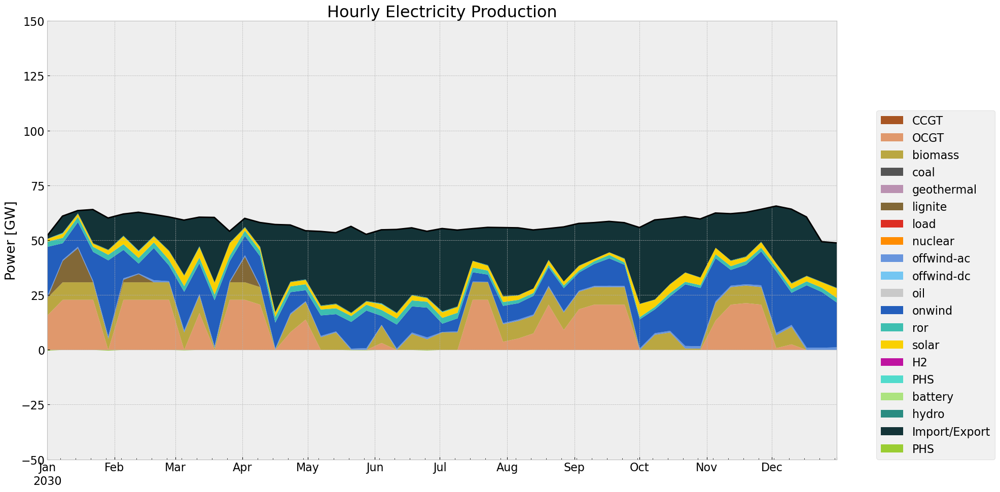

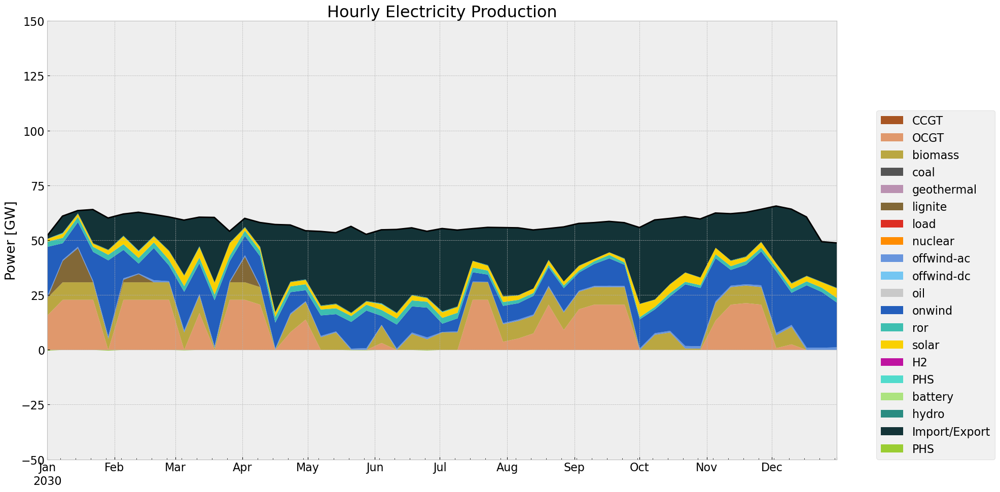

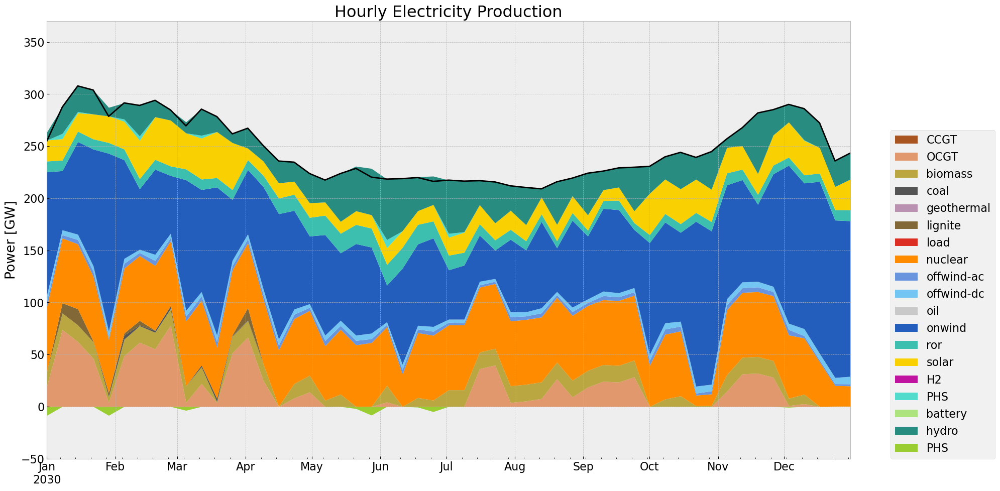

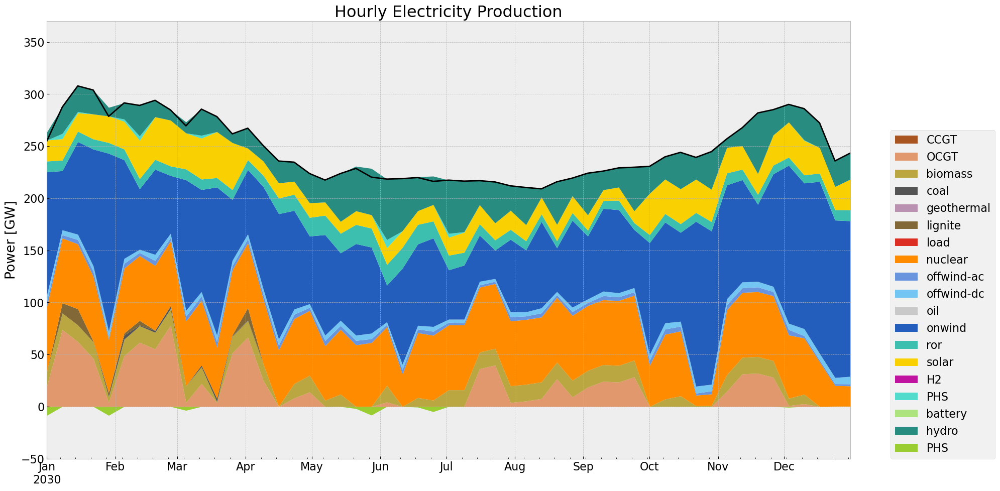

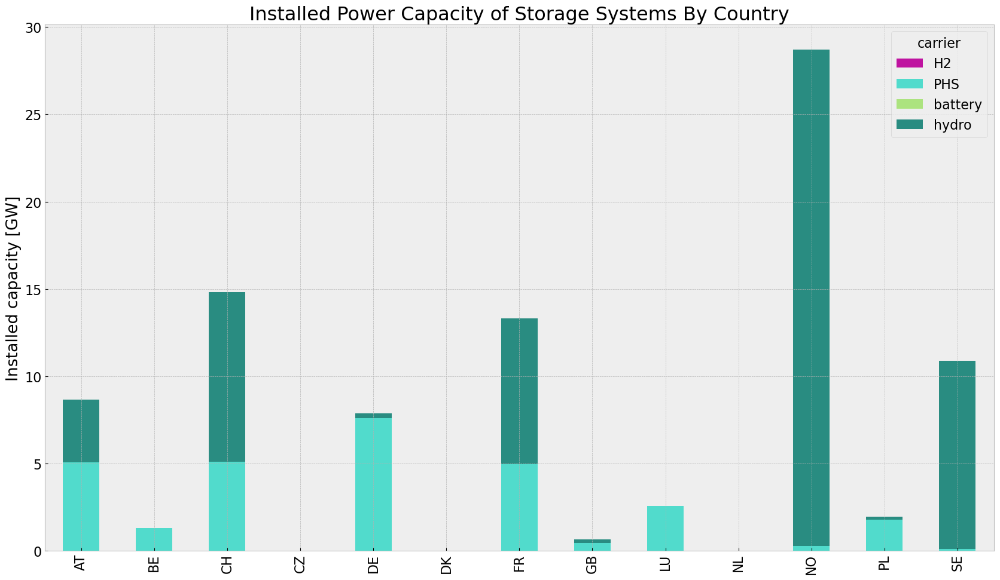

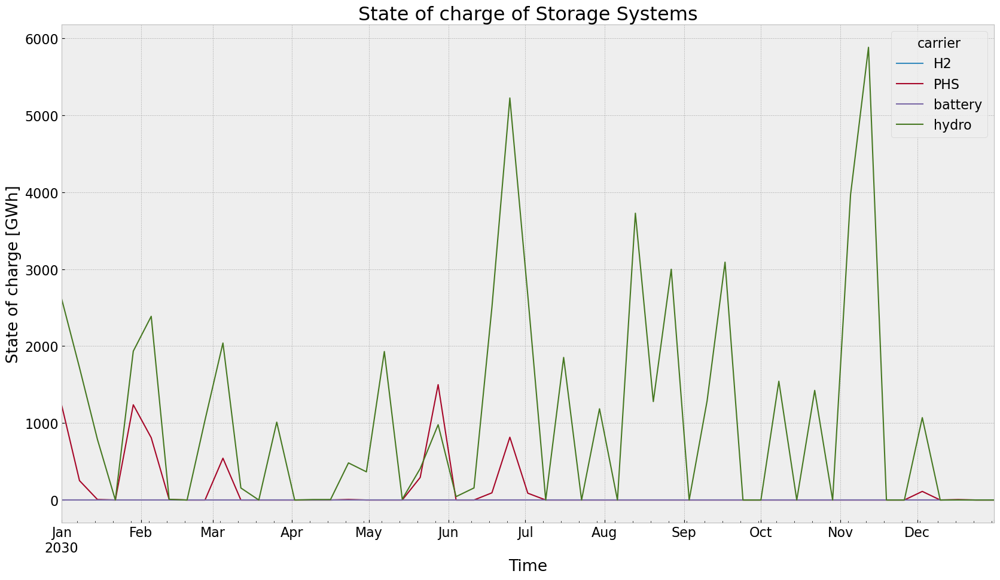

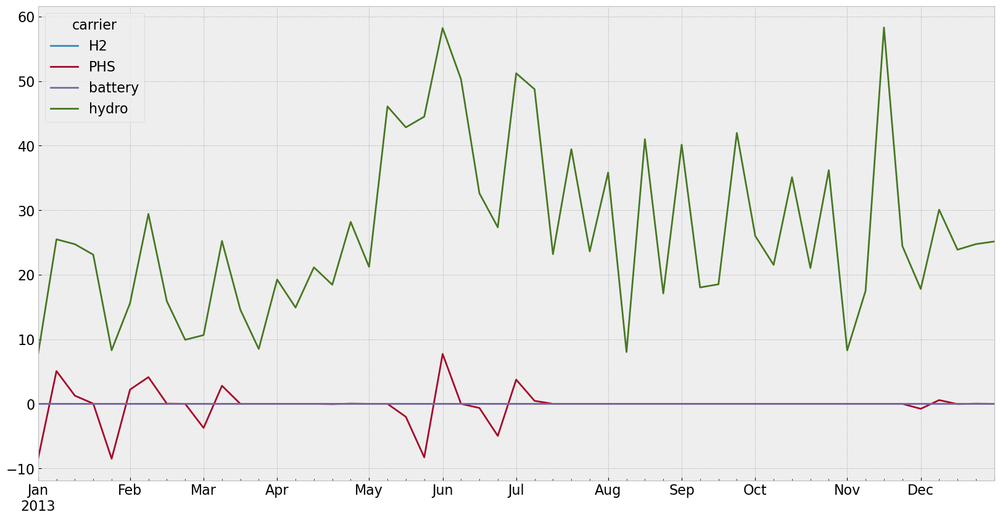

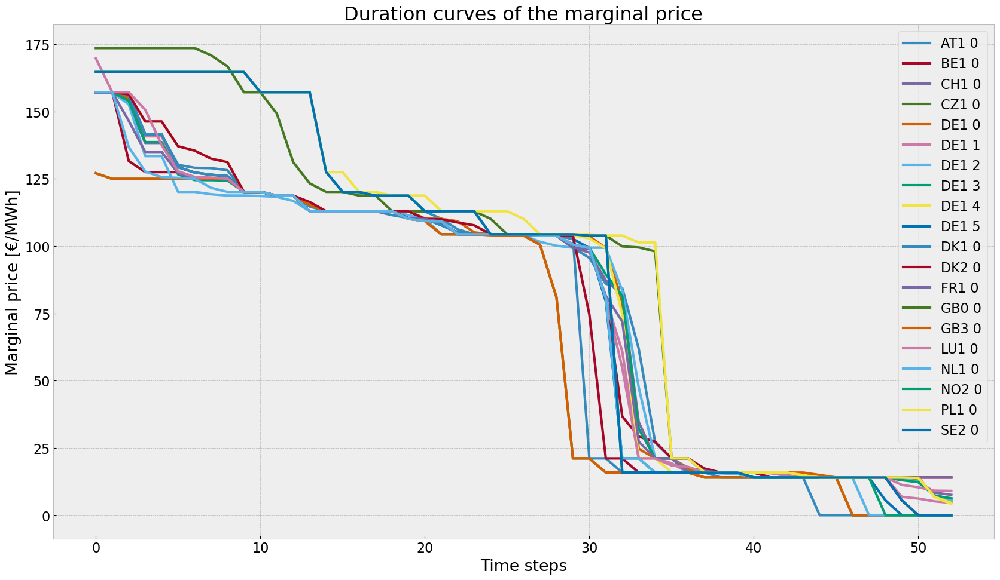

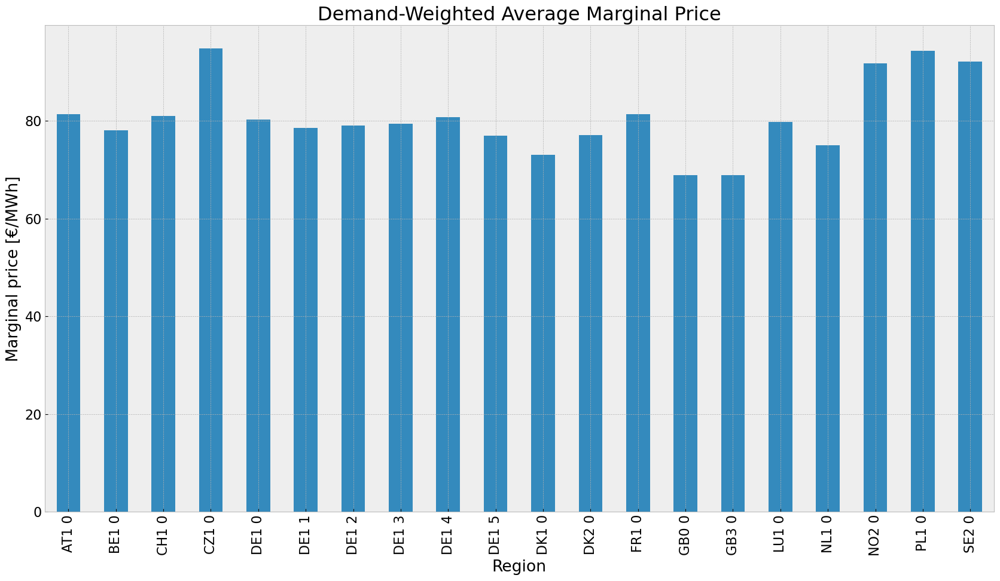

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


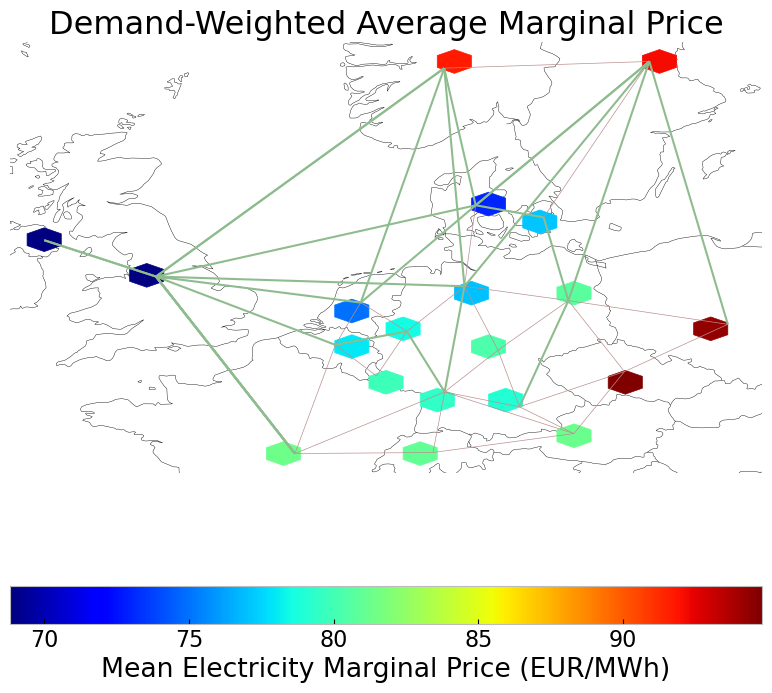

In [90]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [91]:
n4 = n1.copy()

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tx6fzzmn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tx6fzzmn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7a18f4fe


INFO:gurobipy:Model fingerprint: 0x7a18f4fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1130 columns


INFO:gurobipy:Presolve removed 4248 rows and 1130 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 954 columns, 1549 nonzeros


INFO:gurobipy:Presolved: 224 rows, 954 columns, 1549 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9660866e+05   1.064459e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.9660866e+05   1.064459e+06   0.000000e+00      0s


     313    3.9047986e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     313    3.9047986e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 313 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 313 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.904798560e+09


INFO:gurobipy:Optimal objective  3.904798560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zxi6z4bk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zxi6z4bk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x418541aa


INFO:gurobipy:Model fingerprint: 0x418541aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4252 rows and 1142 columns


INFO:gurobipy:Presolve removed 4252 rows and 1142 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 220 rows, 942 columns, 1527 nonzeros


INFO:gurobipy:Presolved: 220 rows, 942 columns, 1527 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3817074e+05   1.051333e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.3817074e+05   1.051333e+06   0.000000e+00      0s


     325    3.2525542e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     325    3.2525542e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 325 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 325 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.252554226e+09


INFO:gurobipy:Optimal objective  3.252554226e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0n2qt66v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0n2qt66v.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x9d6504c4


INFO:gurobipy:Model fingerprint: 0x9d6504c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1136 columns


INFO:gurobipy:Presolve removed 4248 rows and 1136 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 948 columns, 1543 nonzeros


INFO:gurobipy:Presolved: 224 rows, 948 columns, 1543 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.4987181e+05   1.044648e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.4987181e+05   1.044648e+06   0.000000e+00      0s


     335    2.1269328e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     335    2.1269328e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 335 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 335 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.126932818e+09


INFO:gurobipy:Optimal objective  2.126932818e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_jkucbey.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_jkucbey.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x8a32e32b


INFO:gurobipy:Model fingerprint: 0x8a32e32b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1135 columns


INFO:gurobipy:Presolve removed 4255 rows and 1135 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 949 columns, 1532 nonzeros


INFO:gurobipy:Presolved: 217 rows, 949 columns, 1532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.0993509e+05   1.070547e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.0993509e+05   1.070547e+06   0.000000e+00      0s


     283    2.9709200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     283    2.9709200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 283 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 283 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.970920020e+09


INFO:gurobipy:Optimal objective  2.970920020e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-buzks1bz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-buzks1bz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x34acf01e


INFO:gurobipy:Model fingerprint: 0x34acf01e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1130 columns


INFO:gurobipy:Presolve removed 4255 rows and 1130 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 954 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 217 rows, 954 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6954414e+05   1.081418e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.6954414e+05   1.081418e+06   0.000000e+00      0s


     333    5.9792362e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     333    5.9792362e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 333 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 333 iterations and 0.05 seconds (0.01 work units)


Optimal objective  5.979236244e+08


INFO:gurobipy:Optimal objective  5.979236244e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00i6zno_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00i6zno_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x4335262f


INFO:gurobipy:Model fingerprint: 0x4335262f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4265 rows and 1141 columns


INFO:gurobipy:Presolve removed 4265 rows and 1141 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 207 rows, 943 columns, 1508 nonzeros


INFO:gurobipy:Presolved: 207 rows, 943 columns, 1508 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.9692452e+05   1.065884e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.9692452e+05   1.065884e+06   0.000000e+00      0s


     301    4.4013194e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    4.4013194e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.06 seconds (0.01 work units)


Optimal objective  4.401319447e+08


INFO:gurobipy:Optimal objective  4.401319447e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8kzr4zaj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8kzr4zaj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x76097277


INFO:gurobipy:Model fingerprint: 0x76097277


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4251 rows and 1114 columns


INFO:gurobipy:Presolve removed 4251 rows and 1114 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 221 rows, 970 columns, 1562 nonzeros


INFO:gurobipy:Presolved: 221 rows, 970 columns, 1562 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.0334898e+05   1.087748e+06   0.000000e+00      0s


INFO:gurobipy:       0   -4.0334898e+05   1.087748e+06   0.000000e+00      0s


     383    6.1112125e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     383    6.1112125e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 383 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 383 iterations and 0.05 seconds (0.01 work units)


Optimal objective  6.111212456e+08


INFO:gurobipy:Optimal objective  6.111212456e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ny7p4bz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ny7p4bz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x953be4d3


INFO:gurobipy:Model fingerprint: 0x953be4d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1114 columns


INFO:gurobipy:Presolve removed 4249 rows and 1114 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 970 columns, 1564 nonzeros


INFO:gurobipy:Presolved: 223 rows, 970 columns, 1564 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.1430069e+05   1.059810e+06   0.000000e+00      0s


INFO:gurobipy:       0   -4.1430069e+05   1.059810e+06   0.000000e+00      0s


     323    1.9446768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     323    1.9446768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 323 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 323 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.944676847e+09


INFO:gurobipy:Optimal objective  1.944676847e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='o

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to4rnk8t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to4rnk8t.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x90177446


INFO:gurobipy:Model fingerprint: 0x90177446


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1114 columns


INFO:gurobipy:Presolve removed 4249 rows and 1114 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 223 rows, 970 columns, 1564 nonzeros


INFO:gurobipy:Presolved: 223 rows, 970 columns, 1564 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.1464878e+05   1.057472e+06   0.000000e+00      0s


INFO:gurobipy:       0   -4.1464878e+05   1.057472e+06   0.000000e+00      0s


     338    1.0752285e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     338    1.0752285e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 338 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 338 iterations and 0.06 seconds (0.01 work units)


Optimal objective  1.075228463e+09


INFO:gurobipy:Optimal objective  1.075228463e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9c641rae.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9c641rae.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x30576528


INFO:gurobipy:Model fingerprint: 0x30576528


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4250 rows and 1124 columns


INFO:gurobipy:Presolve removed 4250 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 960 columns, 1553 nonzeros


INFO:gurobipy:Presolved: 222 rows, 960 columns, 1553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.4161394e+05   1.063228e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.4161394e+05   1.063228e+06   0.000000e+00      0s


     321    1.2956021e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     321    1.2956021e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 321 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 321 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.295602143e+09


INFO:gurobipy:Optimal objective  1.295602143e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xwma4lv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xwma4lv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x272186be


INFO:gurobipy:Model fingerprint: 0x272186be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 945 columns, 1540 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1540 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.9870738e+05   1.060568e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.9870738e+05   1.060568e+06   0.000000e+00      0s


     404    2.6222092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     404    2.6222092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 404 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 404 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.622209235e+08


INFO:gurobipy:Optimal objective  2.622209235e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spwot4re.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spwot4re.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x1a2e7174


INFO:gurobipy:Model fingerprint: 0x1a2e7174


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4249 rows and 1124 columns


INFO:gurobipy:Presolve removed 4249 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 960 columns, 1554 nonzeros


INFO:gurobipy:Presolved: 223 rows, 960 columns, 1554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.0206501e+05   1.024555e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.0206501e+05   1.024555e+06   0.000000e+00      0s


     342    1.5218234e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     342    1.5218234e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 342 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 342 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.521823365e+09


INFO:gurobipy:Optimal objective  1.521823365e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p49h25p5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p49h25p5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0a6eff6e


INFO:gurobipy:Model fingerprint: 0x0a6eff6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1191 columns


INFO:gurobipy:Presolve removed 4254 rows and 1191 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 893 columns, 1470 nonzeros


INFO:gurobipy:Presolved: 218 rows, 893 columns, 1470 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2783458e+05   1.056954e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.2783458e+05   1.056954e+06   0.000000e+00      0s


     306    3.2934686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     306    3.2934686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 306 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 306 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.293468644e+08


INFO:gurobipy:Optimal objective  3.293468644e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['24'], dtype='object', name='Line')
Index(['DK1 0 onwind', 'NL1 0 onwind', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['24'], dtype='

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2hh1jyq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2hh1jyq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xf12f8527


INFO:gurobipy:Model fingerprint: 0xf12f8527


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1075 rows and 329 columns


INFO:gurobipy:Presolve removed 1075 rows and 329 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 43 rows, 192 columns, 305 nonzeros


INFO:gurobipy:Presolved: 43 rows, 192 columns, 305 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3929507e+03   1.139456e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3929507e+03   1.139456e+05   0.000000e+00      0s


      42    2.8651297e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    2.8651297e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.865129717e+06


INFO:gurobipy:Optimal objective  2.865129717e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 2.87e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [92]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv.nc has lines, links, loads, carriers, buses, generators, storage_units


<xarray.Dataset> Size: 273kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      ...
                                                      storage_units_t_inflow_i: 10,
                                                      storage_units_t_p_i: 23,
                                                      storage_units_t_p_dispatch_i: 23,
                                                      storage_units_t_p_store_i: 13,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 5)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
    ...                                               ...
  * storage_units_t_inflow_i                         (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                              (storage_units_t_p_i) object 184B ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 184B ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 40B ...
Data variables: (12/97)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    storage_units_t_inflow                           (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                                (snapshots, storage_units_t_p_i) float64 10kB ...
    storage_units_t_p_dispatch                       (snapshots, storage_units_t_p_dispatch_i) float64 10kB ...
    storage_units_t_p_store                          (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge                  (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
    storage_units_t_spill                            (snapshots, storage_units_t_spill_i) float64 2kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       2865129.7167972913
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [93]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

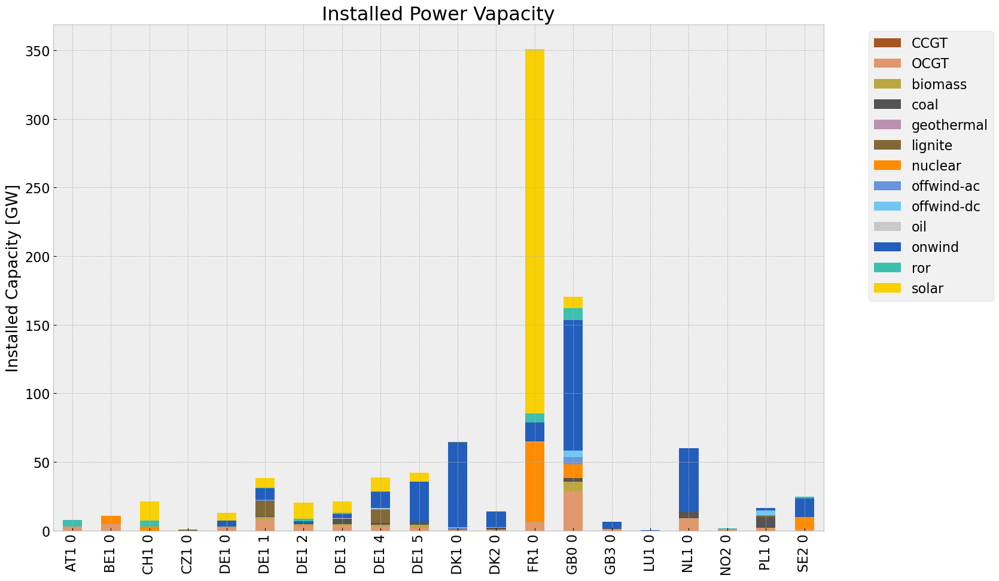

<Figure size 640x480 with 0 Axes>

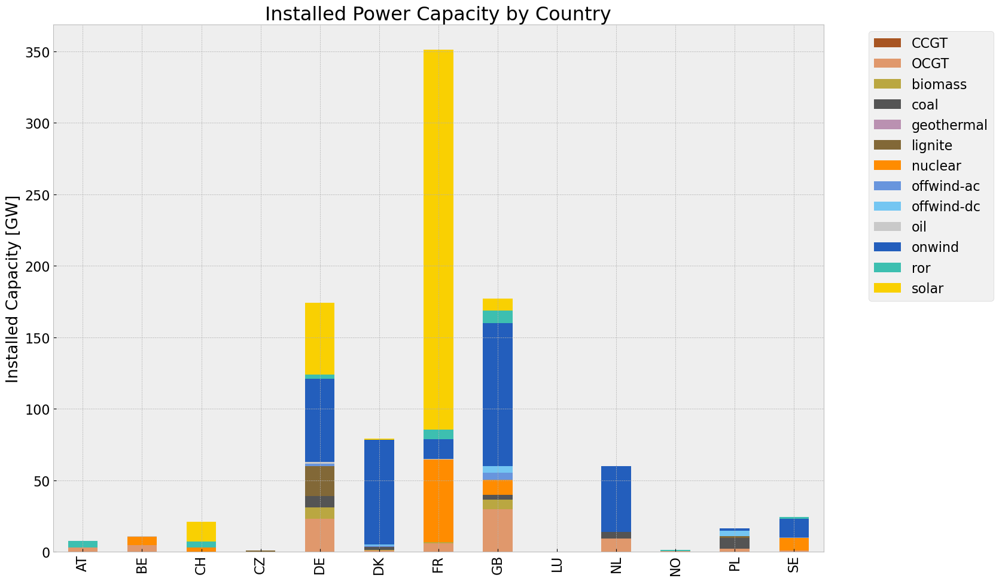

<Figure size 640x480 with 0 Axes>

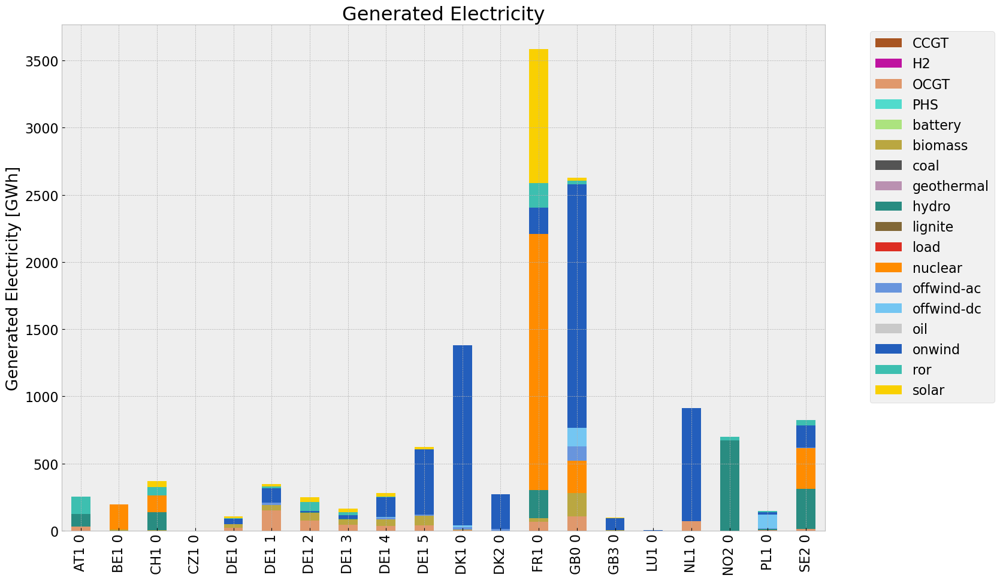

<Figure size 640x480 with 0 Axes>

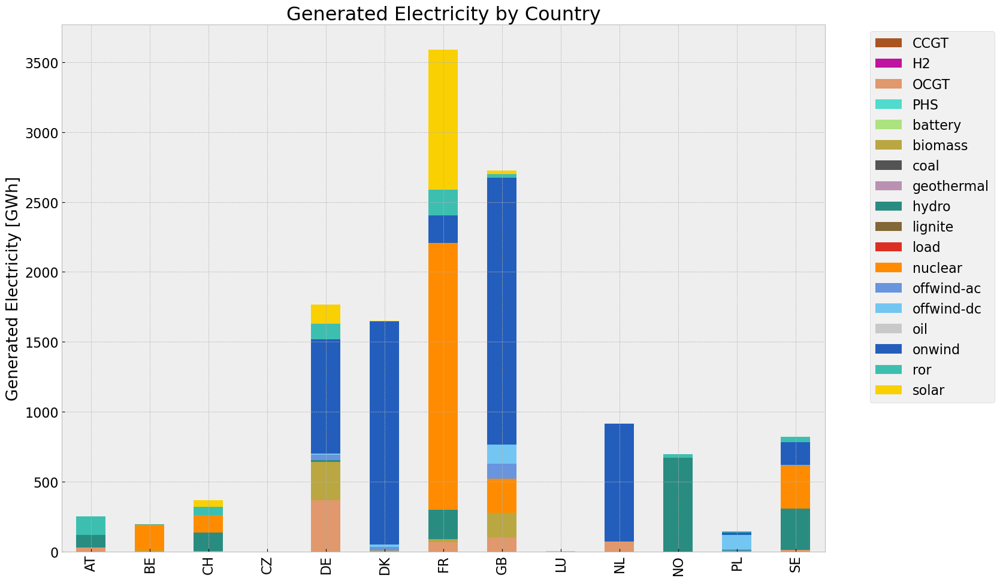

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.677466e+05,0.451621,0.1980,292754.035946
biomass,4.915213e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329908,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,0.000000e+00,0.337285,0.4069,0.000000
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.758245e+06,0.326600,0.0000,0.000000
offwind-ac,1.812960e+05,1.000000,0.0000,0.000000


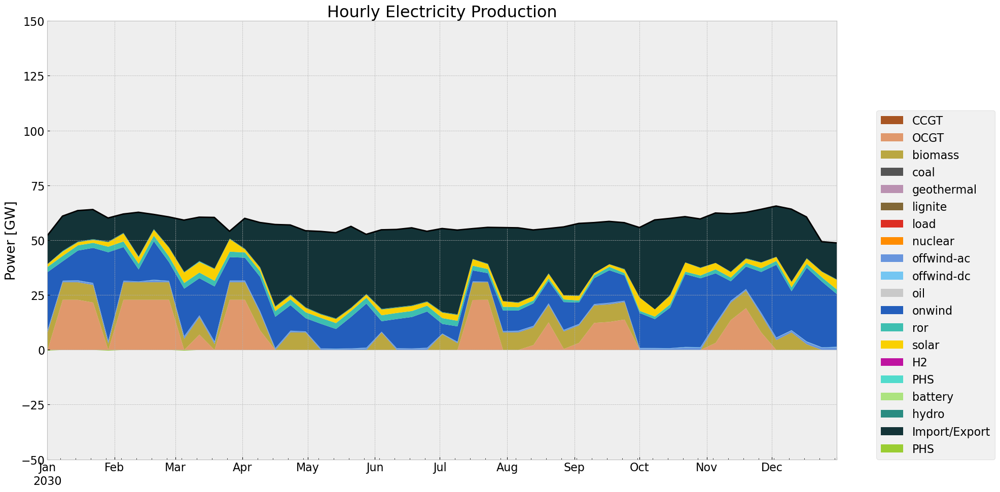

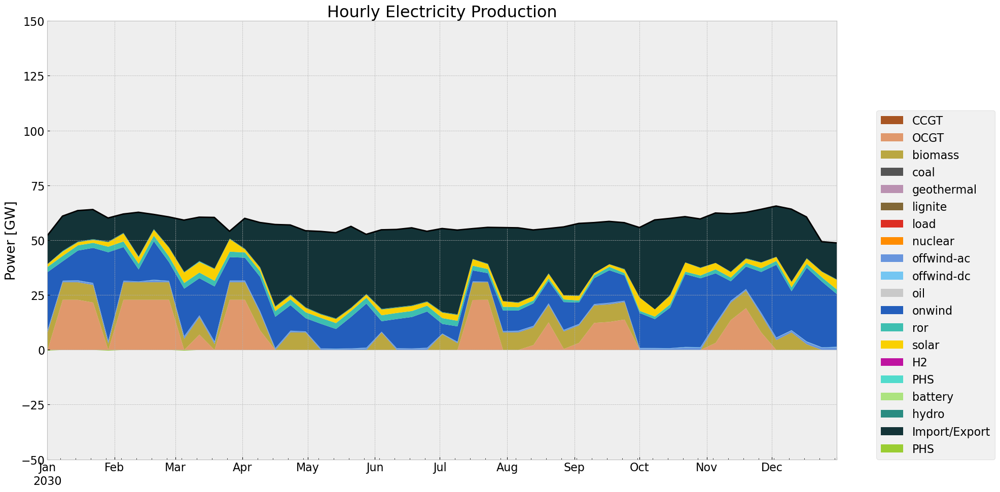

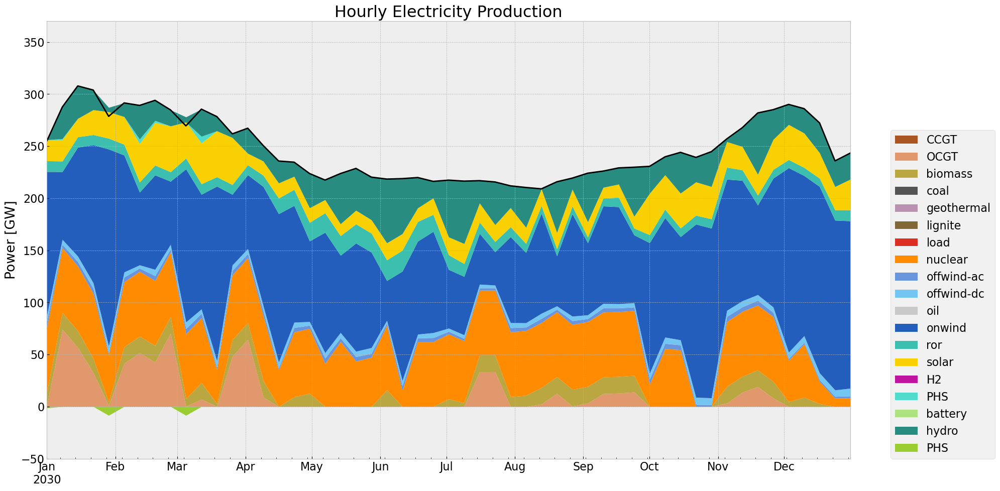

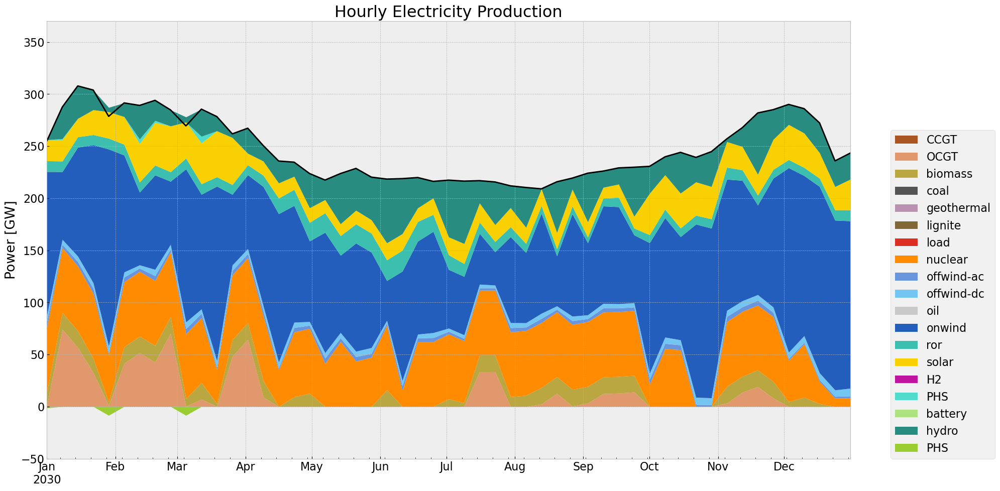

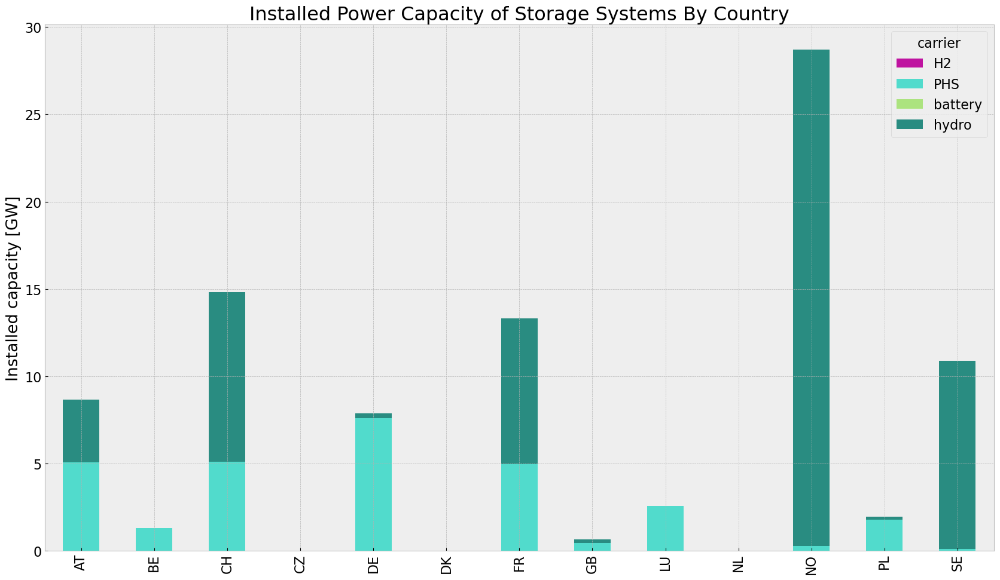

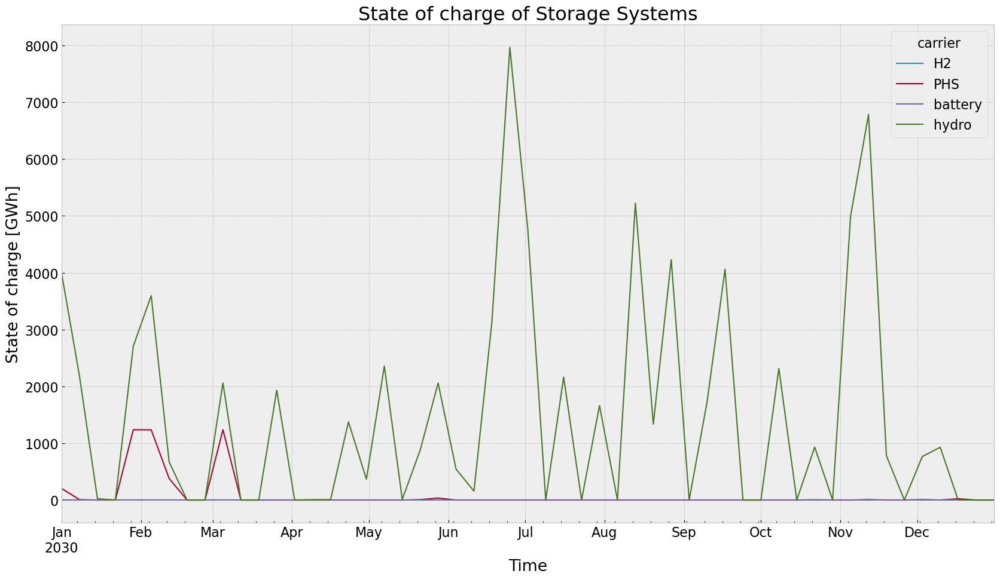

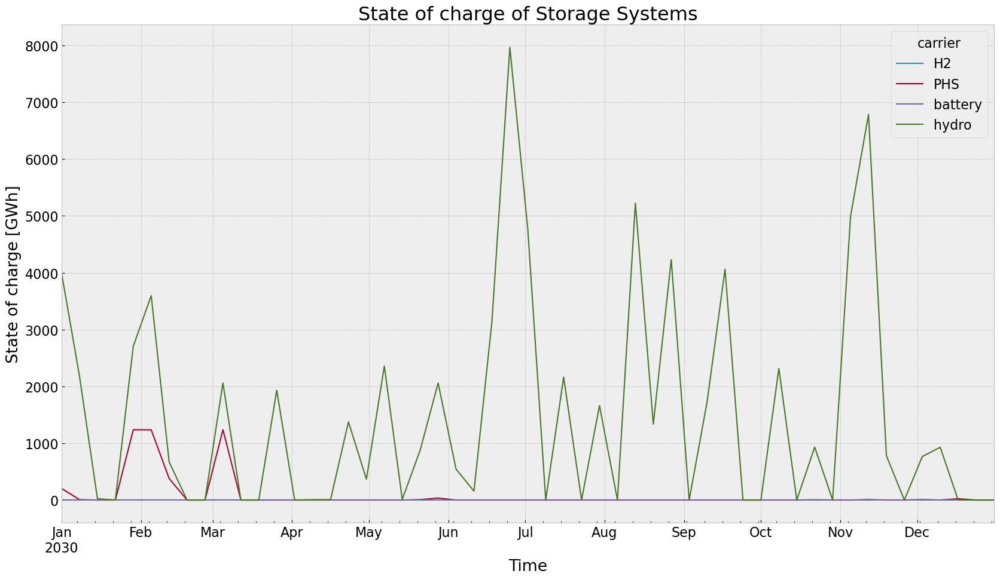

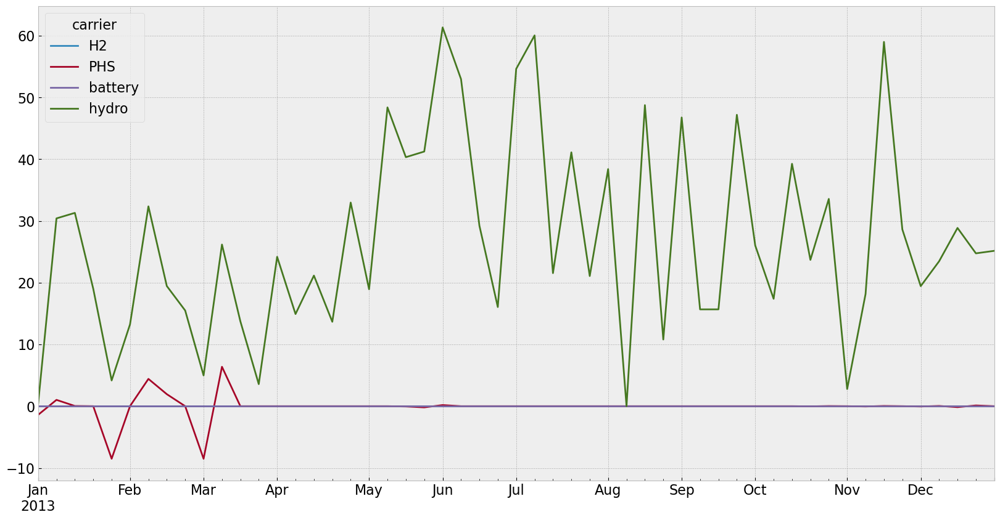

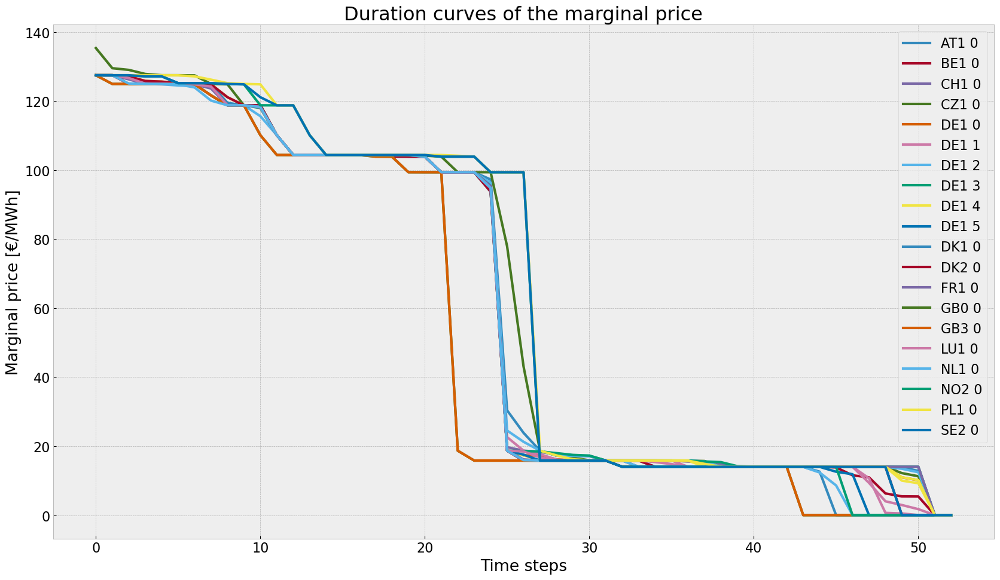

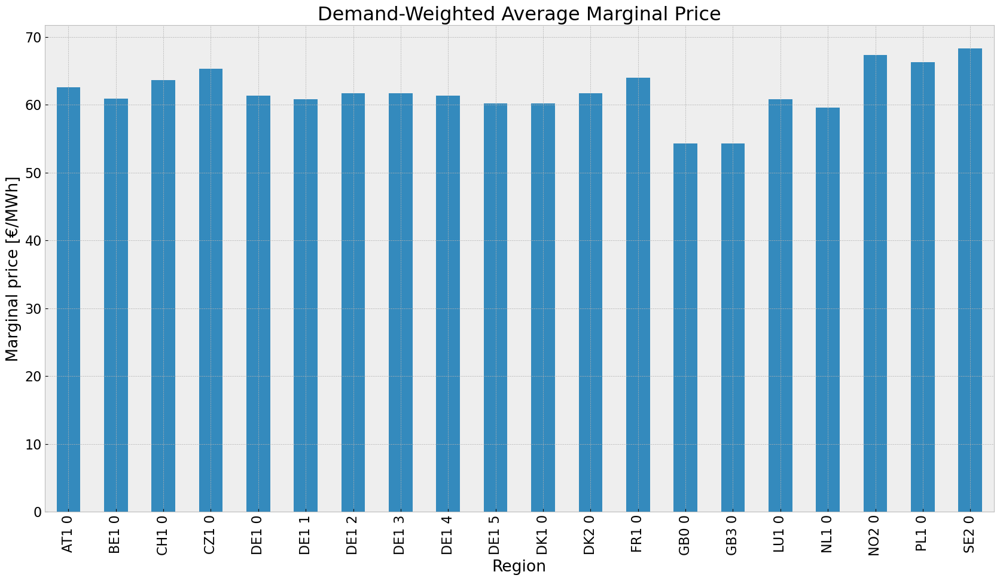

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


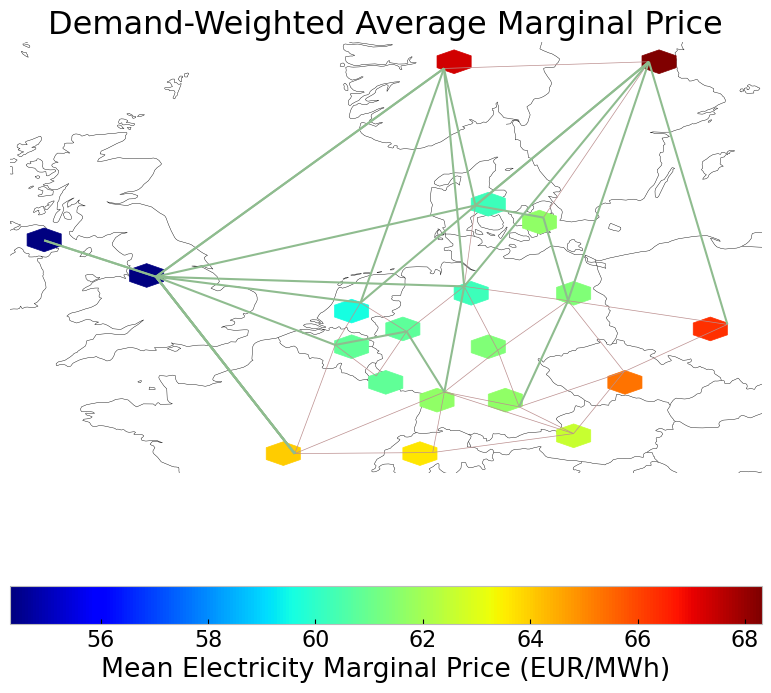

In [94]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [95]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

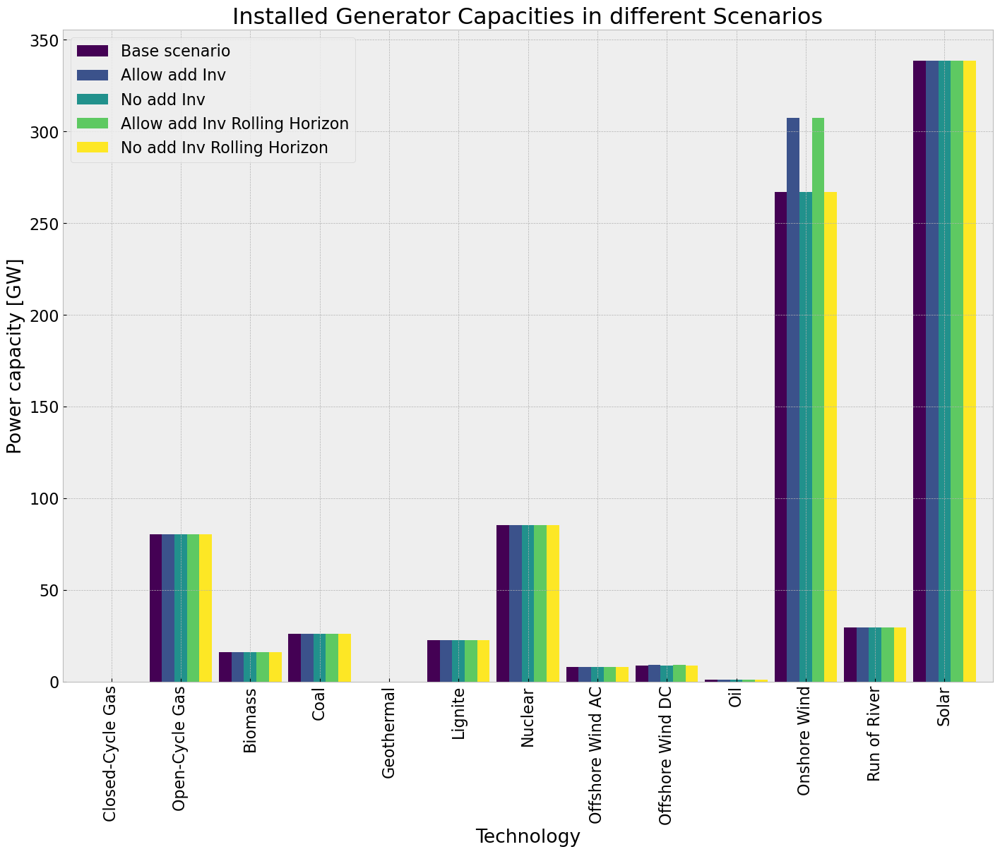

In [96]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'oil': '#c9c9c9', 'CCGT': '#a85522', 'solar': '#f9d002', 'geothermal': '#ba91b1', 'coal': '#545454', 'offwind-ac': '#6895dd', 'onwind': '#235ebc', 'OCGT': '#e0986c', 'nuclear': '#ff8c00', 'lignite': '#826837', 'offwind-dc': '#74c6f2', 'biomass': '#baa741', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


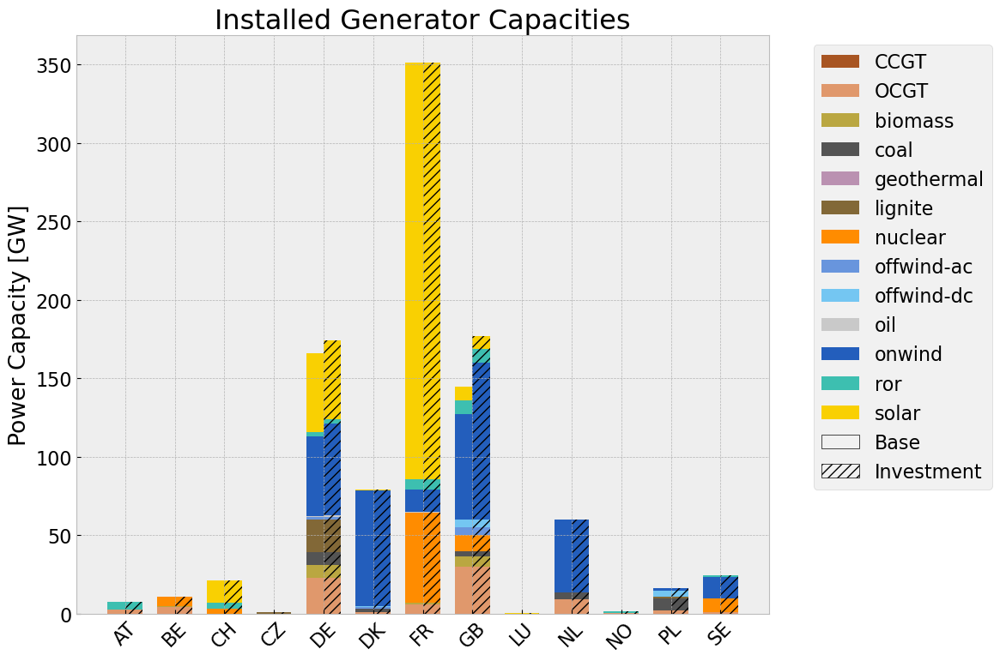

In [97]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\2988850123.py:34: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  comp_gen_electr.fillna(0, inplace=True)


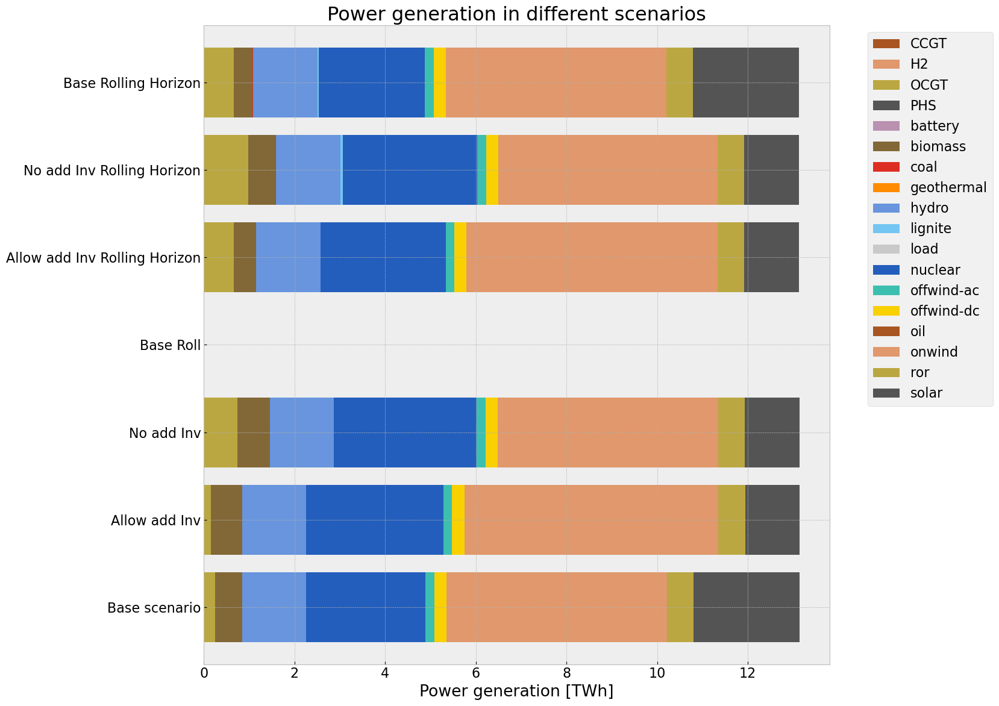

In [98]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Roll","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

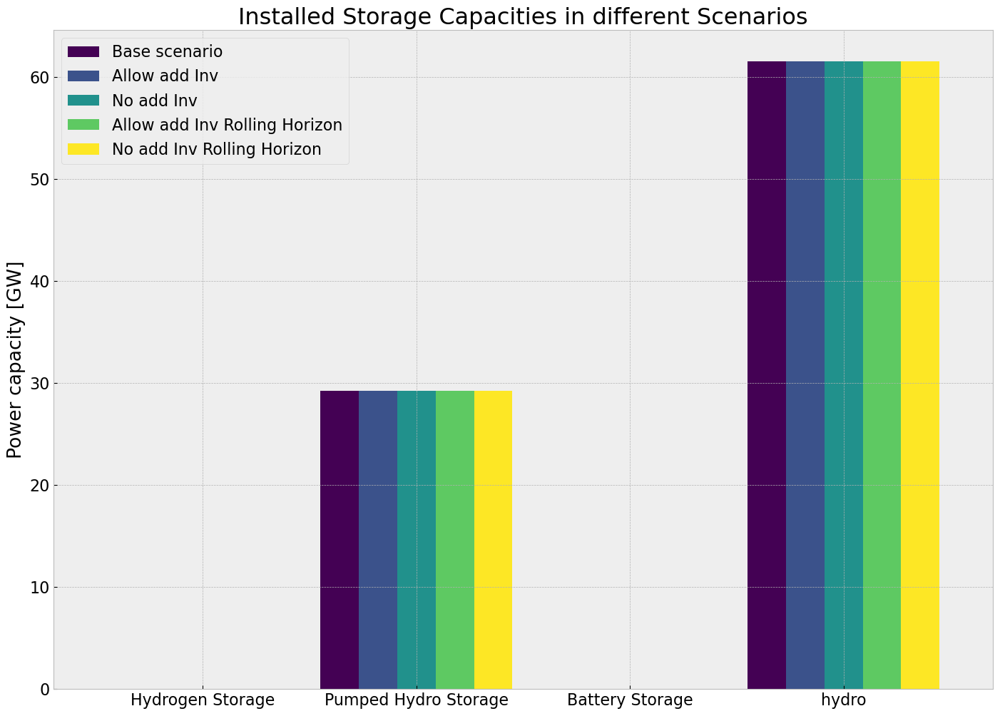

In [99]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

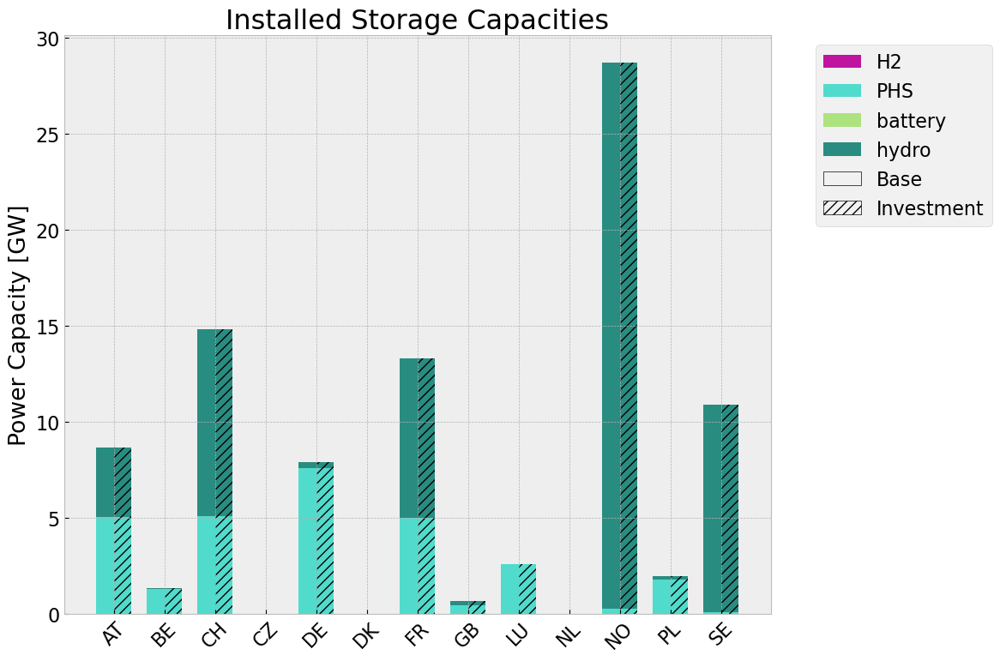

In [100]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [101]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


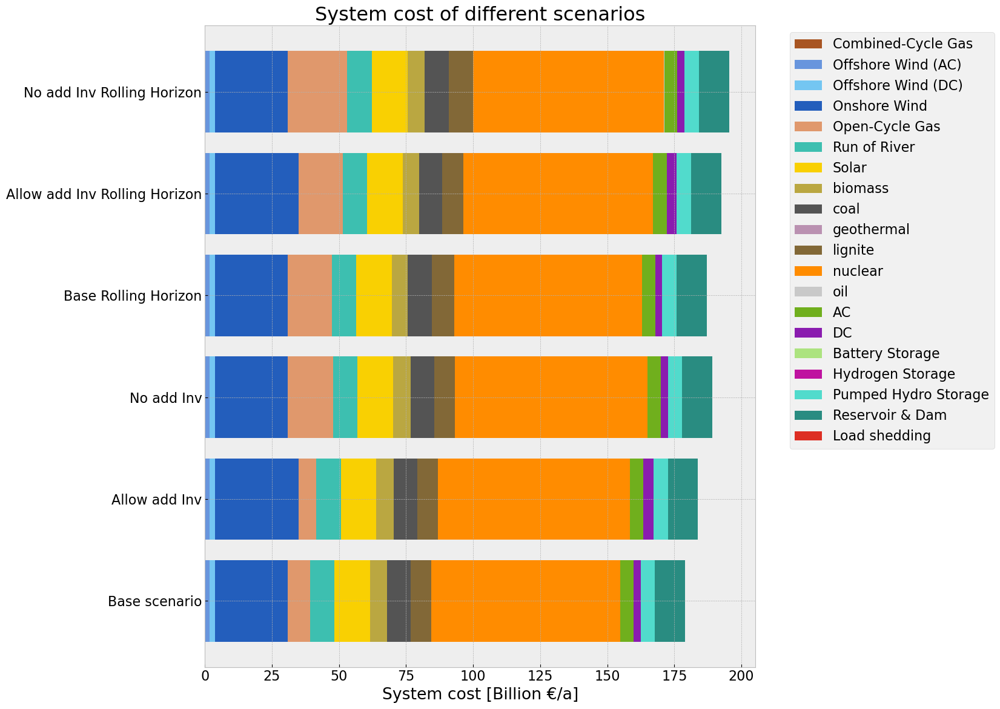

In [102]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [103]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [104]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


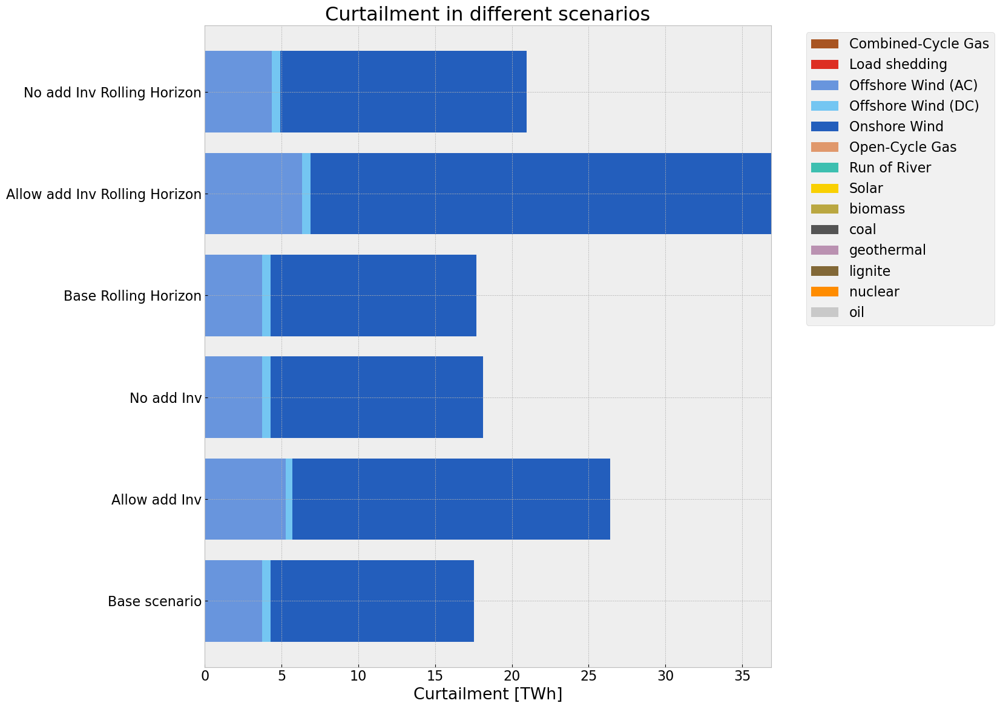

In [105]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_12608\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


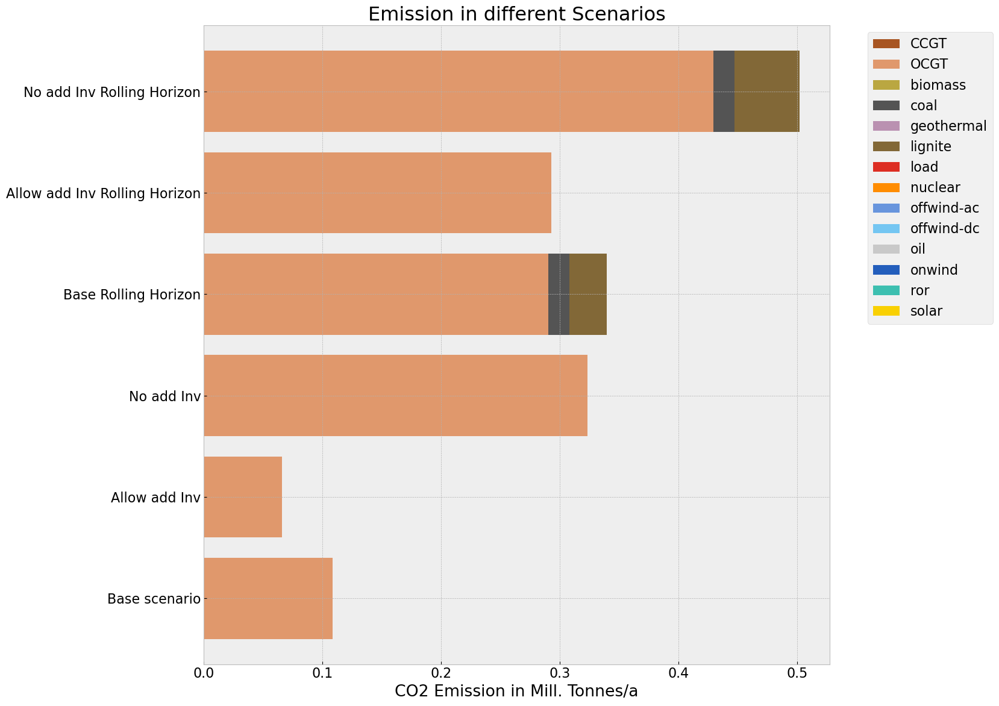

In [106]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [107]:
models = [n, n1, n2, n4]

In [108]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

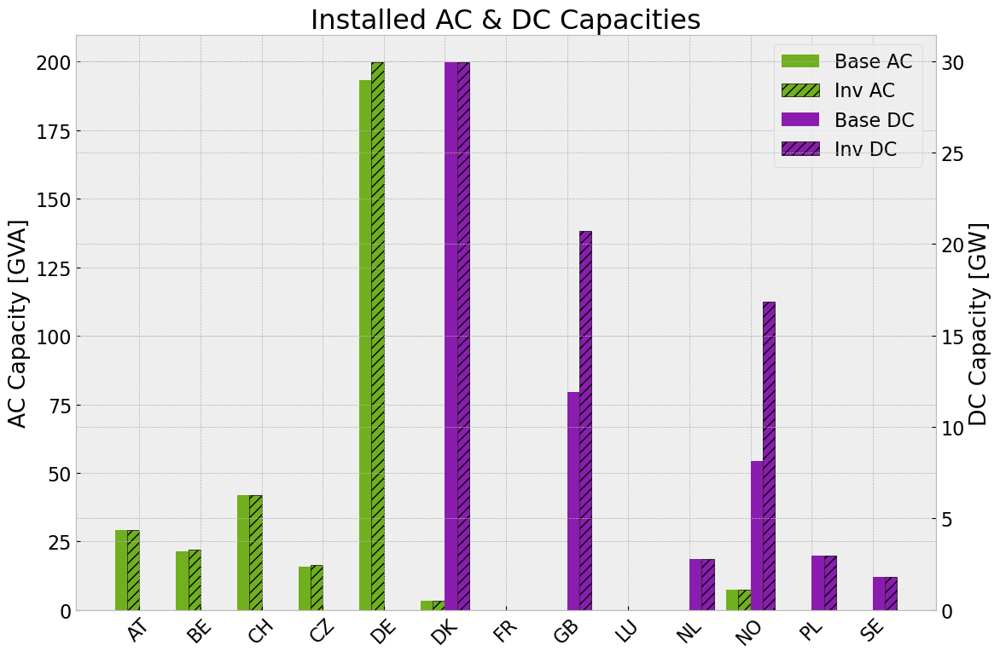

In [109]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [110]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 1,BE1 0: 14801, p_nom_opt: 0.0, 0.0
DK2 0,DE1 4: 14824, p_nom_opt: 18116.99304687361, 18116.9930469
SE2 0,DE1 5: 5601, p_nom_opt: 1249.4826412929, 1249.48264129
DE1 5,NO2 0: 14848, p_nom_opt: 0.0, 0.0
DE1 4,DE1 2: T10, p_nom_opt: 0.0, 0.0
SE2 0,DE1 4: T16, p_nom_opt: 0.0, 0.0
DE1 5,DE1 3: T18, p_nom_opt: 0.0, 0.0
DE1 1,DE1 3: T20, p_nom_opt: 0.0, 0.0
GB0 0,DE1 5: T22, p_nom_opt: 0.0, 0.0


In [111]:
n1.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_extendable,p_nom_min,p_nom_max,build_year,marginal_cost,min_up_time,min_down_time,up_time_before,down_time_before,p_nom_opt,reversed,type,efficiency,lifetime,p_nom_mod,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14801,DE1 1,BE1 0,DC,"LINESTRING(6.43068069229957 50.8136946409214,6...",239.848593,0.0,,True,False,-1.0,0.000000,25854.398714,True,0.000000,30000.0,0,0.009745,0,0,1,0,0.000000,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
14814,GB0 0,NL1 0,DC,"LINESTRING(4.04528166772434 51.9611233898246,2...",645.936772,1000.0,,False,False,-1.0,0.352490,51412.795403,True,1117.111234,31000.0,0,0.010714,0,0,1,0,1399.215427,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14826,GB0 0,FR1 0,DC,"LINESTRING(1.75051314494826 50.9186901861196,1...",1013.198189,2000.0,,False,False,-1.0,0.049244,60275.254416,True,6268.596086,32000.0,0,0.009053,0,0,1,0,6268.596086,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14805,DK2 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",205.403041,600.0,,False,True,-1.0,0.134963,25432.524245,True,11795.557715,30600.0,0,0.010840,0,0,1,0,11795.557715,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
14824,DK2 0,DE1 4,DC,"LINESTRING(11.9669051857726 55.421747727341,12...",432.140281,600.0,,False,False,-1.0,0.163988,36579.446436,True,18116.993047,30600.0,0,0.010362,0,0,1,0,18116.993047,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
5601,SE2 0,DE1 5,DC,"LINESTRING(12.9299984288384 55.0630403498842,1...",1257.572542,600.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32550"", ""...",False,False,-1.0,0.029686,70092.252666,True,1249.482641,30600.0,0,0.010808,0,0,1,0,1249.482641,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,SE
14823,PL1 0,SE2 0,DC,"LINESTRING(16.861267 54.533833,16.274872 55.09...",1362.362308,600.0,,False,False,-1.0,0.157706,81109.224571,True,2962.731209,30600.0,0,0.010215,0,0,1,0,2962.731209,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,PL
14803,NL1 0,DK1 0,DC,"LINESTRING(6.75668661933496 53.437616158174,6....",604.737909,0.0,,True,False,-1.0,0.426199,50794.620717,True,1417.485997,30000.0,0,0.010624,0,0,1,0,1417.485997,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL
14821,NL1 0,NO2 0,DC,"LINESTRING(6.83036734046461 53.4374933986115,6...",1221.169700,700.0,,False,False,-1.0,0.446703,87427.969265,True,1385.424469,30700.0,0,0.009671,0,0,1,0,1385.424469,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL


# Sensitivity Analysis

In [293]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [294]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [295]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_5_90_inv


INFO:pypsa.io:Imported network n_0_5_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_90_inv_roll


INFO:pypsa.io:Imported network n_0_5_90_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_90_noinv


INFO:pypsa.io:Imported network n_0_5_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_noinv_roll


INFO:pypsa.io:Imported network n_0_5_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_inv


INFO:pypsa.io:Imported network n_0_5_180_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_180_inv_roll


INFO:pypsa.io:Imported network n_0_5_180_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_180_noinv


INFO:pypsa.io:Imported network n_0_5_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_noinv_roll


INFO:pypsa.io:Imported network n_0_5_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_inv


INFO:pypsa.io:Imported network n_0_5_270_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_270_inv_roll


INFO:pypsa.io:Imported network n_0_5_270_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_270_noinv


INFO:pypsa.io:Imported network n_0_5_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_noinv_roll


INFO:pypsa.io:Imported network n_0_5_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_inv


INFO:pypsa.io:Imported network n_0_25_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_90_inv_roll


INFO:pypsa.io:Imported network n_0_25_90_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_90_noinv


INFO:pypsa.io:Imported network n_0_25_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_noinv_roll


INFO:pypsa.io:Imported network n_0_25_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_inv


INFO:pypsa.io:Imported network n_0_25_270_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_270_inv_roll


INFO:pypsa.io:Imported network n_0_25_270_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_25_270_noinv


INFO:pypsa.io:Imported network n_0_25_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_noinv_roll


INFO:pypsa.io:Imported network n_0_25_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_inv


INFO:pypsa.io:Imported network n_0_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_90_inv_roll


INFO:pypsa.io:Imported network n_0_90_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_90_noinv


INFO:pypsa.io:Imported network n_0_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_noinv_roll


INFO:pypsa.io:Imported network n_0_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_inv


INFO:pypsa.io:Imported network n_0_180_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_180_inv_roll


INFO:pypsa.io:Imported network n_0_180_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_180_noinv


INFO:pypsa.io:Imported network n_0_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_noinv_roll


INFO:pypsa.io:Imported network n_0_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_inv


INFO:pypsa.io:Imported network n_0_270_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_270_inv_roll


INFO:pypsa.io:Imported network n_0_270_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_270_noinv


INFO:pypsa.io:Imported network n_0_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_noinv_roll


INFO:pypsa.io:Imported network n_0_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [296]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [297]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [298]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

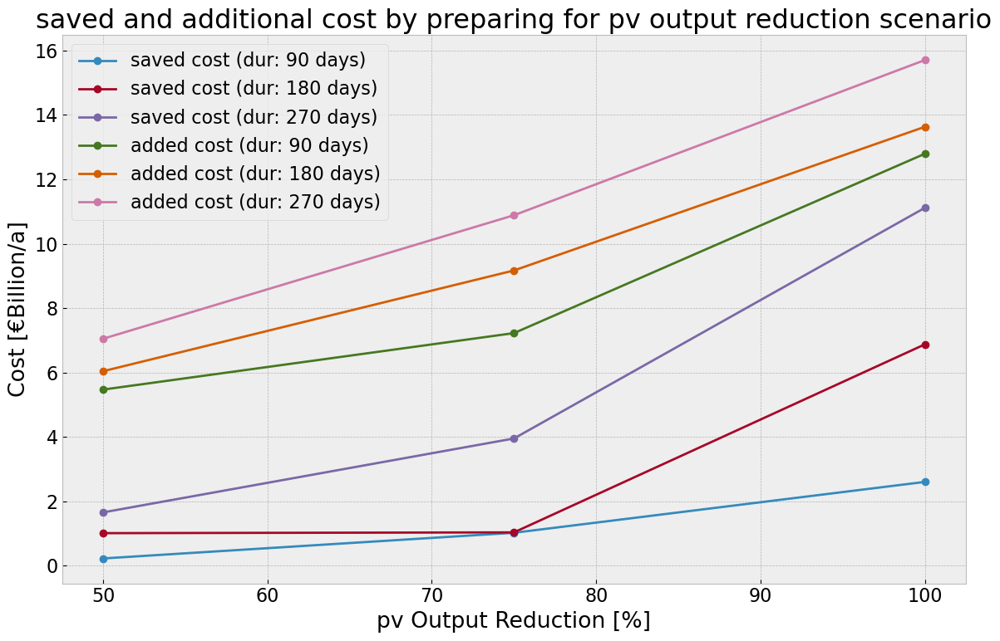

In [299]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [300]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [301]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [302]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '22.8885365' has dtype incompatible with 

In [303]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'OCGT': 0, 'offwind': 1, 'solar': 2, 'onwind': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

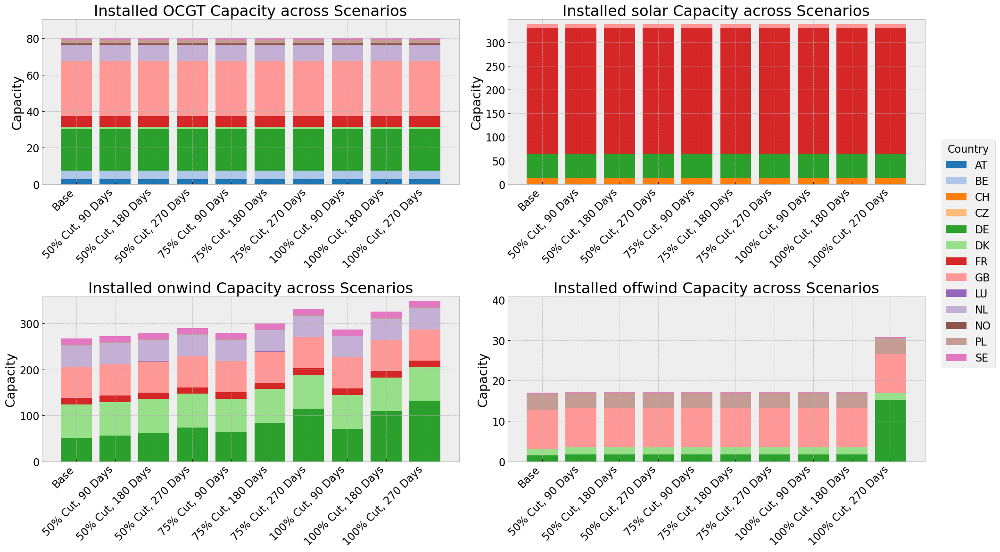

In [304]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [305]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly cast

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

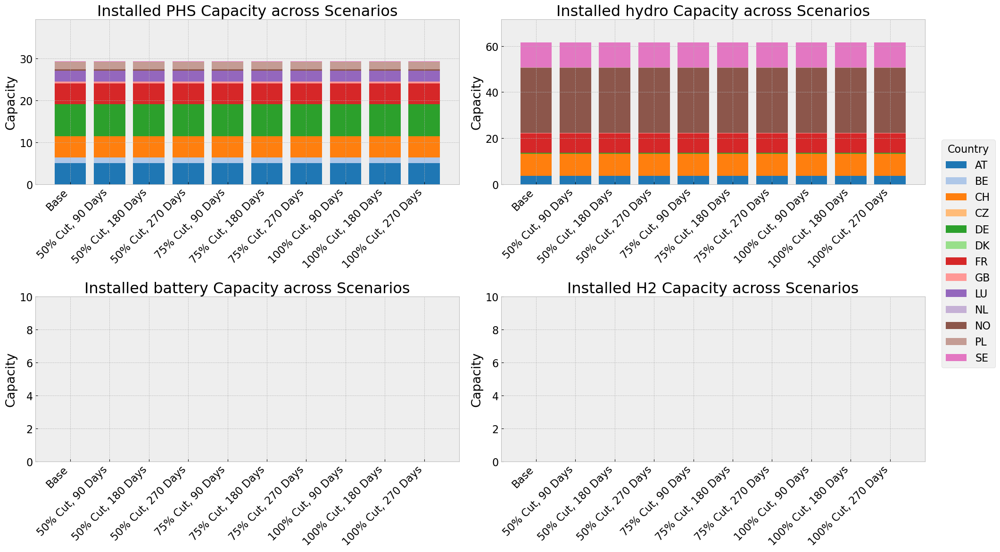

In [306]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [307]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '29.022506910057025' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '21.365814189857804' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '41.77435568306778' has dtype incompat

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


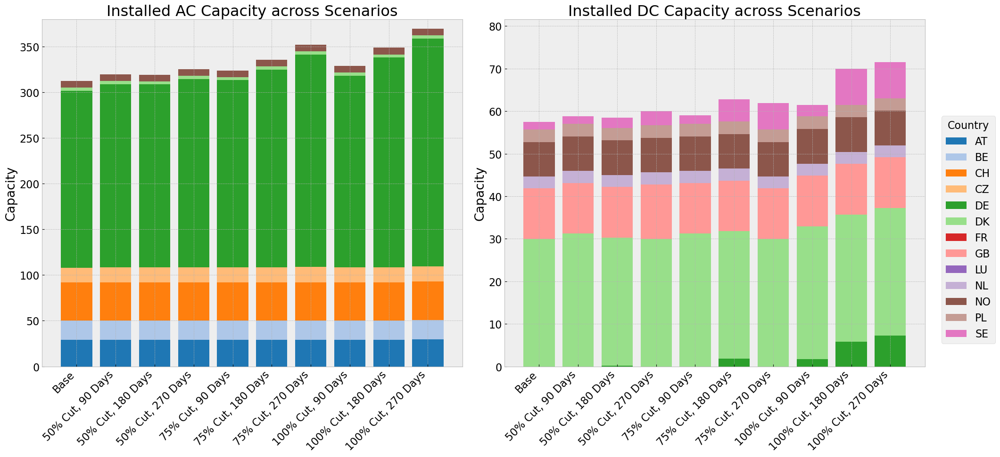

In [308]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()